In [110]:
import glob
import astropy
import importlib
import math
import numpy as np
import xlwt
import xlsxwriter
import warnings
warnings.filterwarnings('ignore')

from xlwt import Workbook
from reduct_funcs import funcs_calib_and_plot
from reduct_funcs import funcs_star_finder
from reduct_funcs import funcs_apt_phot
from reduct_funcs import funcs_utils

importlib.reload(funcs_calib_and_plot)
importlib.reload(funcs_star_finder)
importlib.reload(funcs_apt_phot)
importlib.reload(funcs_utils)

<module 'reduct_funcs.funcs_utils' from 'D:\\space_stuff\\optical_polarimetry\\Suhora_polarimety\\reduct_funcs\\funcs_utils.py'>

In [2]:
#fp = 'C:/Users/afiq-Astro/Desktop/TSSP/reductions_4/files_sorted/2020-05-04'
#funcs_utils.make_dir(fp)

In [3]:
#Takes into consideration the pol flat
MJD = '2020-04-25'
pol_flat_MJD = 'moaf' #26 was the first flat thing
p_3 = 'P3-R'
p_1 = 'P1-R'
target_name='EE_Cep'

bias = glob.glob('./files_sorted/'+MJD+'/bias/*')
dark = glob.glob('./files_sorted/'+MJD+'/dark/*')
p_1_pol_std_flat = glob.glob('./files_sorted/pol_flats/'+pol_flat_MJD+'/'+p_1 +'/*')
p_3_pol_std_flat = glob.glob('./files_sorted/pol_flats/'+pol_flat_MJD+'/'+p_3 +'/*')

target = glob.glob('./files_sorted/'+MJD+'/'+target_name+'/*')
pol_std = glob.glob('./files_sorted/'+MJD+'/pol_std/*')

print("Bias:", str(len(bias))+".", 
      "Dark:", str(len(dark))+".", 
      "p_1 Flat:", str(len(p_1_pol_std_flat))+".",
      "p_3 Flat:", str(len(p_3_pol_std_flat))+".", 
      "Target:", str(len(target))+".", 
      "Polarization Standard:", str(len(pol_std))+".")

Bias: 3. Dark: 3. p_1 Flat: 2. p_3 Flat: 2. Target: 1. Polarization Standard: 3.


In [4]:
p_1_pol_std_flat

['./files_sorted/pol_flats/moaf/P1-R\\flatp1-r2s0001.fits',
 './files_sorted/pol_flats/moaf/P1-R\\flatp1-r2s0002.fits']

In [5]:
p_3_pol_std_flat

['./files_sorted/pol_flats/moaf/P3-R\\flatp3-r3s0001.fits',
 './files_sorted/pol_flats/moaf/P3-R\\flatp3-r3s0002.fits']

In [6]:
funcs_calib_and_plot.file_splits(bias)

Img type: ['zero'] Obj: ['bias'] Filters: [('SU', 2), ('N-B', 1)] 


In [7]:
funcs_calib_and_plot.file_splits(bias)
funcs_calib_and_plot.file_splits(dark)
funcs_calib_and_plot.file_splits(p_1_pol_std_flat)
funcs_calib_and_plot.file_splits(p_3_pol_std_flat)
funcs_calib_and_plot.file_splits(target)
funcs_calib_and_plot.file_splits(pol_std)

Img type: ['zero'] Obj: ['bias'] Filters: [('SU', 2), ('N-B', 1)] 
Img type: ['dark'] Obj: ['dark'] Filters: [('SU', 2), ('N-B', 1)] 
Img type: ['flat'] Obj: ['flat'] Filters: [('P1-R', 2)] 
Img type: ['flat'] Obj: ['flat'] Filters: [('P3-R', 2)] 
Img type: ['object'] Obj: ['EE Cep'] Filters: [('P1-R', 1)] 
Total 0.0 min exposure time
Img type: ['object'] Obj: ['HD215806', 'G191B2B', 'oj287'] Filters: [('P3-R', 1), ('P1-R', 2)] 
Total 2.0 min exposure time


In [8]:
bias

['./files_sorted/2020-04-25/bias\\biasn-b0s0006.fits',
 './files_sorted/2020-04-25/bias\\biassu0s0017.fits',
 './files_sorted/2020-04-25/bias\\biassu0s0018.fits']

In [9]:
#m_biast, m_dark, m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, flat) #unable to make 

m_biast, m_dark, p_1_m_flat, p_3_m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, p_1_pol_std_flat, p_3_pol_std_flat)
#m_biast, m_dark, p_3_m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, p_3_pol_std_flat)

#Where do the R bands start?

In [10]:
funcs_utils.print_list(MJD, target)

2020-04-25
0 02:22:55.99 P1-R 20.0 EE Cep


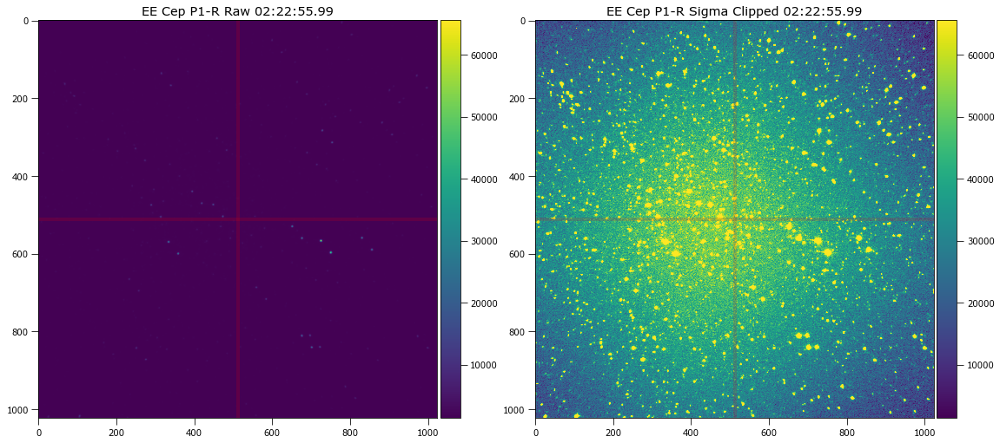

In [11]:
funcs_calib_and_plot.plot_raw_double_compare(target[0], [512, 512, 512, 512], ['Raw', 'Sigma Clipped'], sv_img = False)

In [12]:
op = astropy.io.fits.open(pol_std[2])[0].data

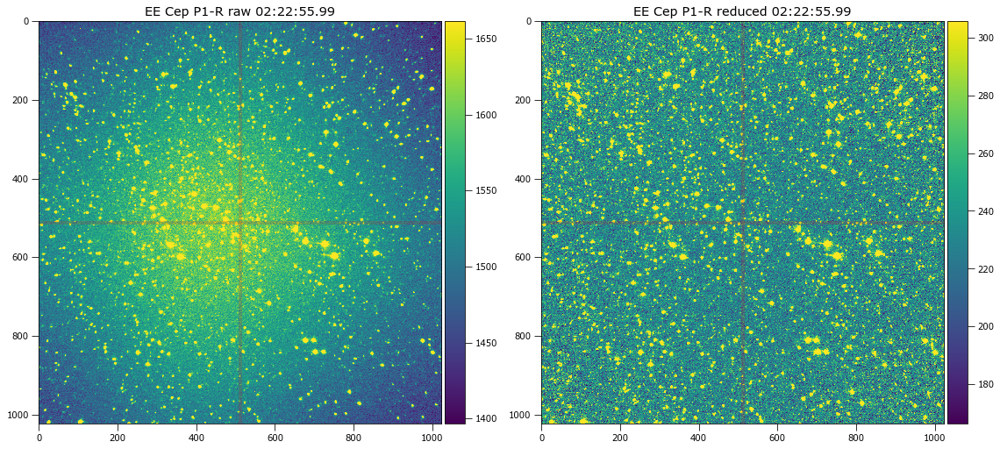

In [13]:
reduced_img = funcs_calib_and_plot.plot_double_raw_v_reduced(target[0],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [512, 512, 512, 512], 
                                    sigma=True, plot=True, sv_img=False) 

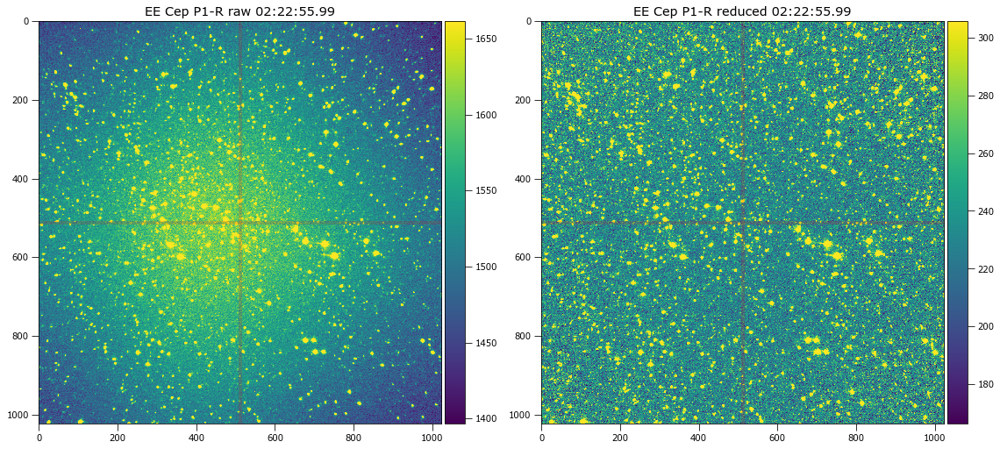

In [14]:
reduced_img = funcs_calib_and_plot.plot_double_raw_v_reduced(target[0],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [512, 512, 512, 512], 
                                    sigma=True, plot=True, sv_img=False) 

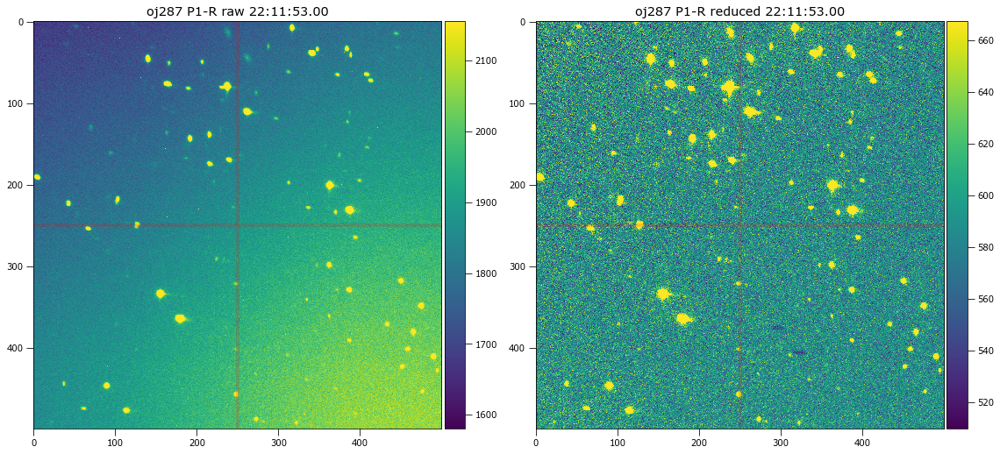

In [15]:
reduced_img = funcs_calib_and_plot.plot_double_raw_v_reduced(pol_std[2],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [250, 250, 250, 250], 
                                    sigma=True, plot=True, sv_img=False) 

In [16]:
#Question, what else is a zero polarization standard star
#607-504
#zeroeing is important

#51 to 102

#Ok. New Procedure. For Each time you run the pipe. Look at all your targets

#Its dope that you are astronomer enough to notice that they are upside down. I recognize these stars!

#Write your loops as you need them

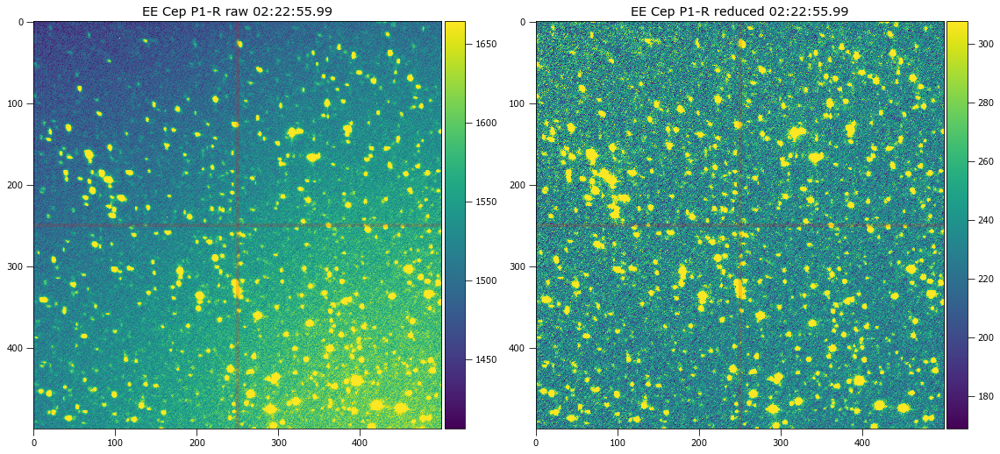

In [21]:
reduced_img = funcs_calib_and_plot.plot_double_raw_v_reduced(target[0],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [250, 250, 250, 250], 
                                    sigma=True, plot=True, sv_img=False) 

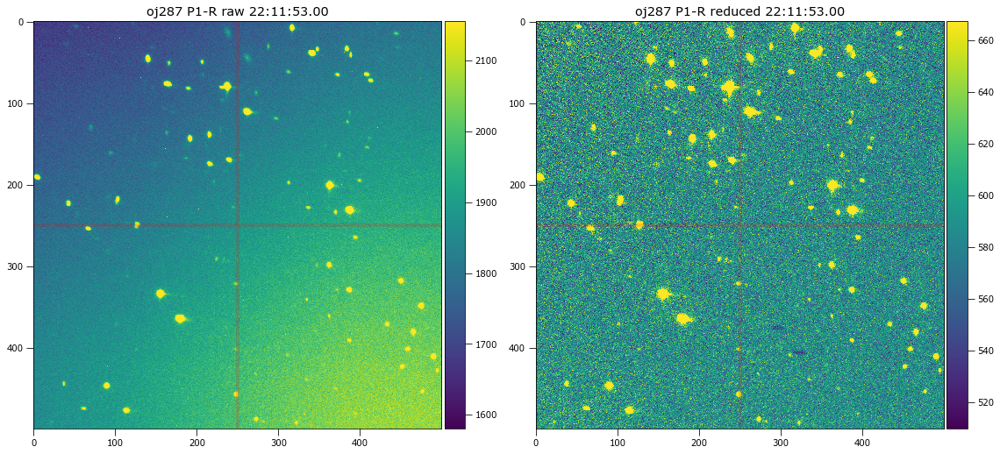

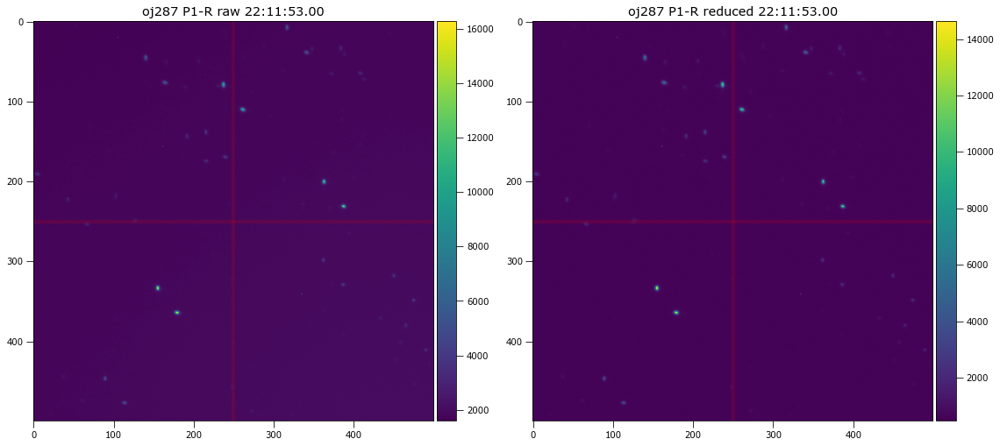

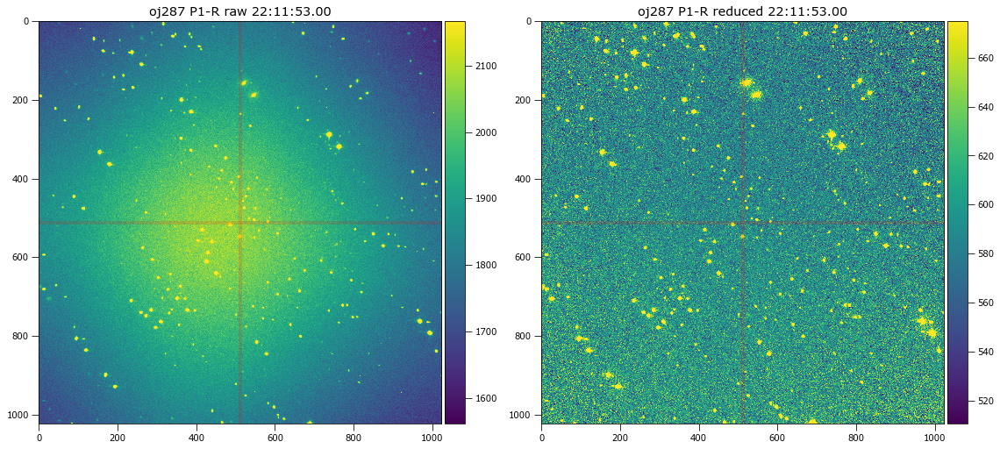

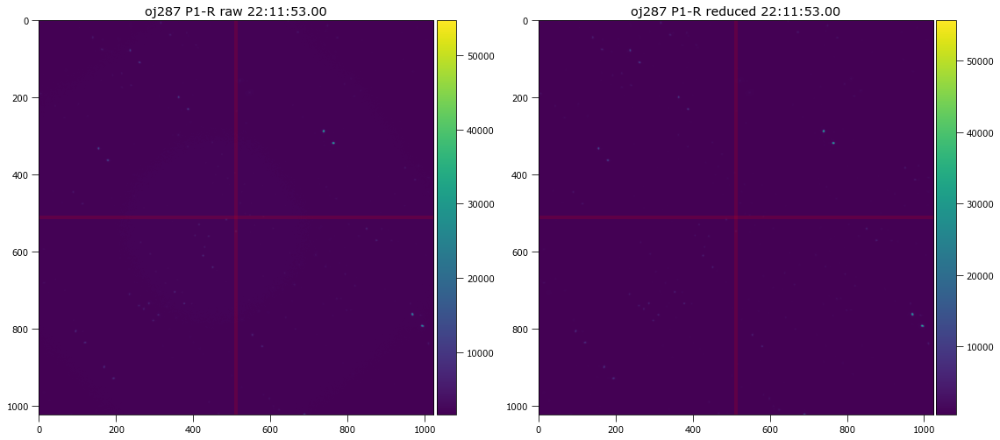

In [18]:
#If target not detected by DAO, use the location of the peak finder...
#your pipeline is macklunky. but it works
target_n=242

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(pol_std[2],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [250, 250, 250, 250], 
                                    sigma=True, plot=True, sv_img=False) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(pol_std[2],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [250, 250, 250, 250], 
                                    sigma=False, plot=True, sv_img=False) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(pol_std[2],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [512, 512, 512, 512], 
                                    sigma=True, plot=True, sv_img=False) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(pol_std[2],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [512, 512, 512, 512], 
                                    sigma=False, plot=True, sv_img=False) 

#I want that gradient to disappear

In [80]:
####################################################################################
#Everything above here is validated

In [67]:
#print(x_targ, y_targ, peak_targ)

In [30]:
#I'm looking at the pol std star through a p1 - r filter

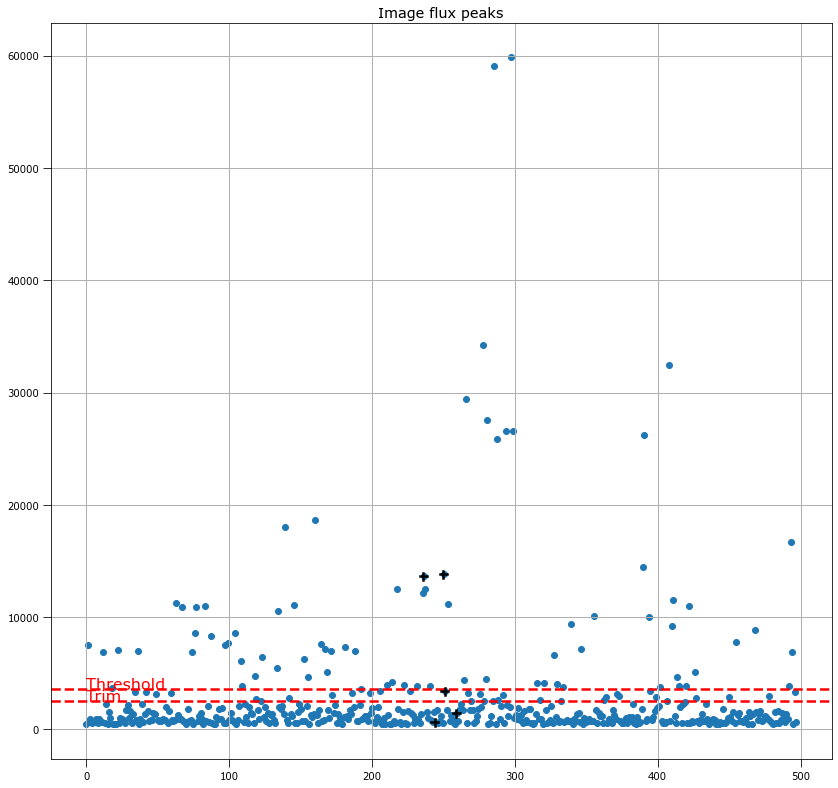

497 peaks detected from image of size HEADER NAXIS1 x NAXIS2 with sigma: 3 and threshold: 3564.42955555532 valid
Targets within region of interest:  2


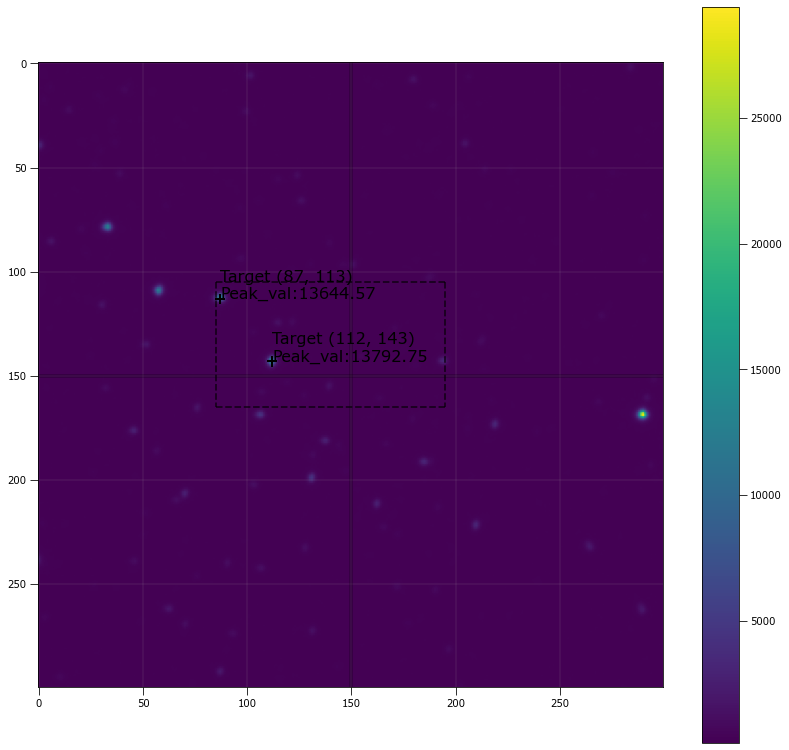

In [66]:
search_off = 150
siegma_search = 3
search_bracket = [45, 15, 65, 45]
x_targ, y_targ, peak_targ = funcs_star_finder.source_peak_finder(reduced_img, 3, search_bracket, 2500, True, True) #what do I return from this?
apt_pos = funcs_star_finder.plot_spotted(reduced_img, search_off, search_bracket,x_targ, y_targ, peak_targ, plot_im=True)

apt_positions = []
for h in range(0 , len(x_targ)):
    apt_positions.append((x_targ[h], y_targ[h])) #This must undergo some translation    
    
#print("Aperture positions are:", apt_positions, "from the", reduced_obj[0].header['NAXIS1'], "x", reduced_obj[0].header['NAXIS2'], "image")
#print("Aperture positions are:", apt_pos, "from the", str(search_off), "x", str(search_off) ,"image")

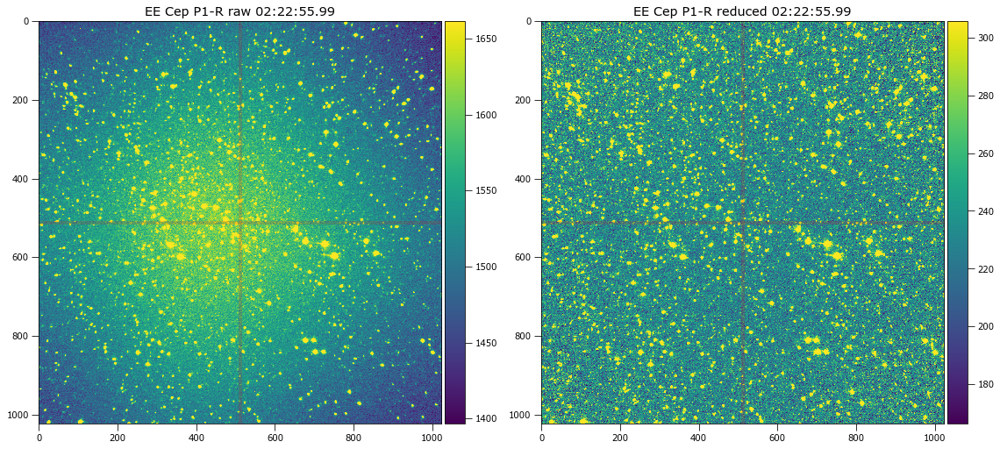

In [91]:
#Test
search_off = 150
siegma_search = 3
search_bracket = [45, 15, 65, 45]

reduced_img = funcs_calib_and_plot.plot_double_raw_v_reduced(target[0],
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    [512, 512, 512, 512], 
                                    sigma=True, plot=True, sv_img=False) 

trial_radii = np.linspace(5, 9.45, num=60)
target_a = []
target_b = []

#for radii in trial_radii:
for z in range(0, len(trial_radii)):
    DAO_positions = funcs_star_finder.dao_star_finder(reduced_img, 
                                                      search_bracket,
                                                      siegma_search, 
                                                      4000,
                                                      search_off,
                                                      trial_radii[z],
                                                      12 , 22,
                                                      plot=False, 
                                                      plot_tab=False)
        
    if (len(DAO_positions) != 2):
        x_targ, y_targ, peak_targ = funcs_star_finder.source_peak_finder(reduced_img, 3, search_bracket, 2500, True, True) #what do I return from this?
        apt_pos = funcs_star_finder.plot_spotted(reduced_img, search_off, search_bracket,x_targ, y_targ, peak_targ, plot_im=True)
        DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)     
    #    x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_img, 4,search_bracket, 3600 , False, False) #what do I return from this?
    #    apt_pos = funcs_star_finder.plot_spotted(reduced_img, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
   
        
    #Insert Trial
    #phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_img, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)

In [ ]:
#write an exception. If it cannot find anything. Then reduce the siegma. Or better yet just go for another set of coordinates

#1 and 4, 2 and 3

P1-R Filter


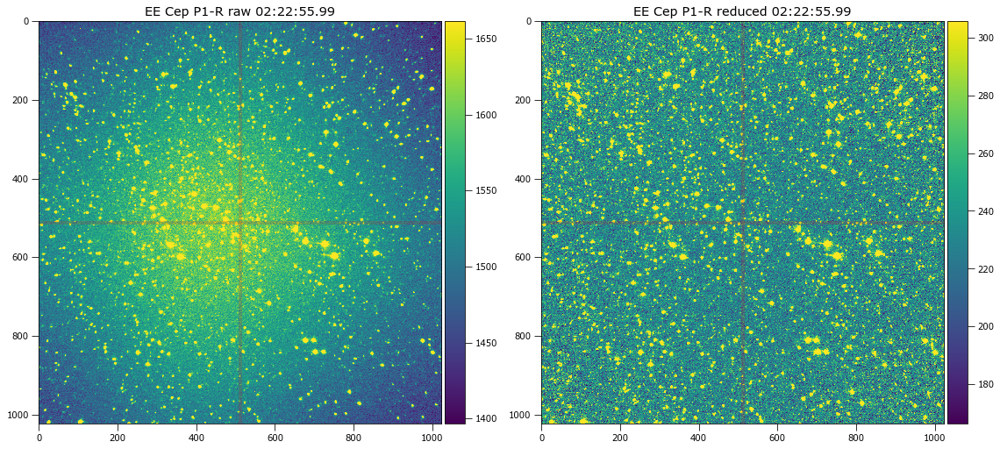

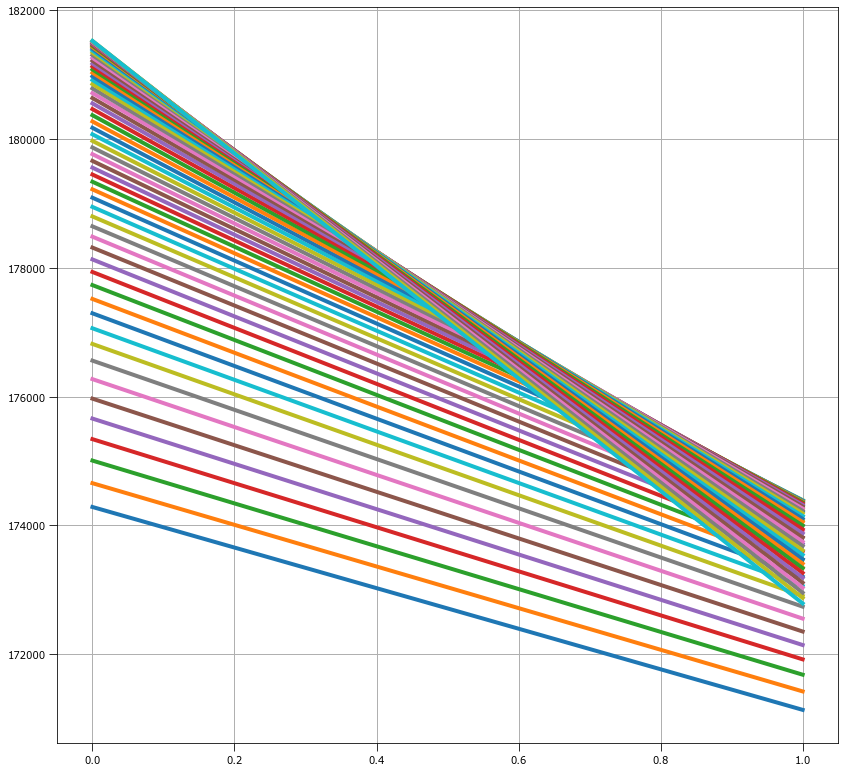

Target: 1 6.5838983050847455


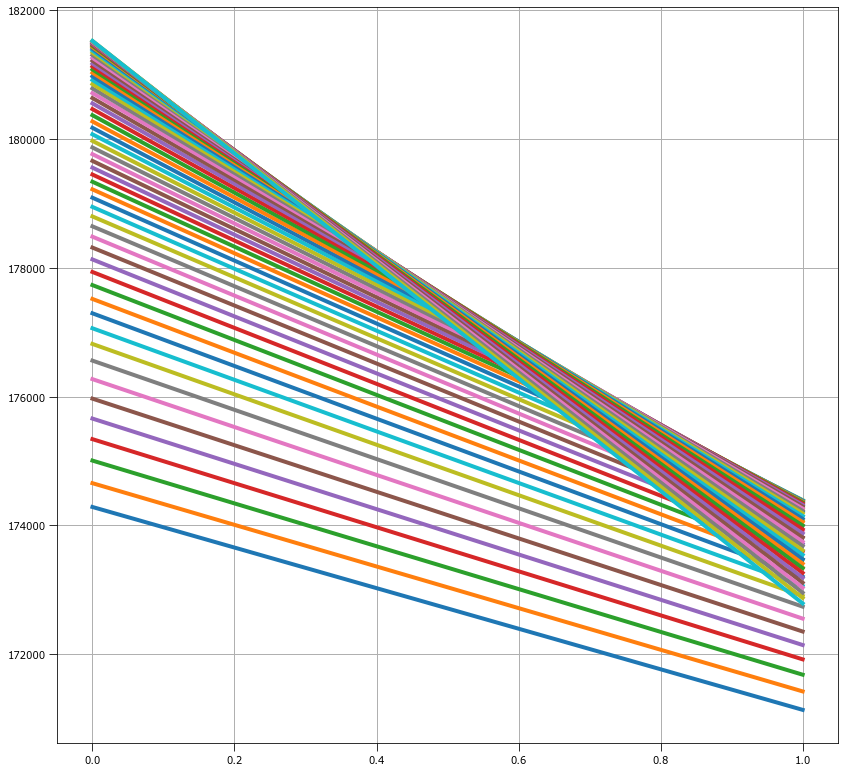

Target: 2 6.508474576271186
Median aperture radii: 6.546186440677966


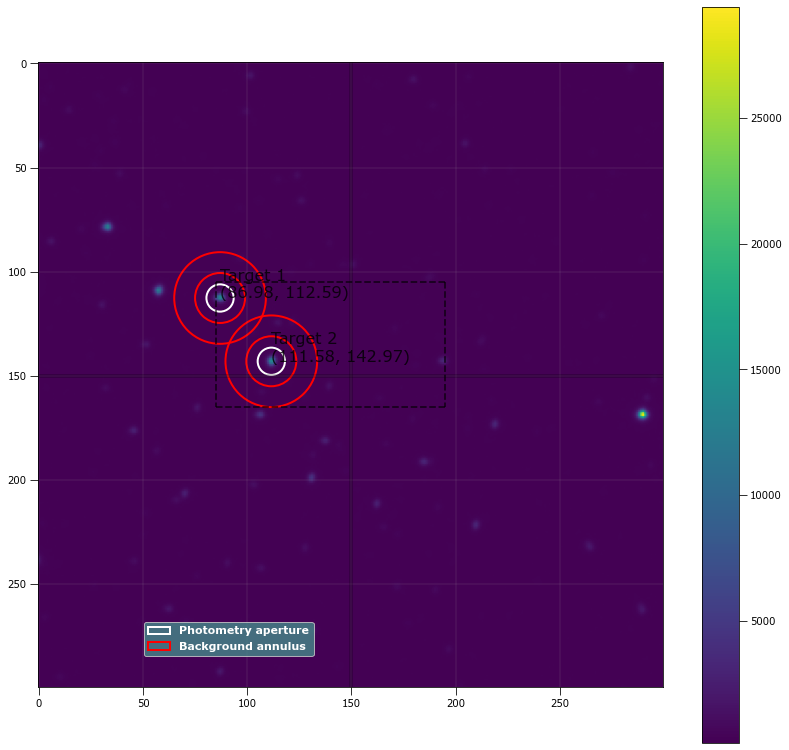

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  86.97651 112.59103 ...          3556.2841       258094.3          802.57713
  2 111.57855 142.96534 ...          3561.9319       285025.7          939.61911

 Aperture are: 134.62527799520868 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  86.97651 112.59103 ...                 3455.1297             179156.51
  2 111.57855 142.96534 ...                 3443.5052             174234.02

Write this out the excel
0 02:22:55.99 P1-R 20.0 6.546186440677966 86.97650993261053 112.59102662101503 179156.5139290375 3455.1297399960067 111

In [111]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P1-R Filter")

res_apt_sum_list = []

start = 0
end = 1
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [45, 15, 65, 45]

for k in range(start, end ):   
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(target[0],
                                        (m_biast, m_dark,  p_1_m_flat),
                                        [512, 512, 512, 512], 
                                        sigma=True, plot=True, sv_img=False)

    trial_radii = np.linspace(5, 9.45, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:        
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj,
                                                          search_bracket,
                                                          siegma_search,   
                                                          3000, search_off, 
                                                          radii, 12 , 
                                                          22, 
                                                          False, False)
        
        if (len(DAO_positions) != 2):
            #Just incase you dont find any... try again with the source peak find. What if source peak finder doesnt find anything either...
            x_targ, y_targ, peak_targ = funcs_star_finder.source_peak_finder(reduced_img, search_bracket,3, 3600 , plot_peaks=False, verbose=False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_bracket, x_targ, y_targ, peak_targ, search_off, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_img,  DAO_positions, search_bracket, search_off,  radii, 12 , 22, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]

    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, True)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, DAO_positions, search_bracket, search_off,  good_radii, 12 , 22, True)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]]
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close() #if file doesnt exist. Create one.

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])

In [8]:
#You have two options. Write code that fixes the image or

#here is something fun to write.

#write a function that takes two input script 

#and merges them together to become one.

#You have to do a manual Fit before you do a physical fit.
#Now I am seeing a case where with the threshold lowered, long compute time I am picking up unwanted background sources
#I'm looking at the example from P1-R
#Target_1

#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

P3-R Filter


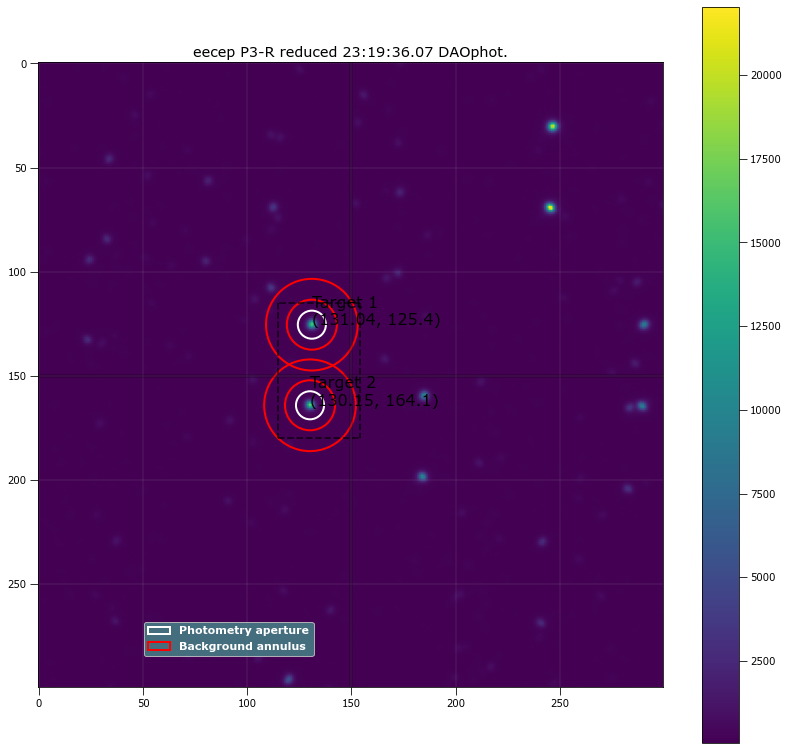

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.03963 125.40228 ...          4349.5276       143481.5          468.36972
  2 130.15065 164.09722 ...          4337.7425      144047.48          468.99834

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.03963 125.40228 ...                 4287.0459             238807.36
  2 130.15065 164.09722 ...                  4275.177             229612.82

Write this out the excel
291 23:19:36.07 P3-R 20.0 6.734745762711864 131.03962838668235 125.4022838279877 238807.3552153266 4287.045948074095 130

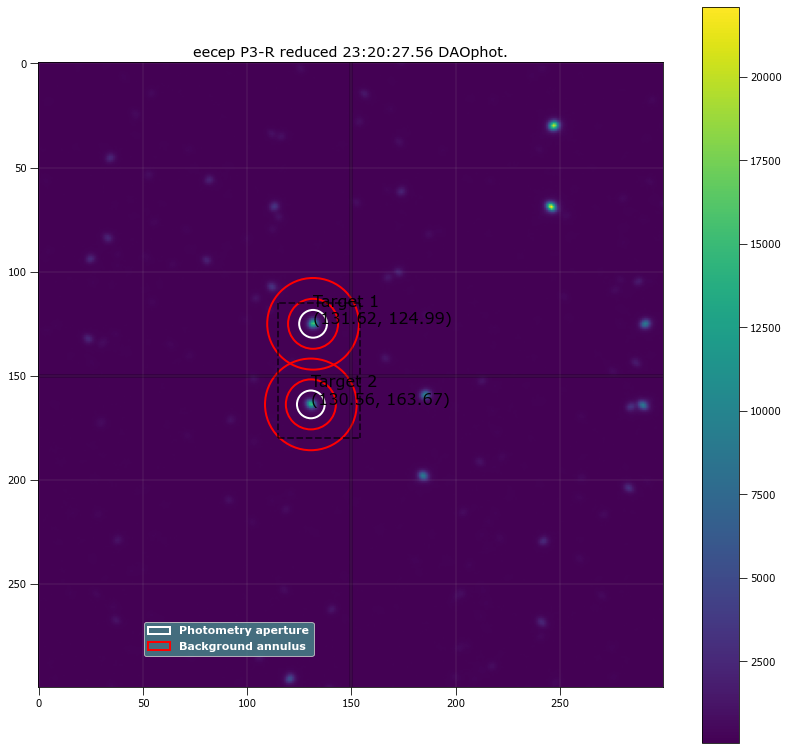

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.61567 124.98554 ...          4275.6413      143387.72          465.06953
  2 130.55729 163.66848 ...           4136.847      143121.96          464.71136

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.61567 124.98554 ...                 4214.9818             238301.49
  2 130.55729 163.66848 ...                 4076.2342             230850.09

Write this out the excel
292 23:20:27.56 P3-R 20.0 6.659322033898304 131.6156736336764 124.98554413994549 238301.49180336256 4214.981788761756 1

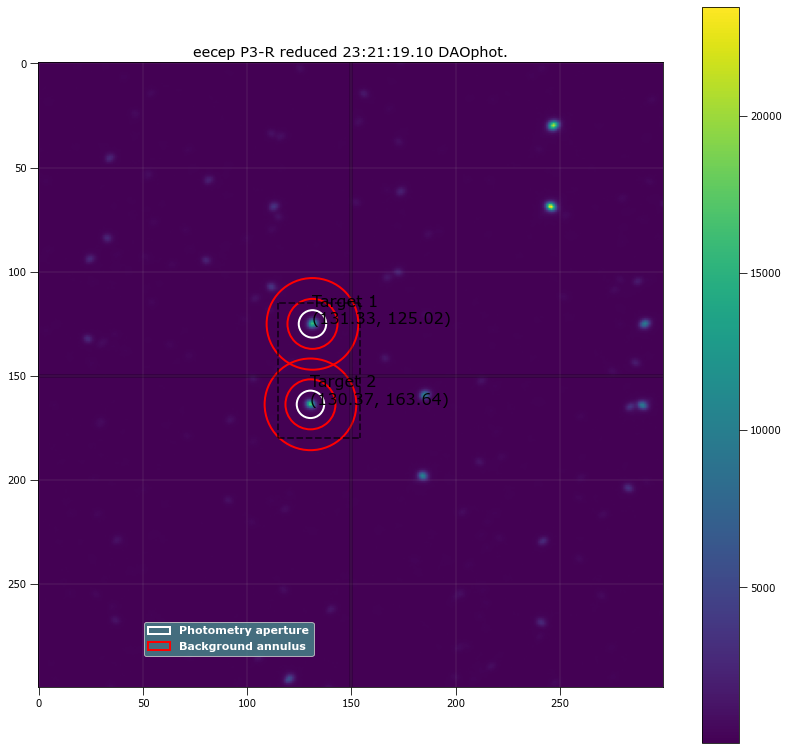

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.33265  125.0211 ...          4415.0467      141837.14           463.5383
  2 130.37179 163.64353 ...           4455.727      142492.16          465.69959

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.33265  125.0211 ...                 4355.9487             239094.33
  2 130.37179 163.64353 ...                 4396.3534             231533.06

Write this out the excel
293 23:21:19.10 P3-R 20.0 6.5838983050847455 131.33265448712132 125.02109549776658 239094.3315132673 4355.94869750513 1

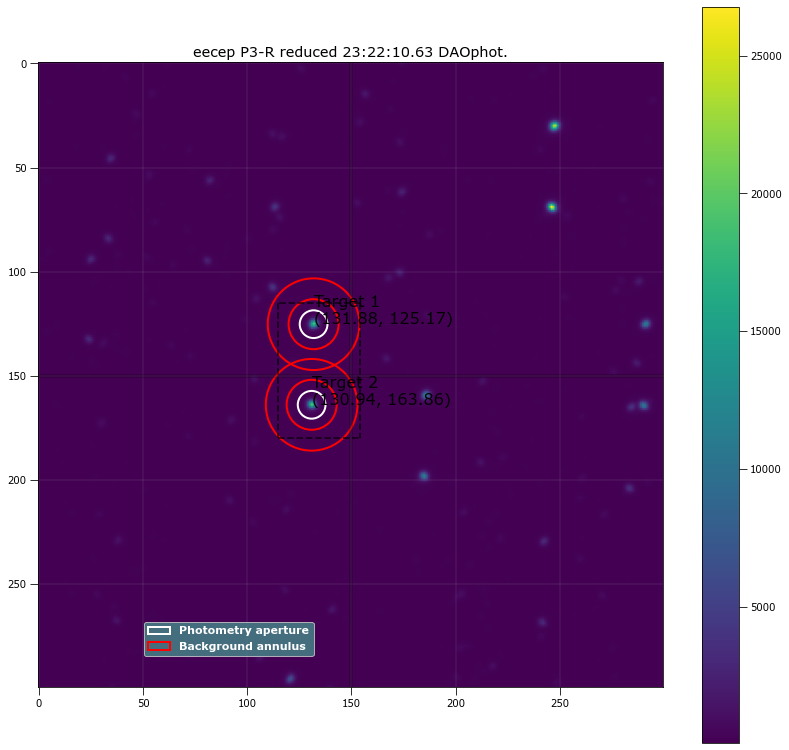

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.87653 125.16954 ...          4742.3161      139843.13          460.58666
  2 130.94141 163.86039 ...          4708.1999      141640.15          466.38134

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.87653 125.16954 ...                 4682.2412             241626.71
  2 130.94141 163.86039 ...                 4647.3692             233488.39

Write this out the excel
294 23:22:10.63 P3-R 20.0 6.659322033898305 131.87652862720694 125.16954009997704 241626.71000162888 4682.241248868736 13

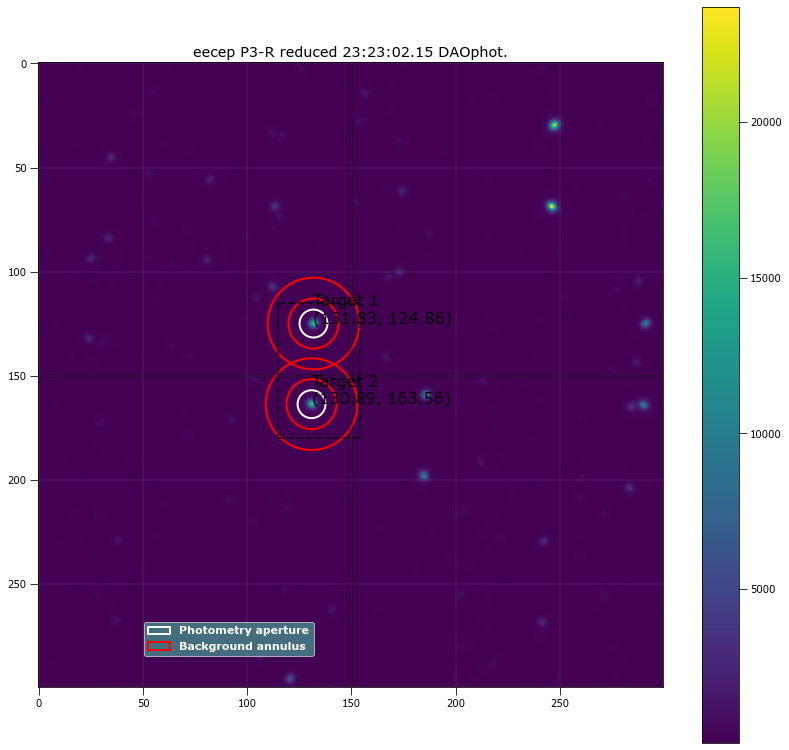

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  131.8251 124.85842 ...          4417.0668      139813.66          457.01512
  2 130.89454 163.56398 ...          4348.7816      140302.36          458.46625

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  131.8251 124.85842 ...                 4356.7808             238825.32
  2 130.89454 163.56398 ...                 4288.3042             230772.15

Write this out the excel
295 23:23:02.15 P3-R 20.0 6.697033898305085 131.82510486878274 124.85842209965355 238825.32124130928 4356.780819870606 

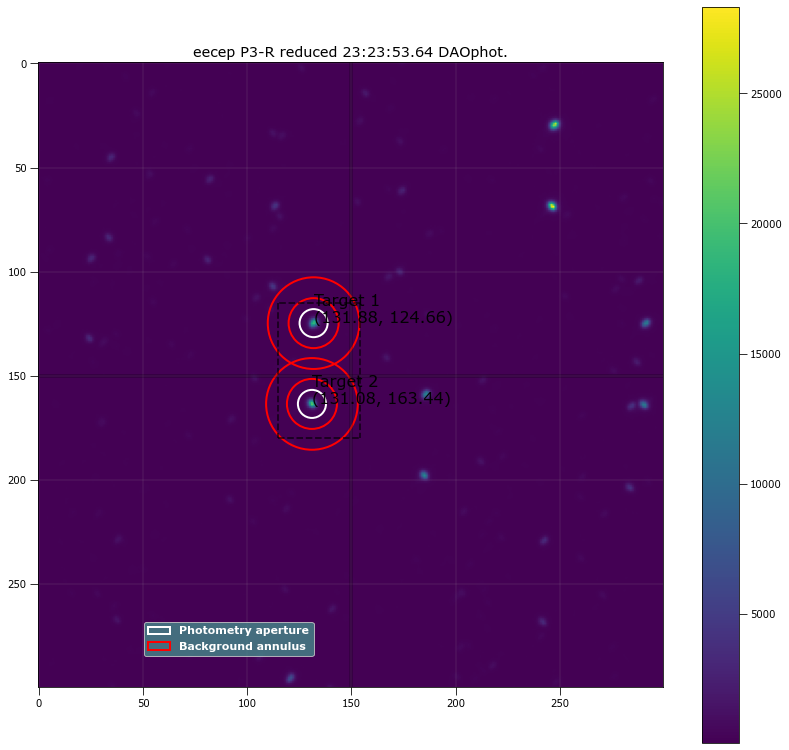

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.87816 124.66343 ...          4962.1704      139734.67          465.71912
  2 131.08197 163.43581 ...          5014.5057      139628.46          462.83206

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.87816 124.66343 ...                 4900.0423             240785.57
  2 131.08197 163.43581 ...                 4952.7628             232784.65

Write this out the excel
296 23:23:53.64 P3-R 20.0 6.734745762711864 131.8781617939915 124.66343313391293 240785.569629744 4900.042337825175 131.

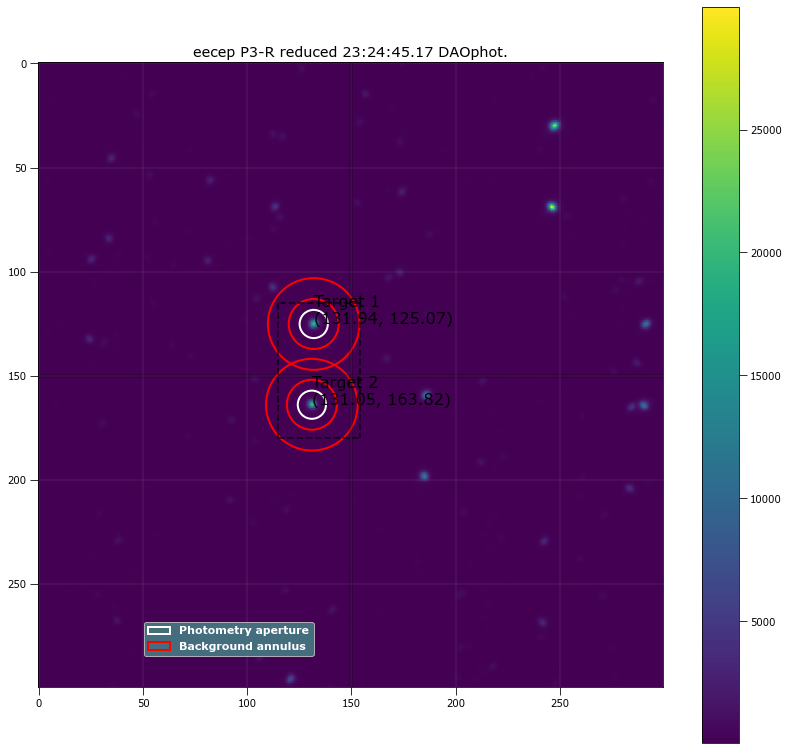

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 131.93901 125.07273 ...          4979.4285       139099.6          463.53328
  2 131.04957 163.82031 ...          4959.8971      139085.94          461.25946

 Aperture are: 144.09286139681686 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 131.93901 125.07273 ...                 4916.8976             241935.31
  2 131.04957 163.82031 ...                 4897.6729             233504.54

Write this out the excel
297 23:24:45.17 P3-R 20.0 6.772457627118644 131.93901031273793 125.07272921043199 241935.30977424243 4916.897648216014 

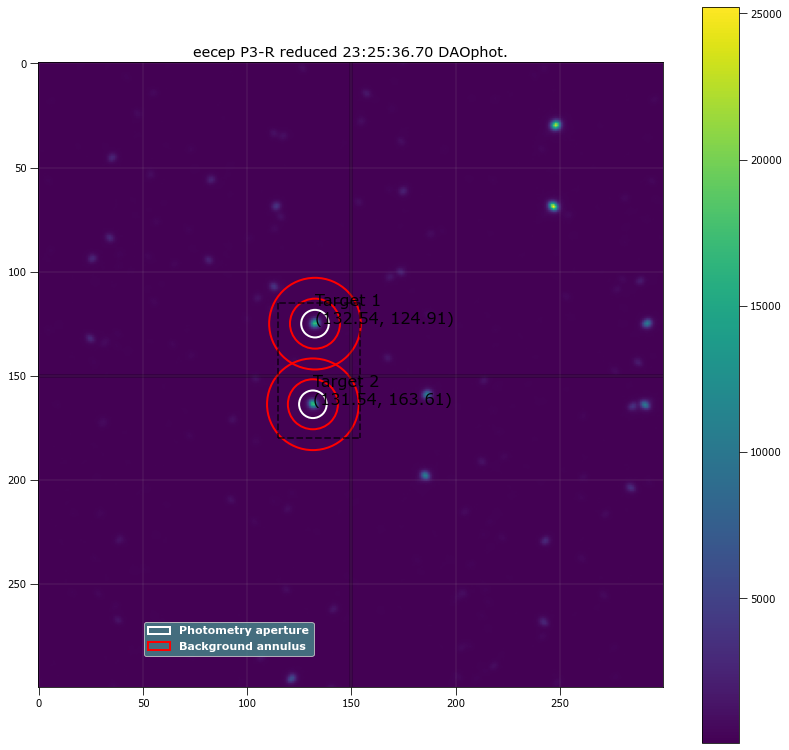

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.54257 124.90722 ...          4578.5207      138952.94          454.50112
  2  131.5359 163.61304 ...          4489.1385       138886.8           455.1584

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.54257 124.90722 ...                 4519.9092             240268.43
  2  131.5359 163.61304 ...                 4430.4422             232223.64

Write this out the excel
298 23:25:36.70 P3-R 20.0 6.621610169491525 132.5425749746214 124.90722208315772 240268.4262836173 4519.90915641005 131.

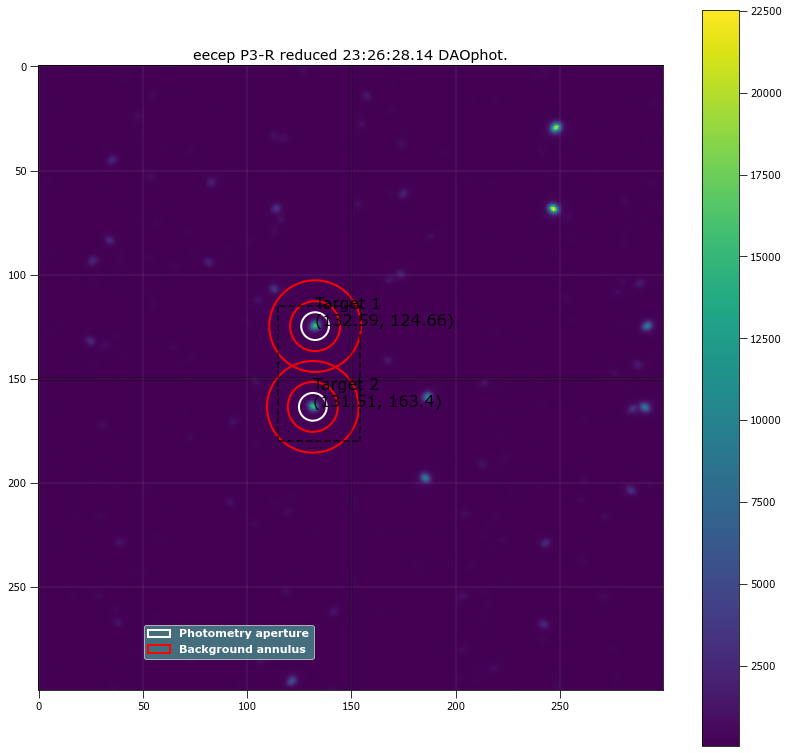

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.59437 124.65513 ...          4409.3118       138743.6          452.62313
  2 131.51499 163.39842 ...          4358.4923      139199.45          455.07592

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.59437 124.65513 ...                 4350.2757             241050.57
  2 131.51499 163.39842 ...                 4299.1362             233055.32

Write this out the excel
299 23:26:28.14 P3-R 20.0 6.659322033898304 132.59436924398233 124.65512891670478 241050.56756462133 4350.275694580021 

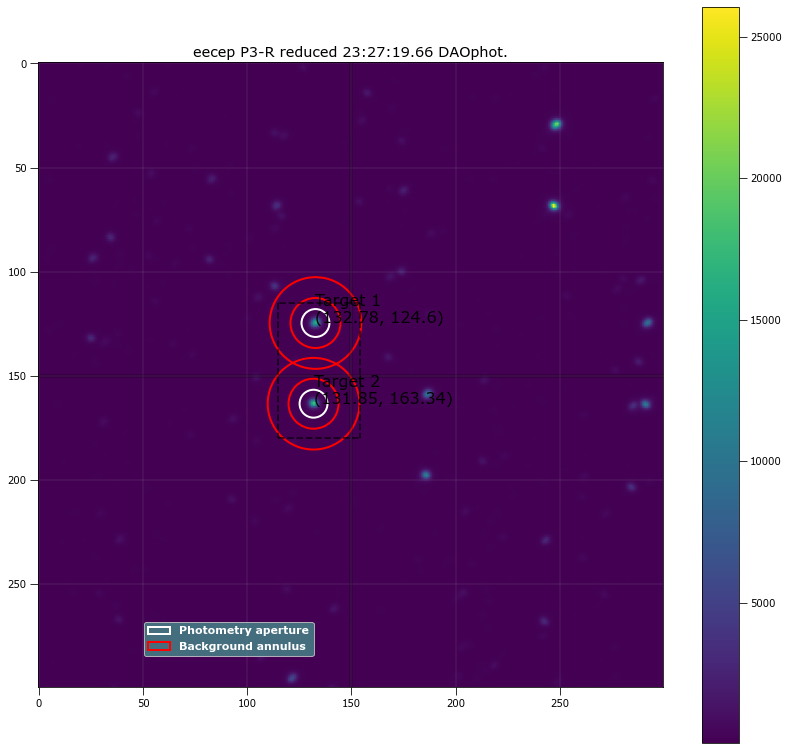

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.78263 124.60089 ...          4475.5613      137733.28          453.57021
  2 131.84709  163.3393 ...          4635.6272       138029.6          453.71149

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.78263 124.60089 ...                 4415.7297             240876.22
  2 131.84709  163.3393 ...                 4575.7769             233286.11

Write this out the excel
300 23:27:19.66 P3-R 20.0 6.697033898305085 132.78262945969698 124.60088676965756 240876.21855010852 4415.729735429803 

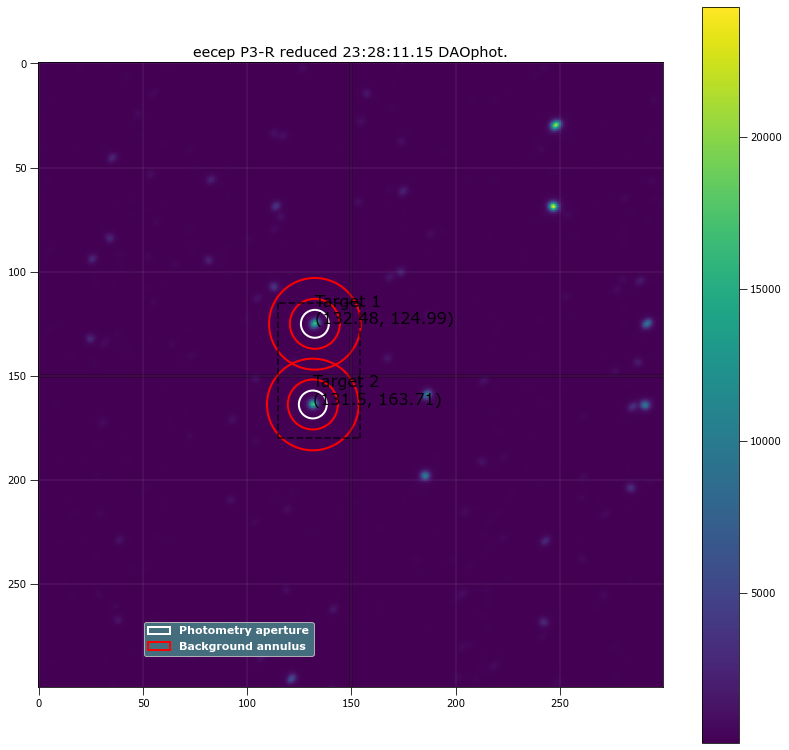

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.47896 124.99033 ...          4528.7829      138524.21          453.03909
  2 131.50283 163.71432 ...          4477.5805      138447.24          453.56713

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.47896 124.99033 ...                 4469.0213             242402.92
  2 131.50283 163.71432 ...                 4417.7493             233400.03

Write this out the excel
301 23:28:11.15 P3-R 20.0 6.697033898305085 132.47895604888328 124.99032781846914 242402.9245959567 4469.021346707319 1

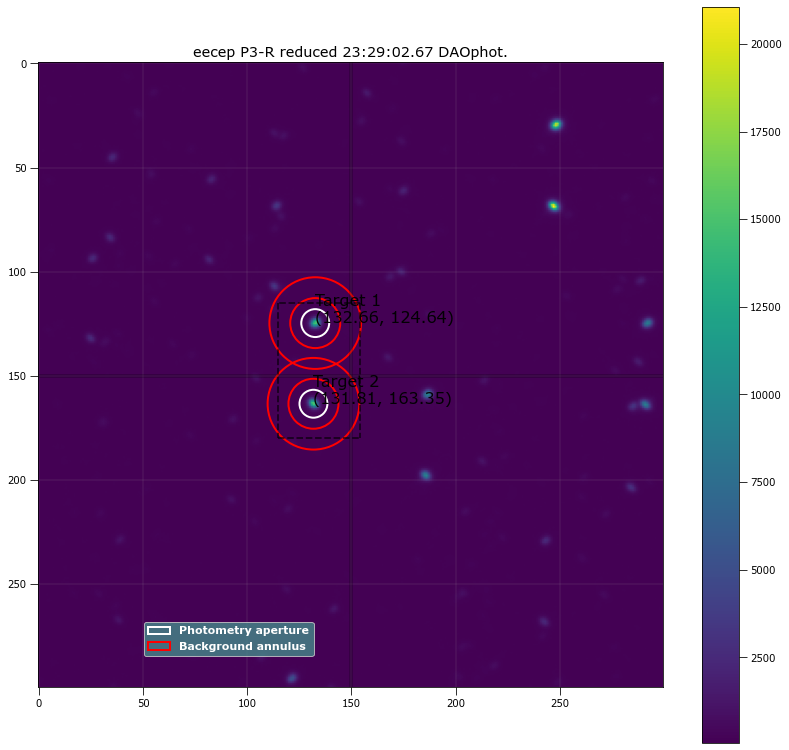

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.66366 124.64161 ...          4299.1965      138000.62           451.7033
  2 131.80681 163.35386 ...          4222.9301      139472.87           454.1333

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.66366 124.64161 ...                 4239.6112             240793.76
  2 131.80681 163.35386 ...                 4163.0242             232332.48

Write this out the excel
302 23:29:02.67 P3-R 20.0 6.697033898305085 132.66366390335332 124.64160726630583 240793.76022641122 4239.611177762051 

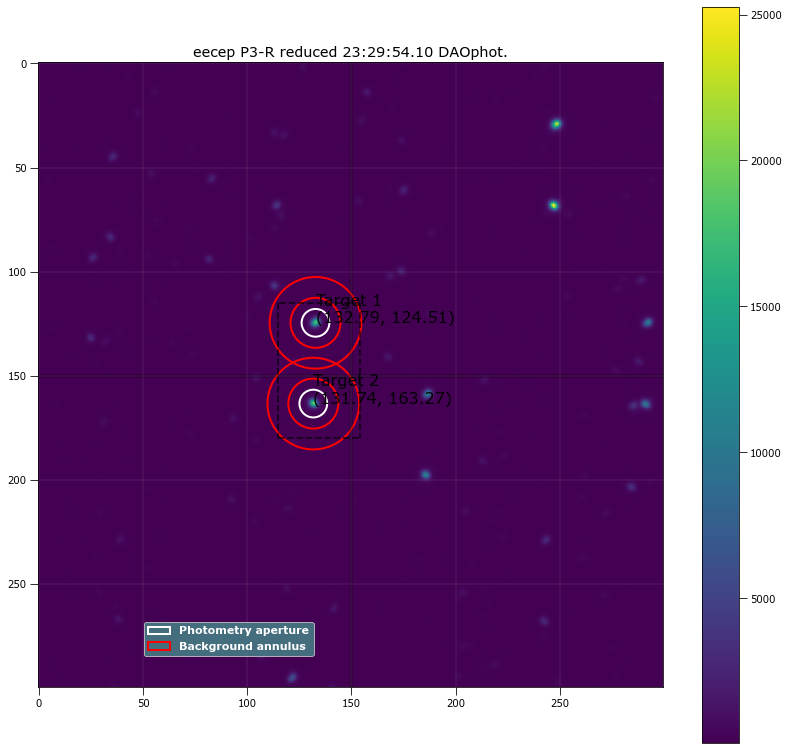

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.79435 124.51081 ...          4739.6319      138118.84          455.48824
  2 131.73974 163.27402 ...          4792.8209      139025.13          459.59163

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.79435 124.51081 ...                 4680.2221             242784.54
  2 131.73974 163.27402 ...                 4732.8759             235094.96

Write this out the excel
303 23:29:54.10 P3-R 20.0 6.659322033898304 132.79434936462027 124.5108147993285 242784.53673185236 4680.222097986412 1

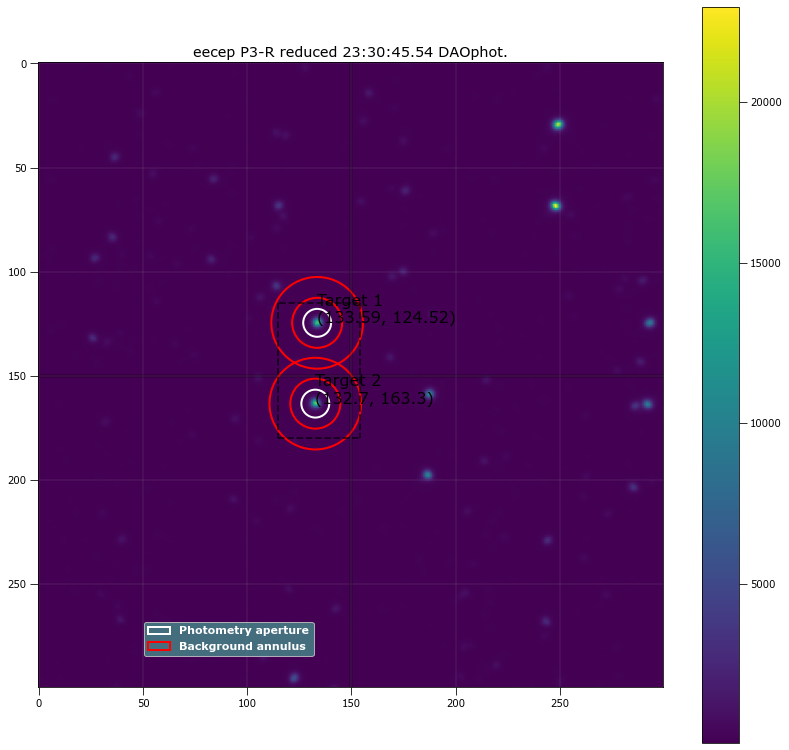

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.58841 124.51557 ...          4467.8182      138556.97          455.15962
  2  132.7013 163.29782 ...          4485.0723      139459.36          456.94606

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.58841 124.51557 ...                  4407.777             242142.64
  2  132.7013 163.29782 ...                 4424.7954             234442.27

Write this out the excel
304 23:30:45.54 P3-R 20.0 6.697033898305085 133.58841354773995 124.51557330948627 242142.63774783557 4407.776957406892 

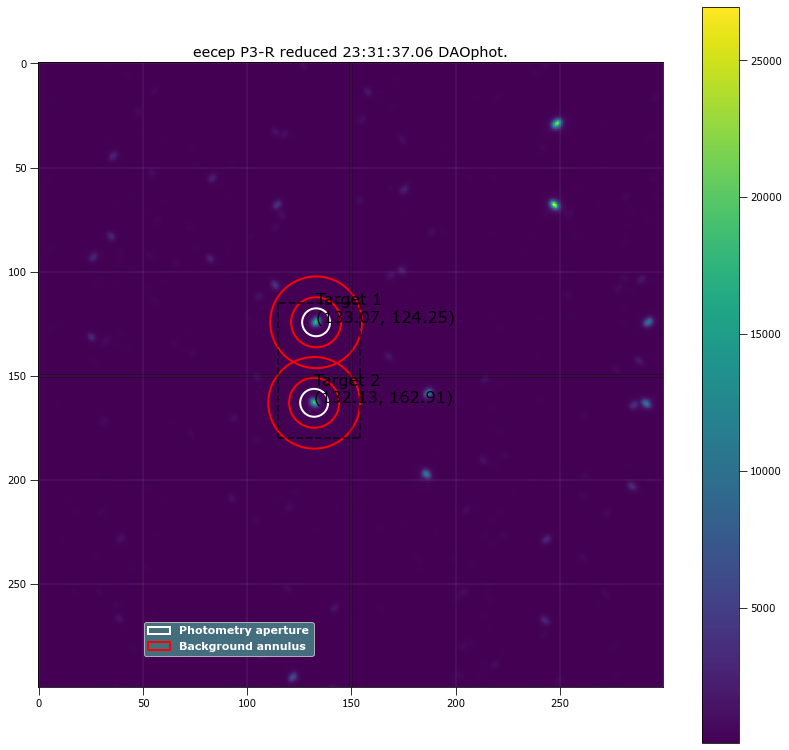

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.07414 124.24552 ...          4797.0899      137954.92          457.39993
  2 132.13483  162.9079 ...          4807.6215      139225.41          460.60105

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.07414 124.24552 ...                 4736.7531             241682.96
  2 132.13483  162.9079 ...                 4746.8624             233859.23

Write this out the excel
305 23:31:37.06 P3-R 20.0 6.697033898305085 133.07414475108348 124.24552473317735 241682.9605764125 4736.75306740215 13

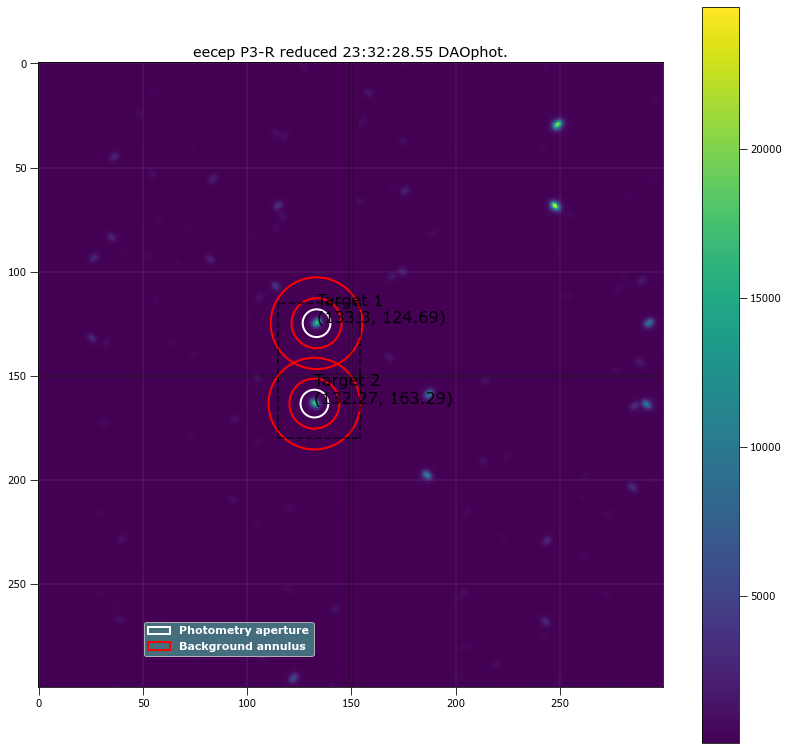

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.29539 124.68896 ...          4650.6127      138306.59          455.06026
  2 132.26953 163.29318 ...          4675.6646      139848.46          461.49336

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.29539 124.68896 ...                 4591.2587              243389.4
  2 132.26953 163.29318 ...                 4615.4716             236189.45

Write this out the excel
306 23:32:28.55 P3-R 20.0 6.659322033898305 133.29539119380698 124.68896402925955 243389.4001611156 4591.258678243118 132

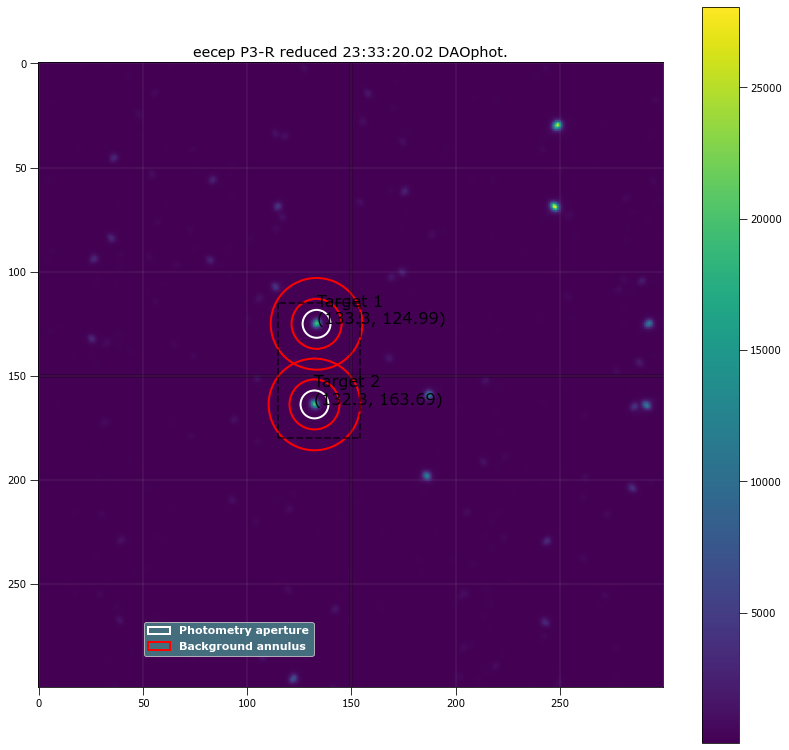

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.30105 124.99428 ...          5030.3422      138313.71          460.86245
  2 132.30385  163.6862 ...            4950.95       138902.5          462.33603

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.30105 124.99428 ...                 4969.5487             244798.72
  2 132.30385  163.6862 ...                 4889.9621             237309.02

Write this out the excel
307 23:33:20.02 P3-R 20.0 6.697033898305085 133.30104871819054 124.99427758785043 244798.72010614345 4969.548670316518 

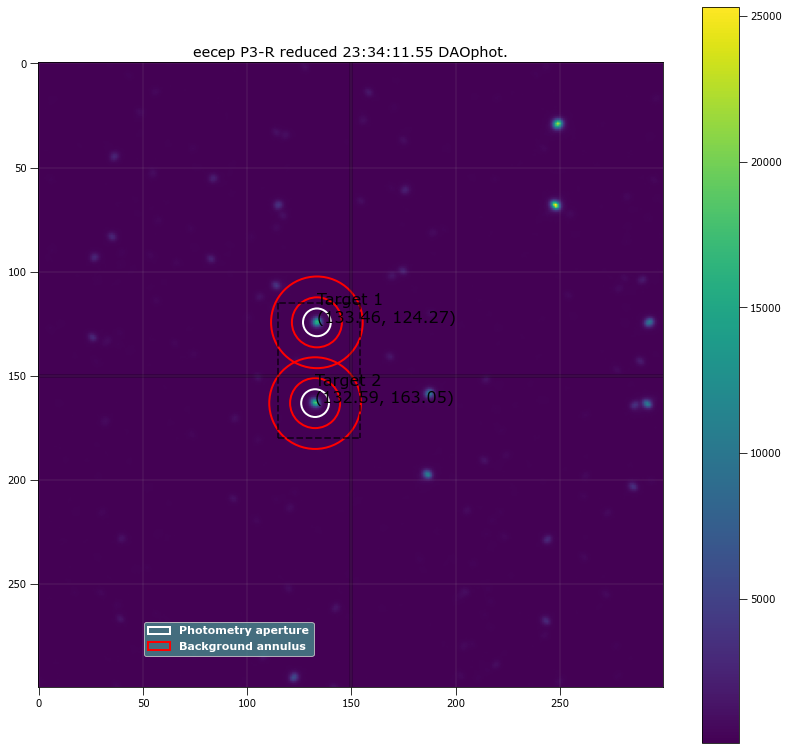

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  133.4602 124.27339 ...          4567.6765      138352.75          456.40492
  2 132.59478 163.05245 ...          4595.2914      138607.03          456.03384

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  133.4602 124.27339 ...                 4508.1471             243155.69
  2 132.59478 163.05245 ...                 4535.8104             236070.57

Write this out the excel
308 23:34:11.55 P3-R 20.0 6.659322033898304 133.4601958707796 124.27338684597859 243155.68923201843 4508.147117943582 1

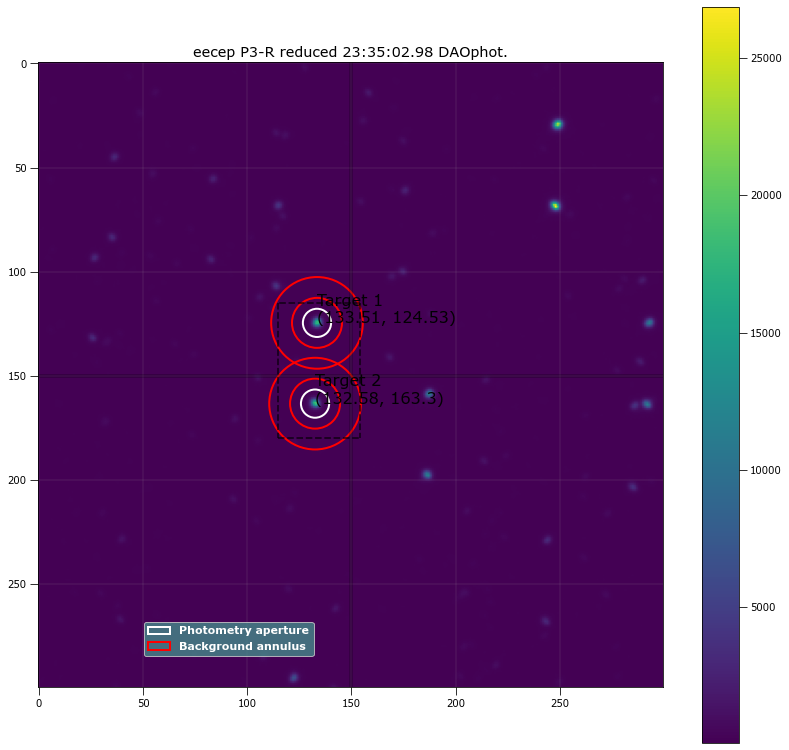

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.50549  124.5349 ...          4806.3043      138353.51          459.80289
  2 132.57518 163.29777 ...          4762.0881      139484.07          460.14864

 Aperture are: 144.09286139681686 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.50549  124.5349 ...                 4744.2767             244164.04
  2 132.57518 163.29777 ...                 4700.0138             236961.23

Write this out the excel
309 23:35:02.98 P3-R 20.0 6.772457627118644 133.50549102844207 124.53490008664774 244164.04254432046 4744.276658035778 

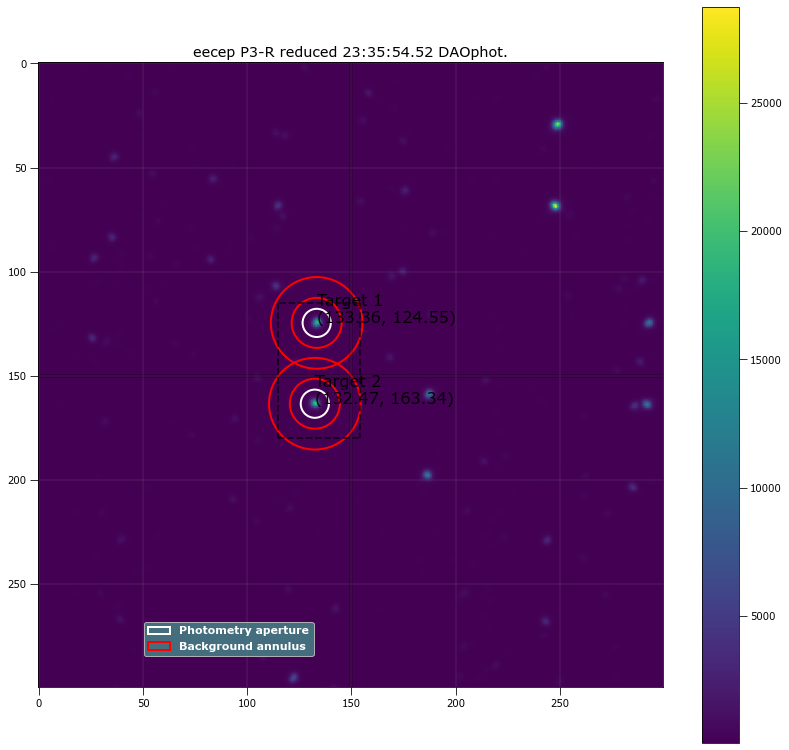

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.36355 124.55189 ...          4900.1954         138064          460.97962
  2  132.4719 163.34327 ...          4943.1769      137784.53          457.35191

 Aperture are: 144.0928613968168 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.36355 124.55189 ...                  4838.009             245683.36
  2  132.4719 163.34327 ...                 4881.4799             237938.61

Write this out the excel
310 23:35:54.52 P3-R 20.0 6.772457627118643 133.36354857531484 124.55189360356569 245683.35657928442 4838.008977573466 1

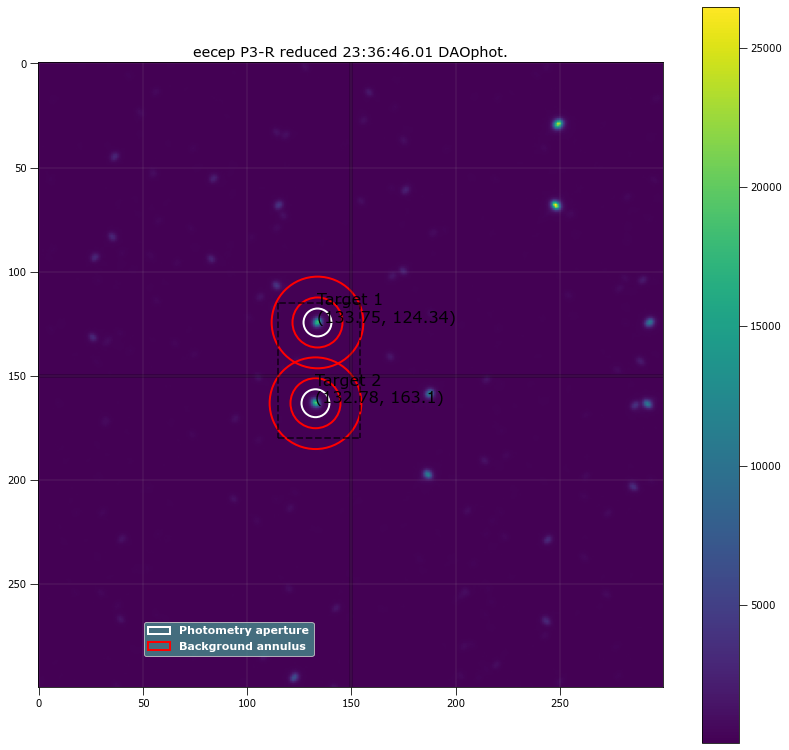

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.74668 124.34102 ...          4789.7596      137125.26           452.9195
  2 132.78029 163.10282 ...          4753.0269       137387.7          455.10601

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.74668 124.34102 ...                 4730.0139             244524.85
  2 132.78029 163.10282 ...                 4692.9927             236899.17

Write this out the excel
311 23:36:46.01 P3-R 20.0 6.697033898305085 133.746684560163 124.3410187339751 244524.84741652865 4730.013881255004 132

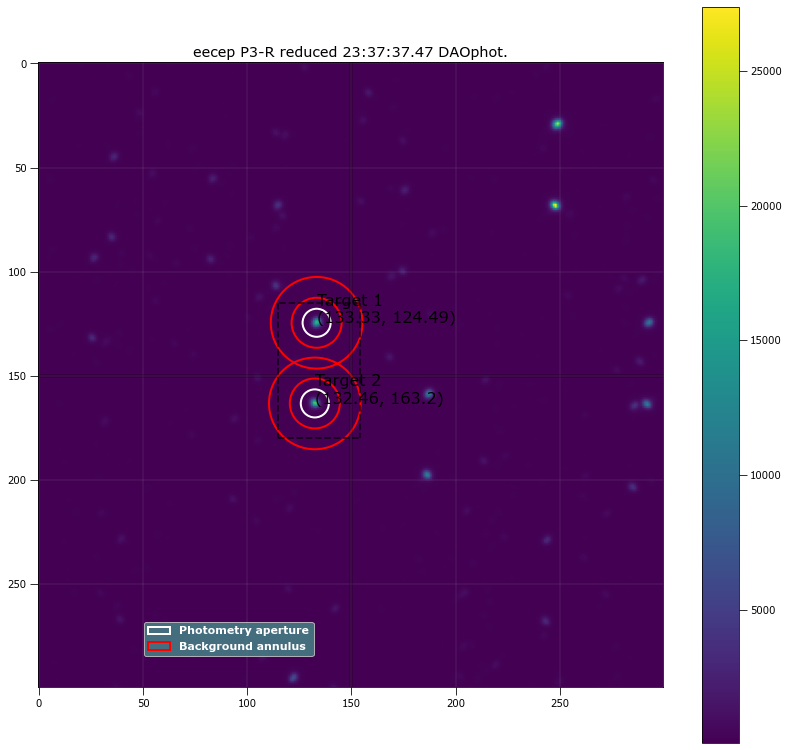

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.32902 124.49065 ...          4812.5888      136898.81          454.63302
  2 132.46037 163.19831 ...          4867.3007      137755.71          455.53126

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.32902 124.49065 ...                 4751.9397             243359.33
  2 132.46037 163.19831 ...                 4806.5317             235385.68

Write this out the excel
312 23:37:37.47 P3-R 20.0 6.734745762711864 133.329022309096 124.49065366143881 243359.33456510247 4751.939672032346 132

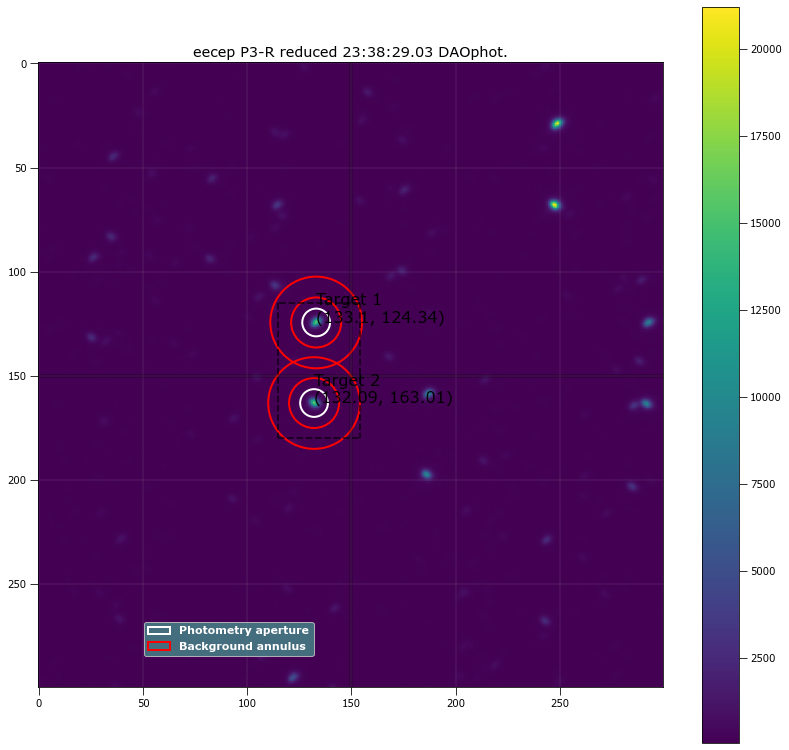

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.10105  124.3362 ...          4385.5843      137419.68          449.74001
  2 132.09311 163.01264 ...          4320.1786      137787.03          451.81586

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.10105  124.3362 ...                 4326.9242             241622.17
  2 132.09311 163.01264 ...                 4261.2478             234877.65

Write this out the excel
313 23:38:29.03 P3-R 20.0 6.659322033898305 133.10105475271968 124.33620211373155 241622.17497539605 4326.924244855185 13

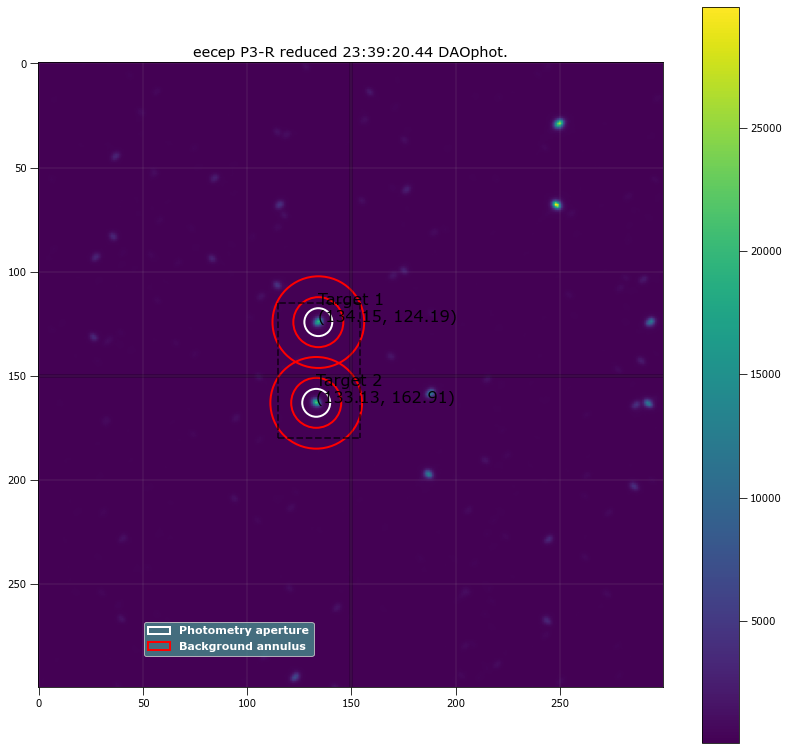

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.15036 124.18524 ...          4967.0689      136002.88          453.09961
  2 133.12721 162.91039 ...          5052.2365      137439.08           460.1751

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.15036 124.18524 ...                 4907.2994             245169.69
  2 133.12721 162.91039 ...                 4991.5336             236666.28

Write this out the excel
314 23:39:20.44 P3-R 20.0 6.697033898305085 134.15035930656714 124.18524229553097 245169.68801422222 4907.29942399325 1

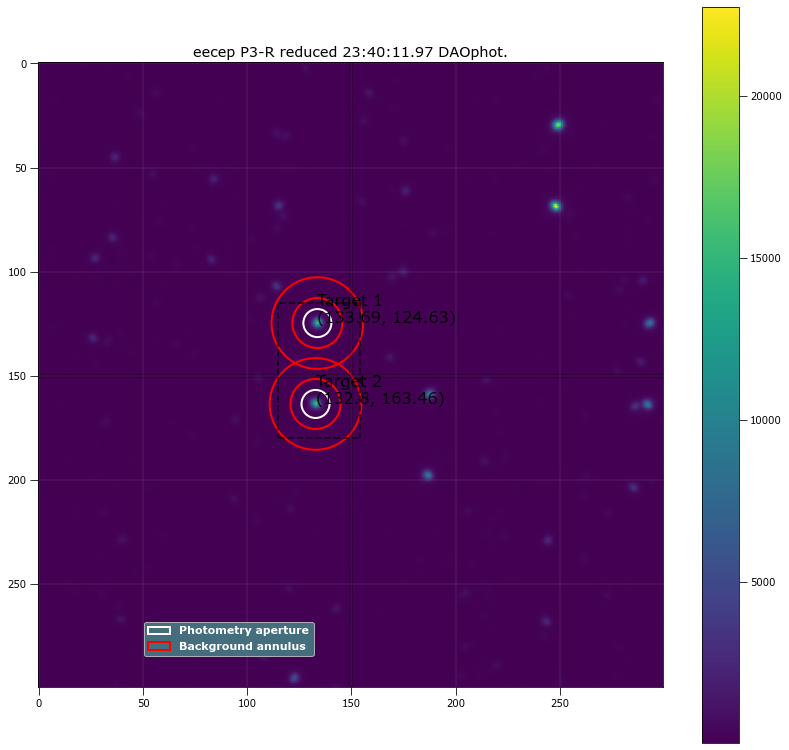

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 133.69364 124.62881 ...          4274.8433       137632.4           450.5628
  2 132.80256 163.45708 ...          4227.3048      137532.83          448.64307

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 133.69364 124.62881 ...                 4214.7372             242581.93
  2 132.80256 163.45708 ...                 4167.4548             235008.39

Write this out the excel
315 23:40:11.97 P3-R 20.0 6.734745762711864 133.69363711437953 124.62881404175207 242581.9333062511 4214.737164372928 13

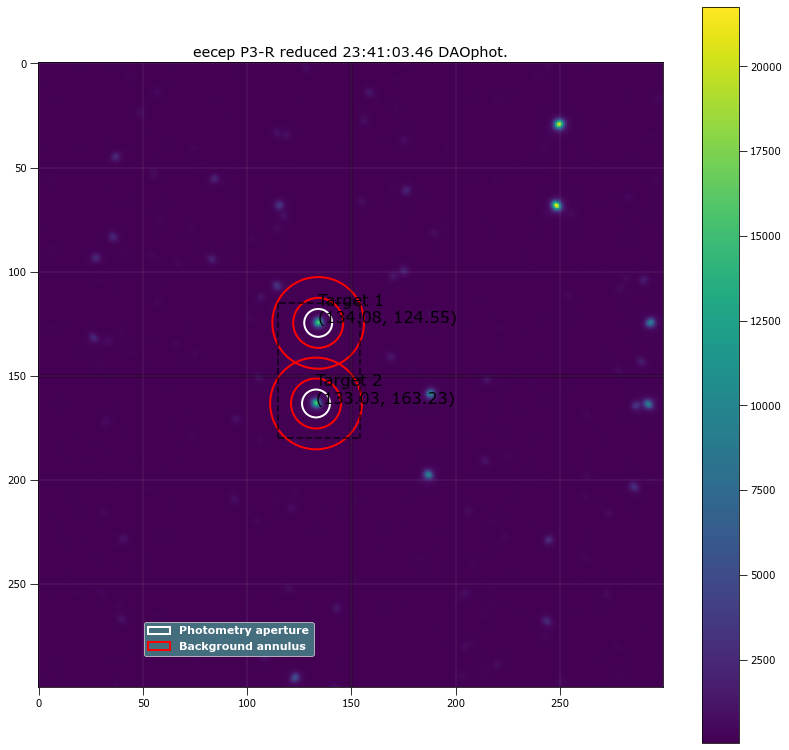

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.08391 124.54501 ...          4374.4874      136685.12          447.75692
  2  133.0315 163.23172 ...          4268.2288      137070.52          449.29294

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.08391 124.54501 ...                 4315.4227             242726.78
  2  133.0315 163.23172 ...                 4208.9614             235129.98

Write this out the excel
316 23:41:03.46 P3-R 20.0 6.697033898305085 134.0839110913375 124.54501322015265 242726.77601078572 4315.4226623569475 

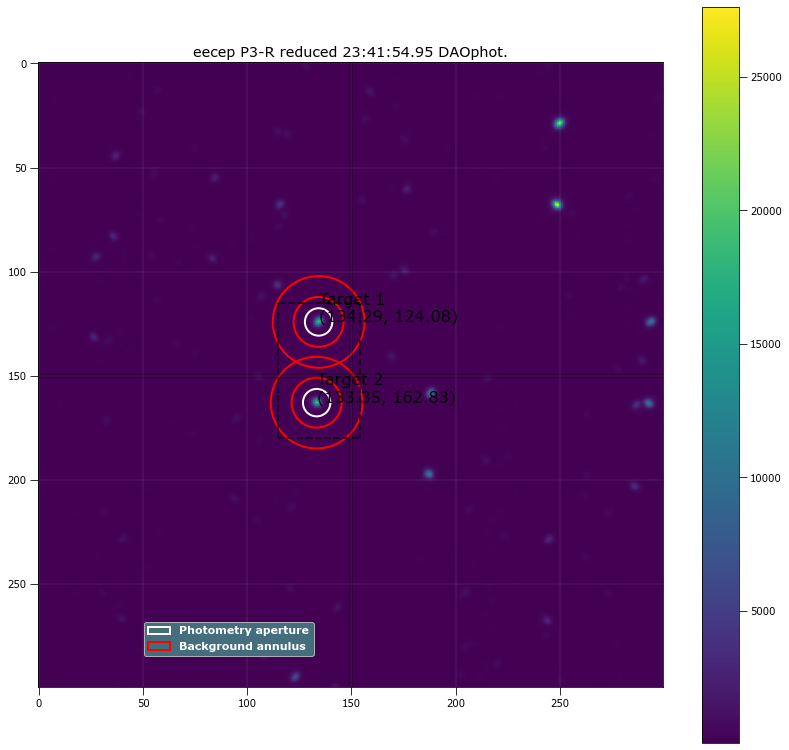

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.28881 124.08449 ...          4798.4966       135952.7          452.79879
  2 133.34612 162.82577 ...          4805.7084      136308.24          454.56921

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.28881 124.08449 ...                 4740.7678             244628.38
  2 133.34612 162.82577 ...                 4747.7539             236923.07

Write this out the excel
317 23:41:54.95 P3-R 20.0 6.5838983050847455 134.2888147540484 124.08448589441709 244628.37656652226 4740.767805890079 

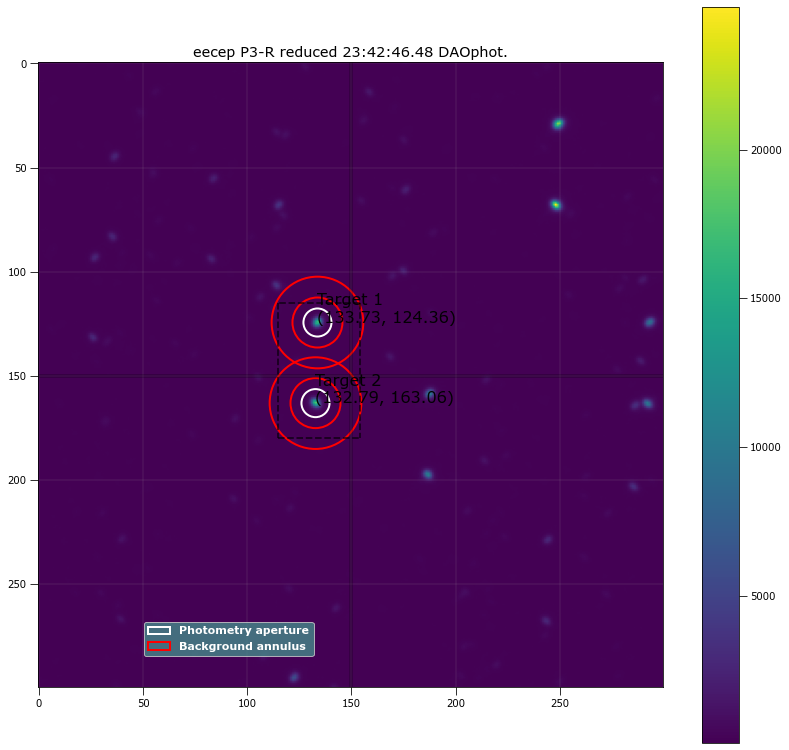

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  133.7315 124.35883 ...          4548.6636      134716.96          442.12122
  2 132.78623 163.05923 ...          4519.0279      135771.21          446.86708

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  133.7315 124.35883 ...                 4489.6836             245196.75
  2 132.78623 163.05923 ...                 4459.4148             236620.73

Write this out the excel
318 23:42:46.48 P3-R 20.0 6.734745762711864 133.73149883867433 124.35882718819843 245196.7497122453 4489.683591863888 13

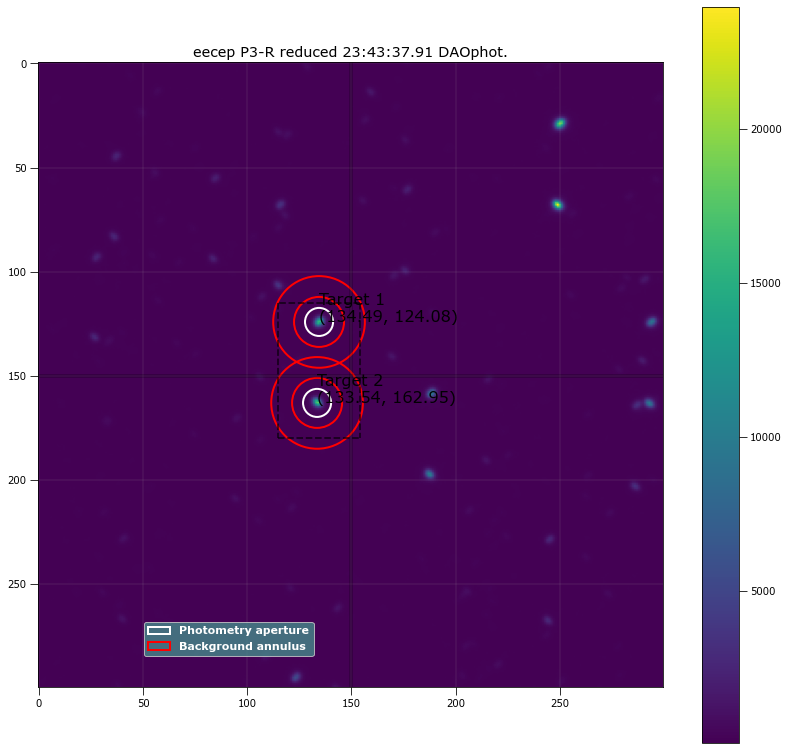

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.49243 124.08194 ...          4472.2885       134647.9          444.12805
  2  133.5436 162.95127 ...          4509.2698      135696.59          445.41373

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.49243 124.08194 ...                 4413.0408             246342.43
  2  133.5436 162.95127 ...                 4449.8505             237998.41

Write this out the excel
319 23:43:37.91 P3-R 20.0 6.734745762711864 134.49243011817032 124.08193930737178 246342.43483600547 4413.040773739206 1

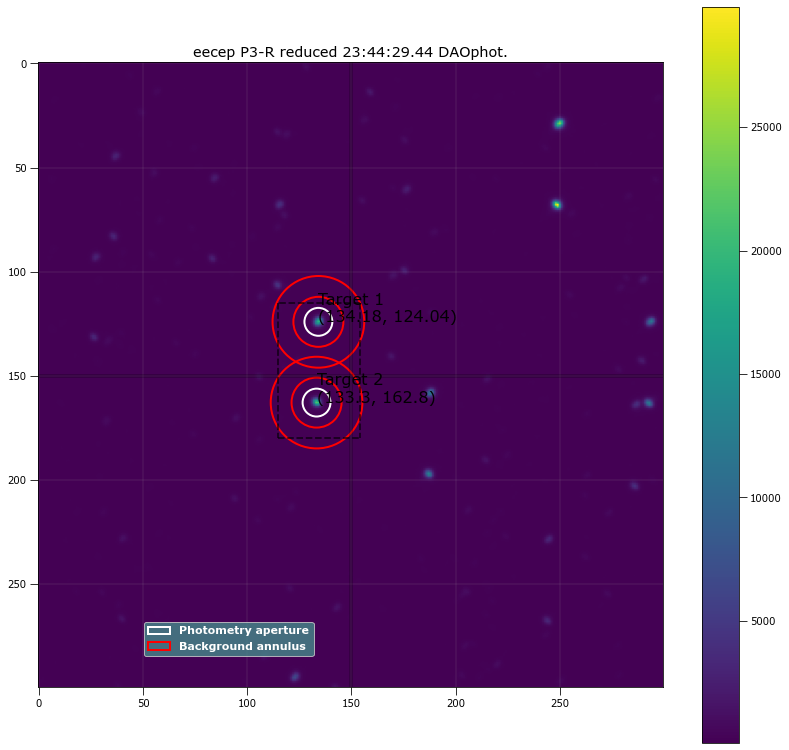

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.18022 124.03558 ...           4936.177      134506.38           449.5967
  2 133.29631  162.7967 ...          5081.3641      135542.42           451.9451

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.18022 124.03558 ...                 4876.8695             247621.89
  2 133.29631  162.7967 ...                 5021.7469             239113.52

Write this out the excel
320 23:44:29.44 P3-R 20.0 6.697033898305085 134.18022220191853 124.03557798702461 247621.8907131396 4876.869516385219 1

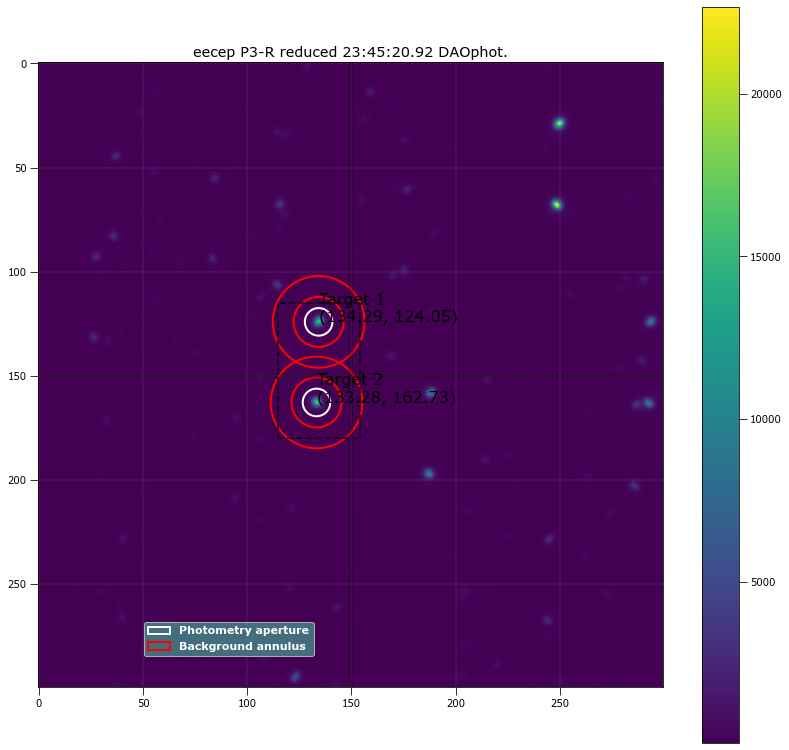

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.29183 124.05201 ...          4457.3118      133840.56          438.78273
  2 133.27706 162.73334 ...          4434.8518      135654.49          445.30153

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.29183 124.05201 ...                 4400.7273             245042.32
  2 133.27706 162.73334 ...                 4377.4266             237595.23

Write this out the excel
321 23:45:20.92 P3-R 20.0 6.621610169491525 134.2918271246294 124.05200671721198 245042.31701055507 4400.7272729125325 1

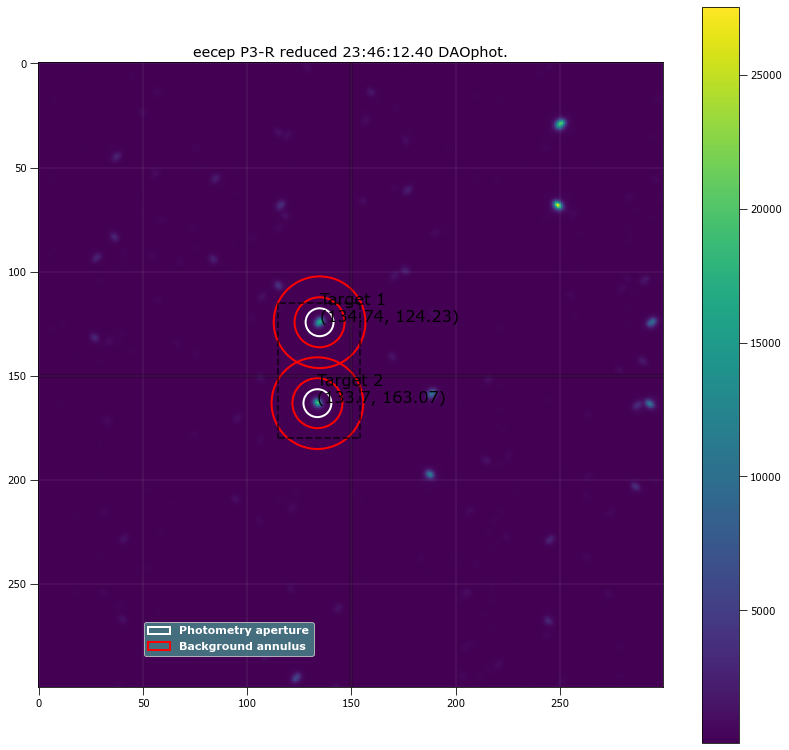

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.74491 124.23368 ...          4685.9534      134238.17          445.40252
  2 133.70403 163.07397 ...          4789.3421      135666.13          450.27156

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.74491 124.23368 ...                 4627.1992              247464.2
  2 133.70403 163.07397 ...                 4729.9456             238563.78

Write this out the excel
322 23:46:12.40 P3-R 20.0 6.697033898305085 134.74490746654007 124.23368292084005 247464.20340592894 4627.199177591613 

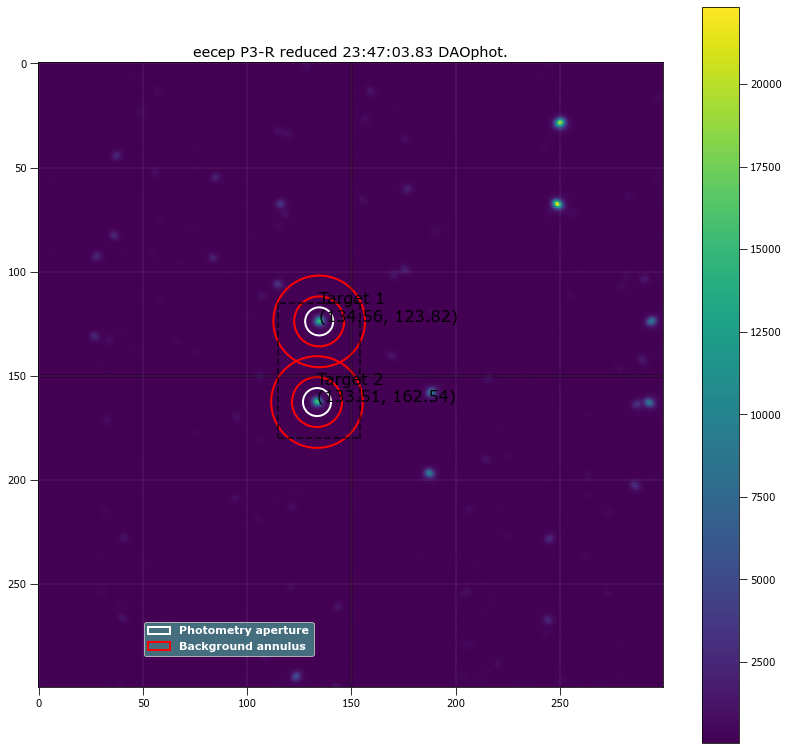

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.56169 123.82454 ...          4316.4009      133655.29          437.87253
  2 133.51338 162.54391 ...          4313.2328      134366.67          439.69537

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.56169 123.82454 ...                 4257.9877             245387.66
  2 133.51338 162.54391 ...                 4254.5764             237335.45

Write this out the excel
323 23:47:03.83 P3-R 20.0 6.734745762711864 134.56168999436917 123.82454183438412 245387.66434893094 4257.98765393609 13

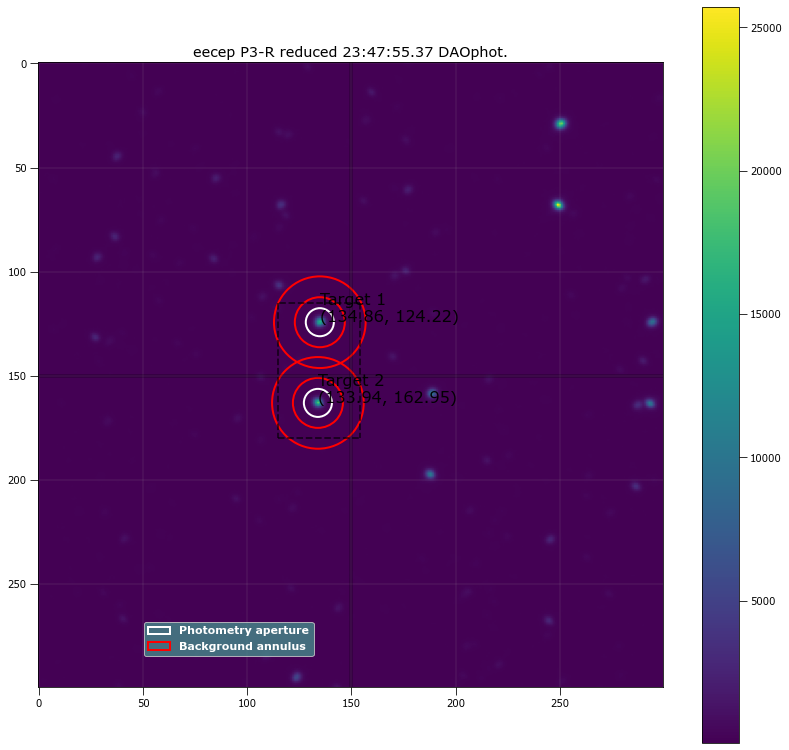

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.86319 124.21563 ...           4471.661      132844.54          438.63224
  2 133.93948 162.94507 ...          4552.7681      133241.37          439.77022

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.86319 124.21563 ...                 4413.1465             246327.25
  2 133.93948 162.94507 ...                 4494.1017             238593.88

Write this out the excel
324 23:47:55.37 P3-R 20.0 6.734745762711864 134.8631885672932 124.21563453226153 246327.254097856 4413.146456253951 133.

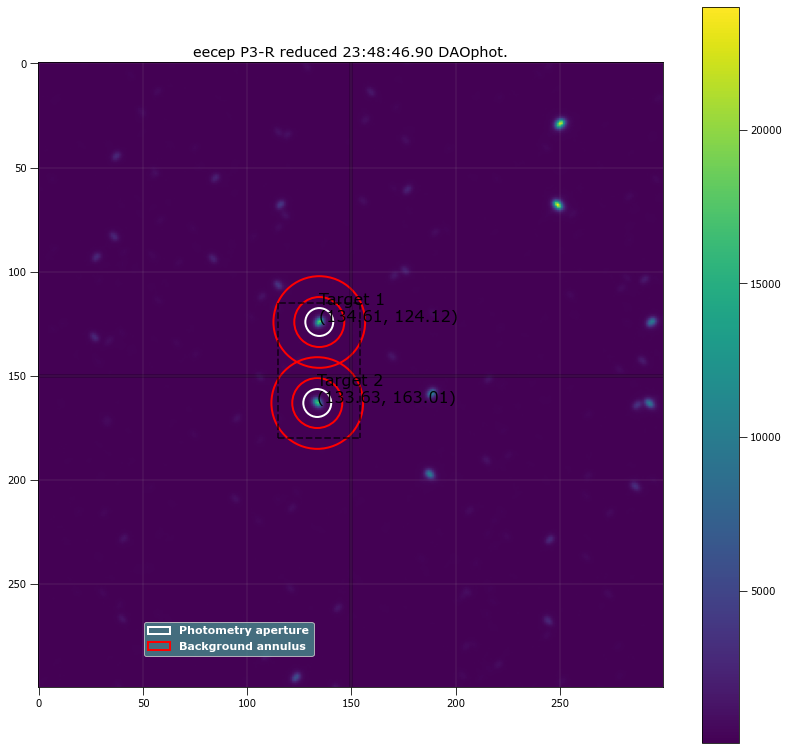

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  134.6075 124.12441 ...          4708.9944      132889.88          439.08288
  2 133.63324 163.00758 ...          4494.7039      134007.01          441.62898

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  134.6075 124.12441 ...                 4651.0739             246585.23
  2 133.63324 163.00758 ...                 4436.4475             238268.53

Write this out the excel
325 23:48:46.90 P3-R 20.0 6.697033898305085 134.60749749661073 124.12441294239521 246585.22945018907 4651.073897517855 

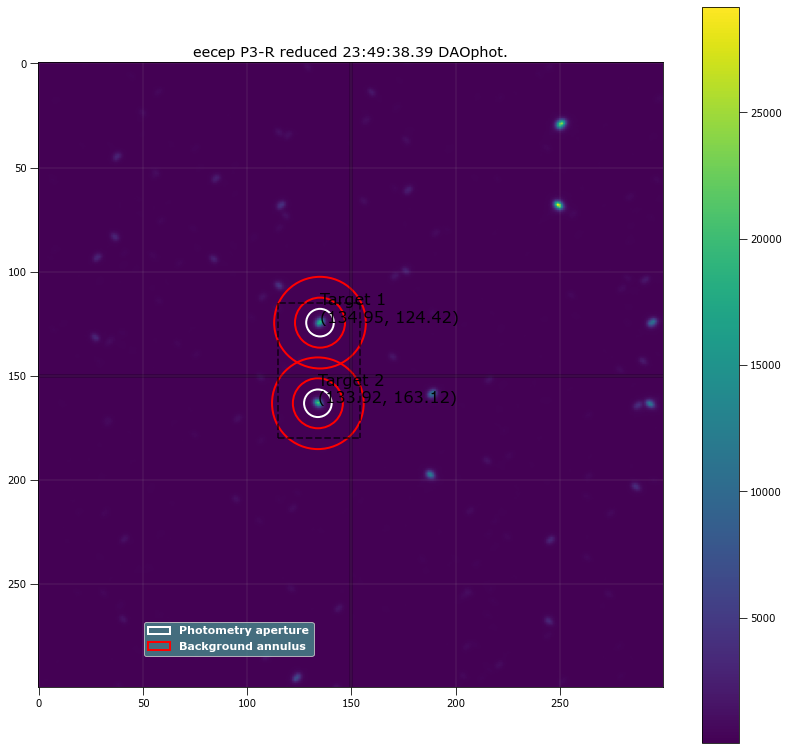

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.95217 124.42373 ...          4973.5474      131755.52           439.9483
  2 133.92344 163.12299 ...          4983.1402      133174.09          447.22194

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.95217 124.42373 ...                 4916.8125             247736.23
  2 133.92344 163.12299 ...                 4925.4673             240337.17

Write this out the excel
326 23:49:38.39 P3-R 20.0 6.621610169491525 134.95216833090922 124.42373022926485 247736.2301049789 4916.8125280228305 1

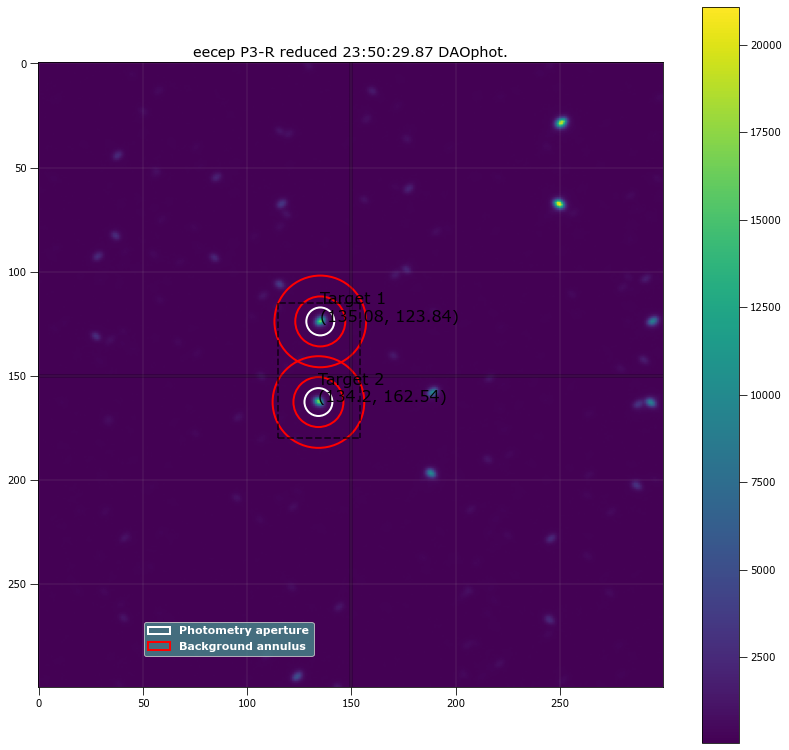

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 135.08392 123.84145 ...          4514.8858       131861.3          435.49094
  2  134.2001 162.53838 ...          4552.3636      132430.59           438.0288

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 135.08392 123.84145 ...                 4457.4391             247624.53
  2  134.2001 162.53838 ...                 4494.5821             240629.67

Write this out the excel
327 23:50:29.87 P3-R 20.0 6.697033898305085 135.08392489549786 123.84145008058371 247624.53465950393 4457.439127481184 

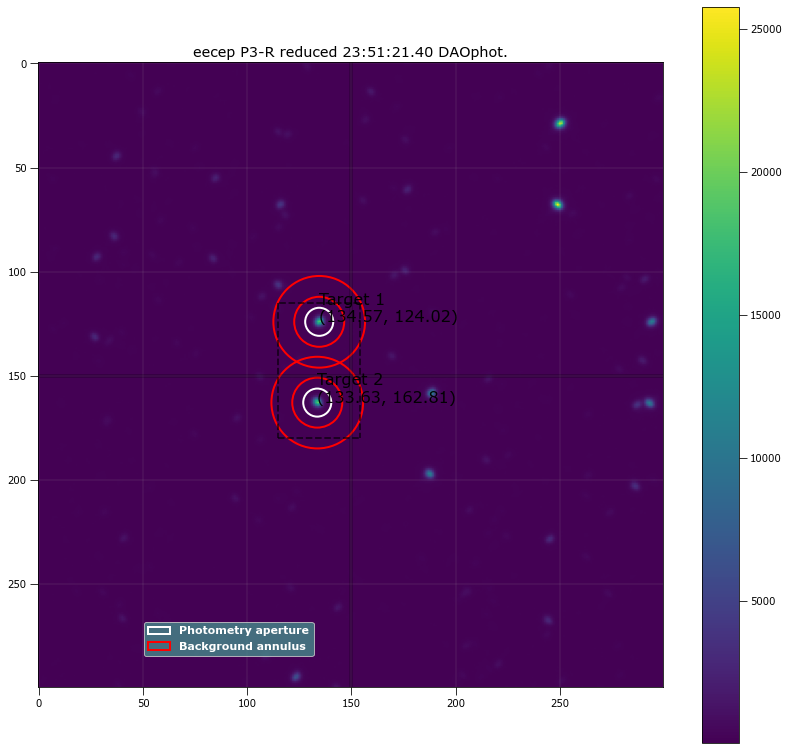

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.57238 124.01892 ...          4801.4481      132219.46          439.37312
  2 133.63383 162.80571 ...           4718.706      133468.73          444.85602

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.57238 124.01892 ...                 4742.8346             248078.24
  2 133.63383 162.80571 ...                 4659.3612             240346.31

Write this out the excel
328 23:51:21.40 P3-R 20.0 6.734745762711864 134.57237883585958 124.01892280466028 248078.23840326502 4742.834641382561 1

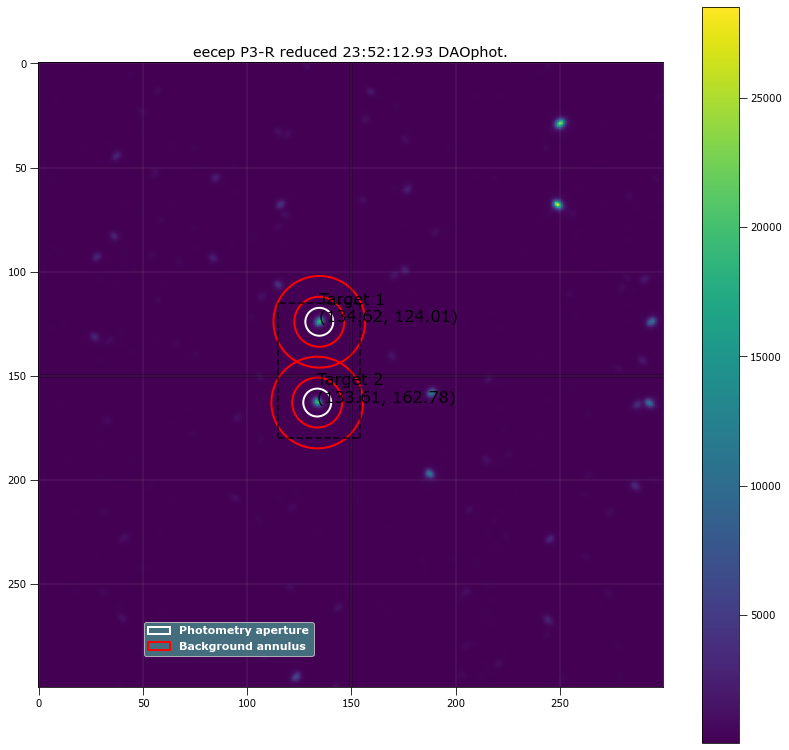

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.61809 124.01437 ...          4898.9972      132627.23          441.39004
  2 133.61435 162.78182 ...          4832.2618       133748.5          446.93142

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.61809 124.01437 ...                 4840.7723             248680.56
  2 133.61435 162.78182 ...                 4773.3059             240554.76

Write this out the excel
329 23:52:12.93 P3-R 20.0 6.697033898305085 134.61808592038957 124.01436863350779 248680.56093821037 4840.772290538846 

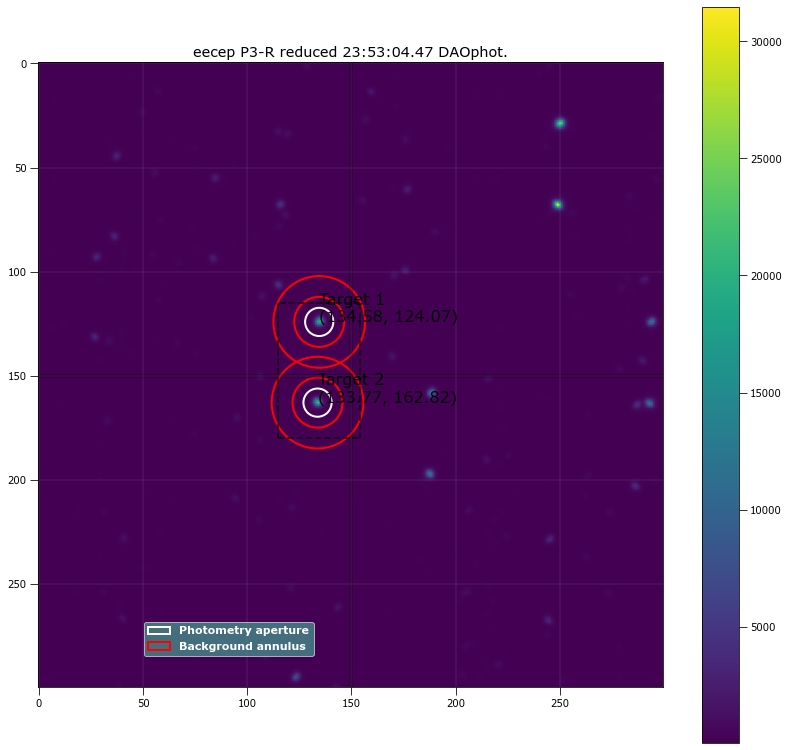

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 134.58339 124.07496 ...          5006.1662      131430.33          442.78639
  2  133.7659  162.8219 ...          5009.5906      132549.35          445.00876

 Aperture are: 144.09286139681686 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 134.58339 124.07496 ...                 4946.4341             250279.28
  2  133.7659  162.8219 ...                 4949.5587             242013.71

Write this out the excel
330 23:53:04.47 P3-R 20.0 6.772457627118644 134.5833916491476 124.07495623016925 250279.27841493097 4946.434052810212 1

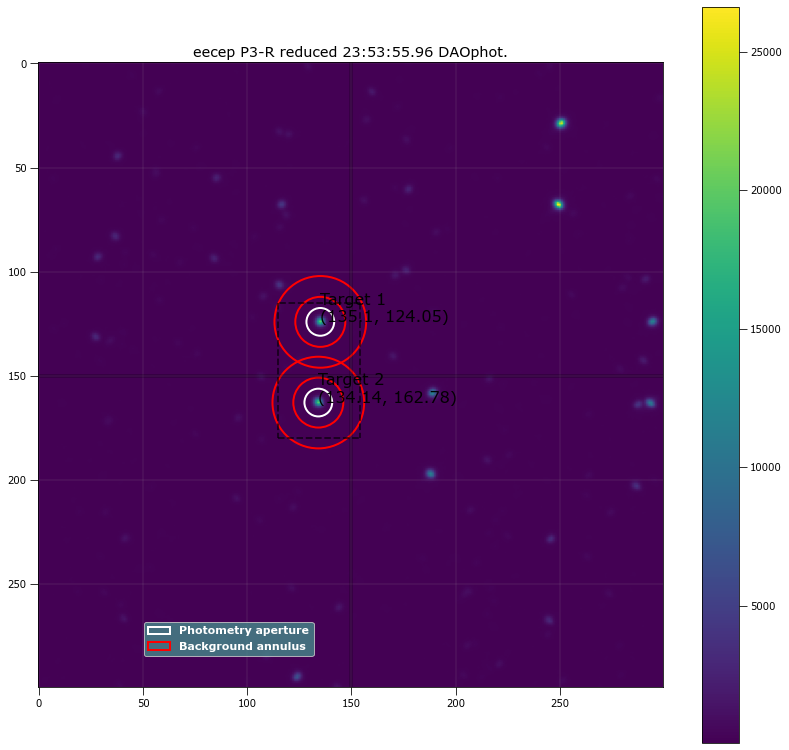

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 135.09785 124.05328 ...          4945.6176      131206.26          438.22486
  2 134.14137 162.78413 ...          4827.3281      132495.09          442.79231

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 135.09785 124.05328 ...                 4888.4595             250407.56
  2 134.14137 162.78413 ...                 4769.5742             241644.95

Write this out the excel
331 23:53:55.96 P3-R 20.0 6.659322033898305 135.09784849907695 124.05327993842768 250407.56124106515 4888.459461660245 13

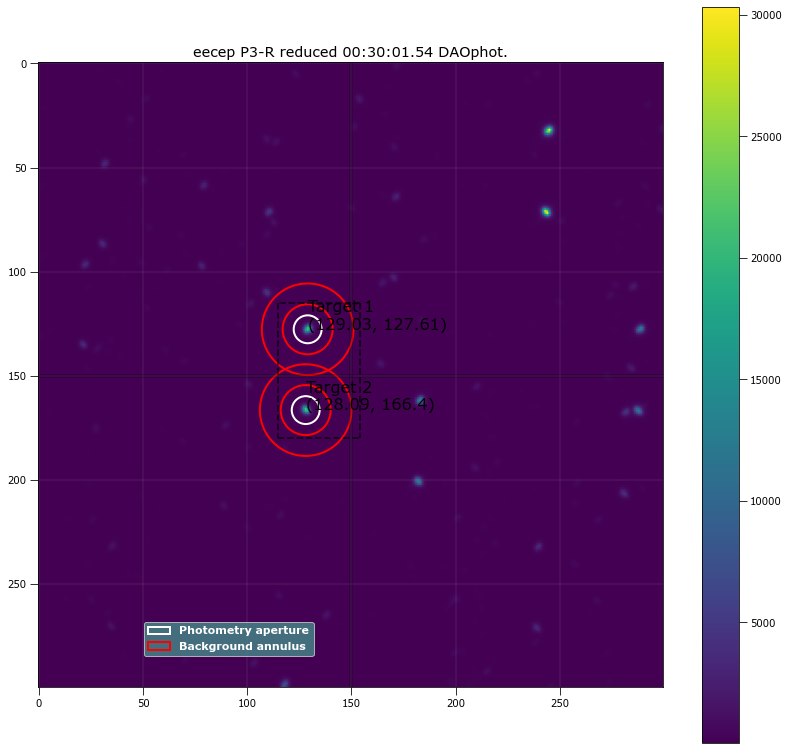

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.02578 127.61367 ...          5379.0346      121584.72          420.88407
  2 128.08735  166.4001 ...          5273.5961      122459.21          422.50505

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.02578 127.61367 ...                 5323.5148             255477.16
  2 128.08735  166.4001 ...                 5217.8624             245881.17

Write this out the excel
332 00:30:01.54 P3-R 20.0 6.697033898305085 129.02578468164523 127.61366849778064 255477.15522176836 5323.514757684798 

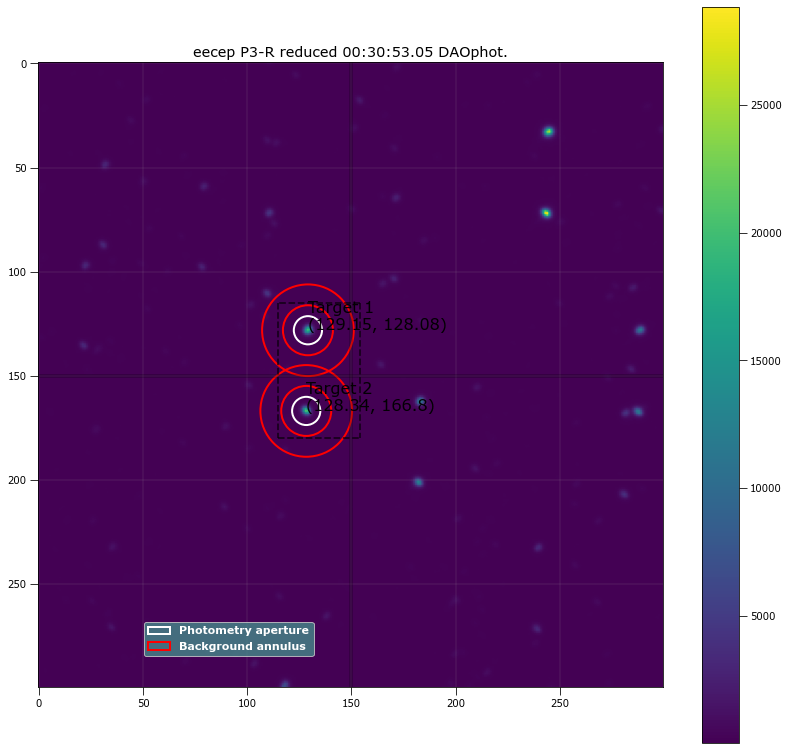

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.15422 128.07616 ...          5054.3762      121684.24          416.45371
  2  128.3354 166.80455 ...          5055.5753      122374.56          415.99122

 Aperture are: 144.0928613968168 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.15422 128.07616 ...                 4998.1963             254502.08
  2  128.3354 166.80455 ...                 4999.4579             244679.19

Write this out the excel
333 00:30:53.05 P3-R 20.0 6.772457627118643 129.15422025549609 128.0761585314953 254502.08318157843 4998.196349572844 12

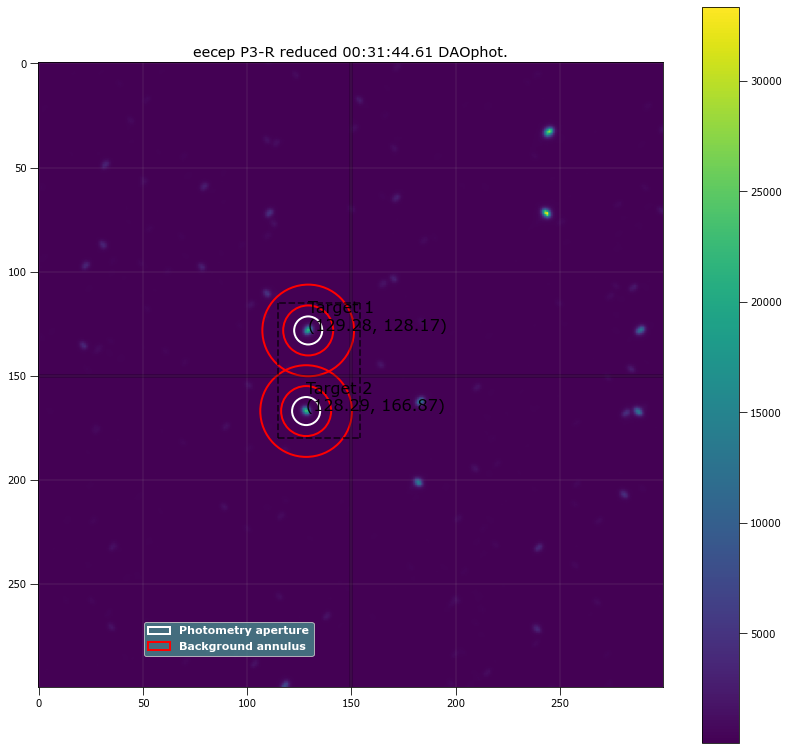

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.28025 128.16986 ...          5463.4174      121236.49          418.45684
  2 128.28788 166.86904 ...           5458.957      122073.67          424.22823

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.28025 128.16986 ...                 5407.5943             257671.04
  2 128.28788 166.86904 ...                 5402.3639             248586.19

Write this out the excel
334 00:31:44.61 P3-R 20.0 6.734745762711864 129.2802474736752 128.16985841452114 257671.04447818274 5407.594270605839 12

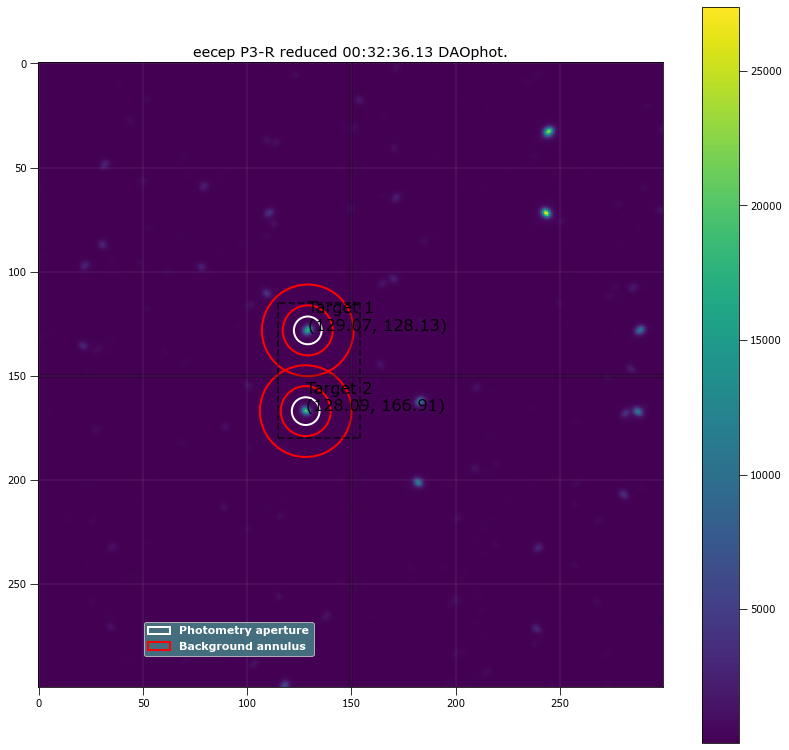

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.07458 128.13309 ...          4743.3576      121981.21           409.7432
  2 128.08892 166.90689 ...          4858.1022      122620.53          412.34075

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.07458 128.13309 ...                 4689.9143             253445.71
  2 128.08892 166.90689 ...                 4804.3201             245446.53

Write this out the excel
335 00:32:36.13 P3-R 20.0 6.659322033898305 129.0745813068773 128.13309359593566 253445.71023923412 4689.914331929141 128

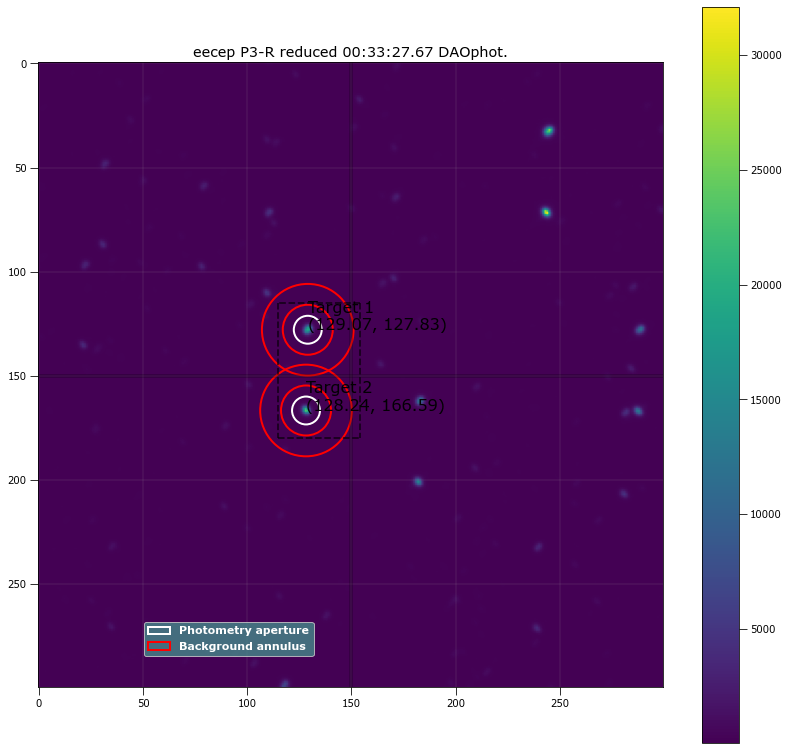

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.07467 127.83338 ...          5152.0164      121545.45          418.65948
  2 128.23576 166.59408 ...           5387.091      122275.15          420.54886

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.07467 127.83338 ...                 5096.7899             255704.49
  2 128.23576 166.59408 ...                 5331.6153             247100.85

Write this out the excel
336 00:33:27.67 P3-R 20.0 6.697033898305085 129.07467366602202 127.83338065124258 255704.49105494577 5096.789946135928 

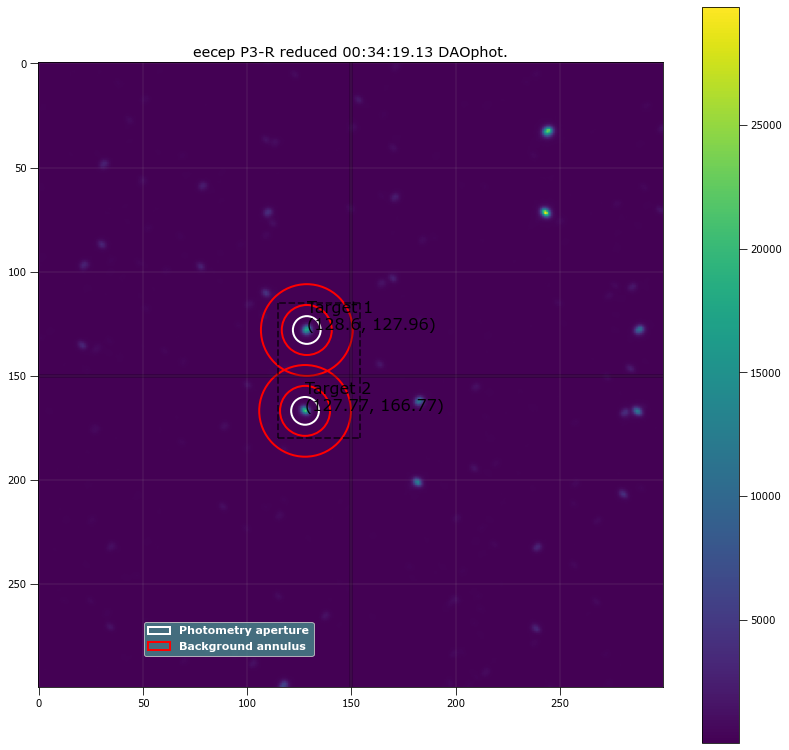

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.59998 127.95839 ...          4869.9464      120678.18           411.3471
  2 127.77434 166.77438 ...          5045.4786      121106.92           410.9162

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.59998 127.95839 ...                 4816.2939             253424.77
  2 127.77434 166.77438 ...                 4991.8824             245648.79

Write this out the excel
337 00:34:19.13 P3-R 20.0 6.659322033898304 128.59997769228767 127.95839469446712 253424.77296343067 4816.293930690259 

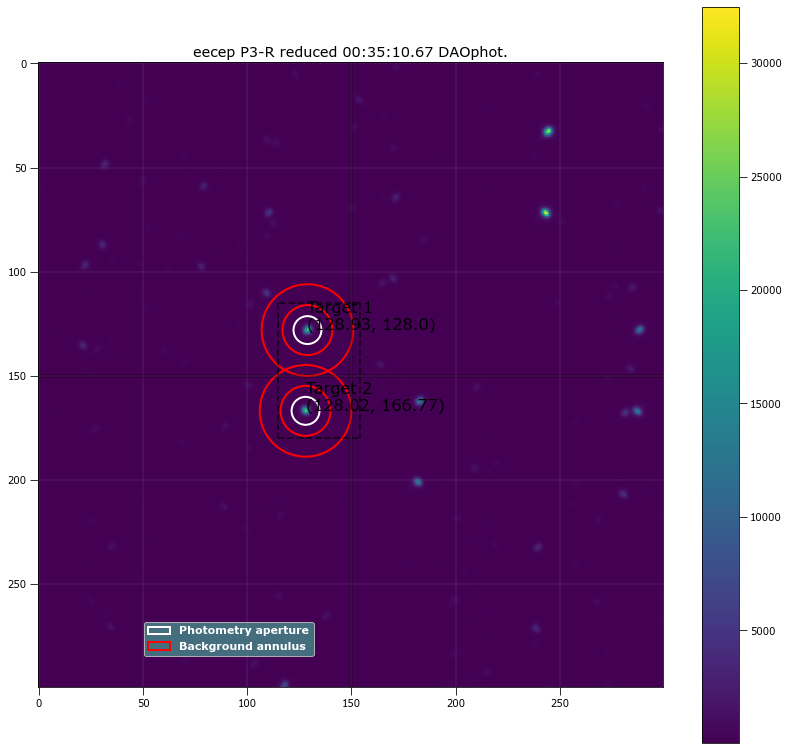

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.93098 127.99834 ...           5478.248       120743.5          420.48152
  2 128.01781  166.7651 ...          5501.0951      122371.52          424.22125

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.93098 127.99834 ...                 5422.7813             255511.67
  2 128.01781  166.7651 ...                  5445.135             246577.94

Write this out the excel
338 00:35:10.67 P3-R 20.0 6.697033898305085 128.930984644962 127.99833984261801 255511.67048606745 5422.781264814278 12

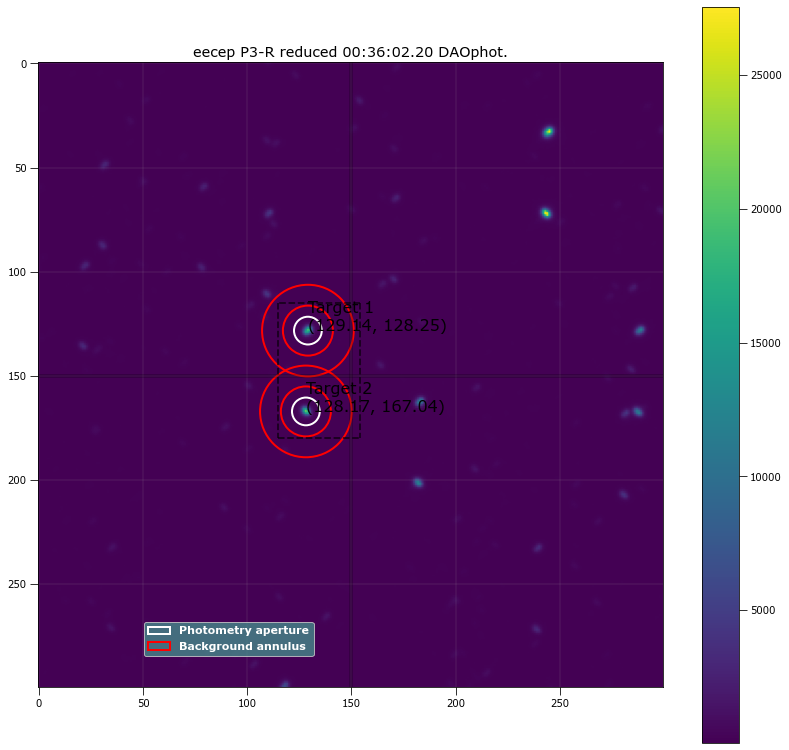

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.14054 128.25091 ...          5001.3834      120577.87          409.95173
  2 128.17252 167.04269 ...          5054.4625      121604.51          416.23105

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.14054 128.25091 ...                  4947.913             252663.17
  2 128.17252 167.04269 ...                  5000.173             245684.46

Write this out the excel
339 00:36:02.20 P3-R 20.0 6.659322033898304 129.14053539221547 128.2509074220631 252663.1688744957 4947.912977580077 12

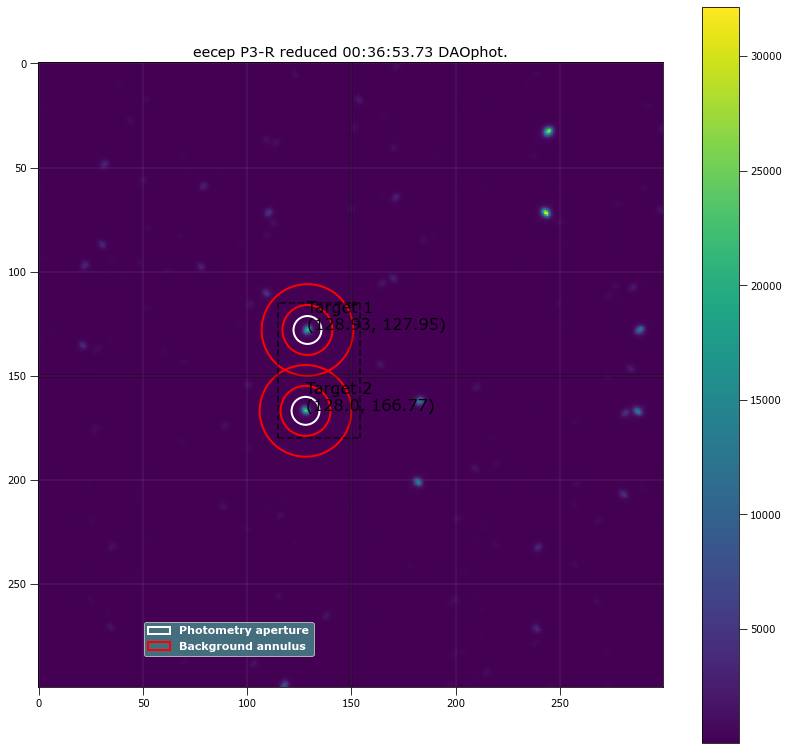

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.92897    127.95 ...          5406.1701      120136.44          415.75184
  2 128.00365 166.76731 ...          5483.2161      120676.94          417.68012

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.92897    127.95 ...                 5351.3272             255241.44
  2 128.00365 166.76731 ...                 5428.1189              247385.1

Write this out the excel
340 00:36:53.73 P3-R 20.0 6.697033898305085 128.9289687276317 127.94999903963938 255241.4404536486 5351.327190298164 12

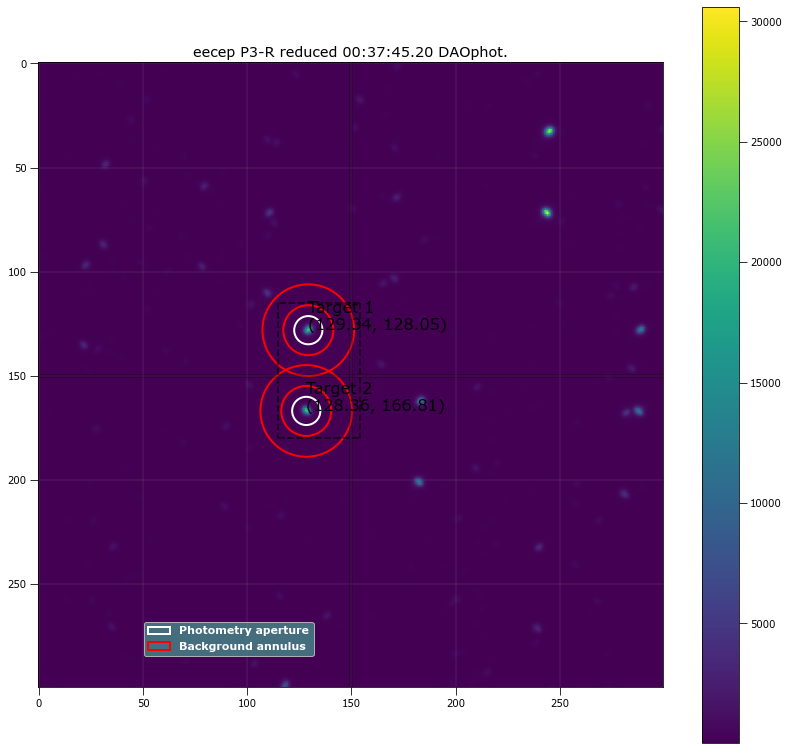

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.33856 128.04667 ...          5301.1684      119525.92          413.25898
  2 128.35559  166.8056 ...          5211.5722      120281.59          414.44833

 Aperture are: 144.0928613968168 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.33856 128.04667 ...                 5245.4196             254911.15
  2 128.35559  166.8056 ...                 5155.6629             247074.38

Write this out the excel
341 00:37:45.20 P3-R 20.0 6.772457627118643 129.3385617297523 128.0466653930688 254911.15010181486 5245.419554148161 128

In [15]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P3-R Filter")

res_apt_sum_list = []

start = 291
end = 342 #So this things sets a new filename for a new file...
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [35, 30, 35, 4]
#Fit variations
#3 to 7
#4.5 to 8
#5 to 8.5

for k in range(start, end ):
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[k]),
                                        [512, 512, 512, 512], 
                                        (m_biast, m_dark, p_3_m_flat), 
                                        False, True, False)

    trial_radii = np.linspace(5, 9.45, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:
        #Find the position
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search, 
                                                          2000, search_off, radii, 12 , 22, False, False)
        
        if (len(DAO_positions) != 2):
            x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj, 4,search_bracket, 3200 , False, False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]
    
    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions,good_radii, 12 , 22, True, False)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'], #Thats a bug bro
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]] #It writes by wrow
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close()

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])

In [ ]:
#Write a program where if directory does not exist... Create one.

In [ ]:
#Duplicate

P3-R Filter


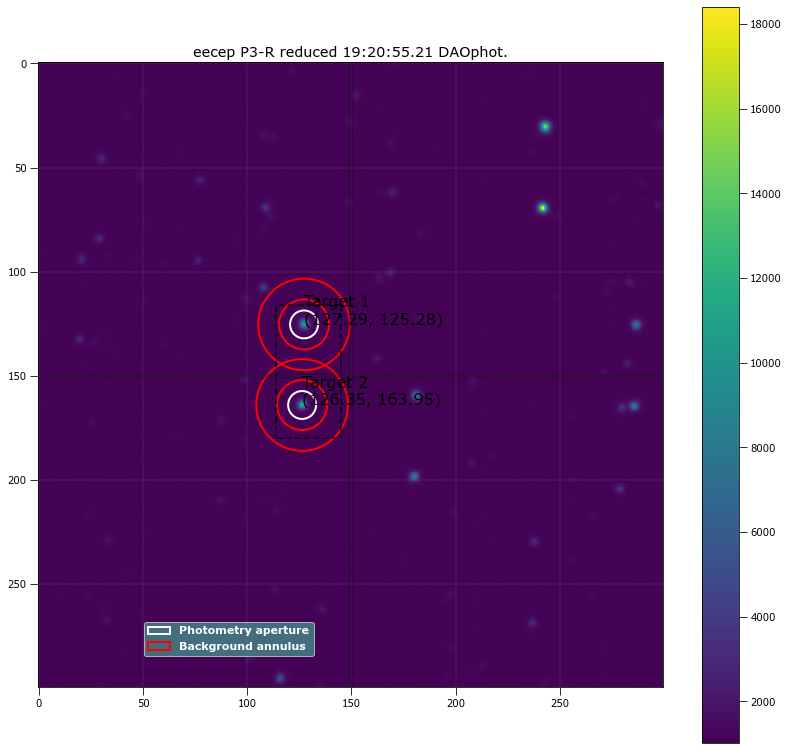

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.28859 125.27968 ...          3571.4097      1230057.5          3766.4605
  2 126.35451 163.95194 ...           3631.448      1228906.5          3762.9034

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.28859 125.27968 ...                 3074.7549             153600.94
  2 126.35451 163.95194 ...                 3135.2623             148942.75

Write this out the excel
398 19:20:55.21 P3-R 20.0 6.695762711864406 127.28859469295783 125.27968065487946 153600.94374856655 3074.754920131827 1

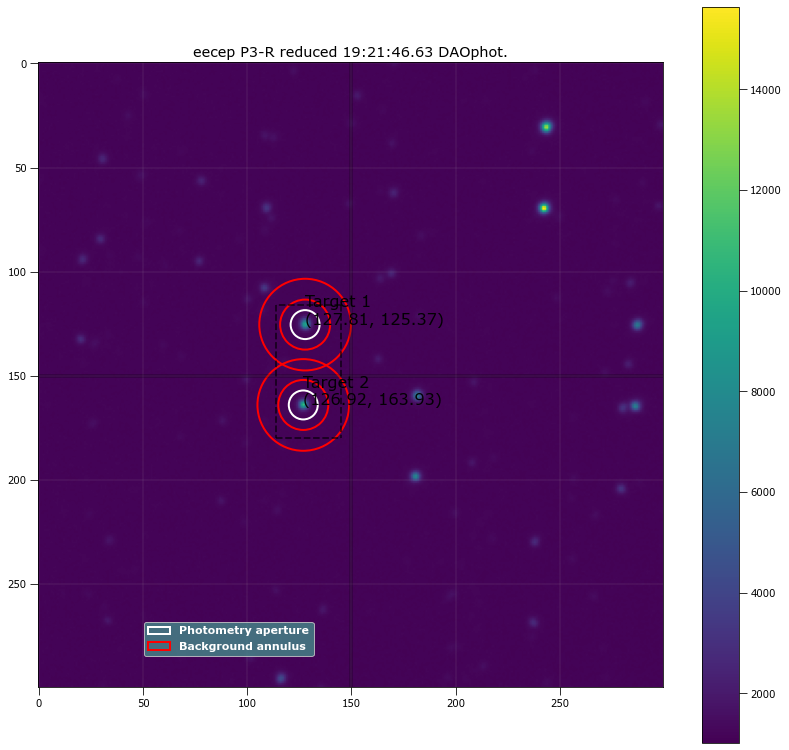

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.8052 125.36838 ...          3404.3278      1232173.8          3772.8236
  2 126.92348 163.93446 ...           3429.751      1230893.2          3768.6813

 Aperture are: 151.91335587324707 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.8052 125.36838 ...                 2867.7489             151519.02
  2 126.92348 163.93446 ...                 2893.7611             146465.45

Write this out the excel
399 19:21:46.63 P3-R 20.0 6.953813559322033 127.80519527704065 125.36837872957108 151519.023403306 2867.7488541692946 1

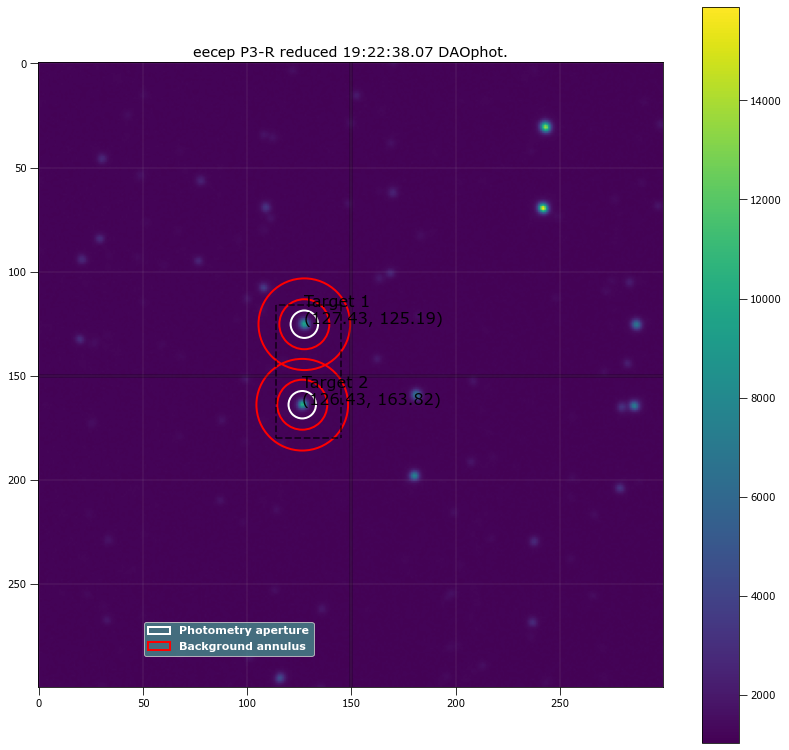

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.43388 125.18524 ...          3389.4012        1237089          3787.8793
  2 126.43178 163.82191 ...          3398.7932      1233972.6          3778.1802

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.43388 125.18524 ...                 2906.2856             150624.91
  2 126.43178 163.82191 ...                 2916.9145             145673.48

Write this out the excel
400 19:22:38.07 P3-R 20.0 6.5851694915254235 127.43387707438671 125.18524379302707 150624.90523989536 2906.285564332398

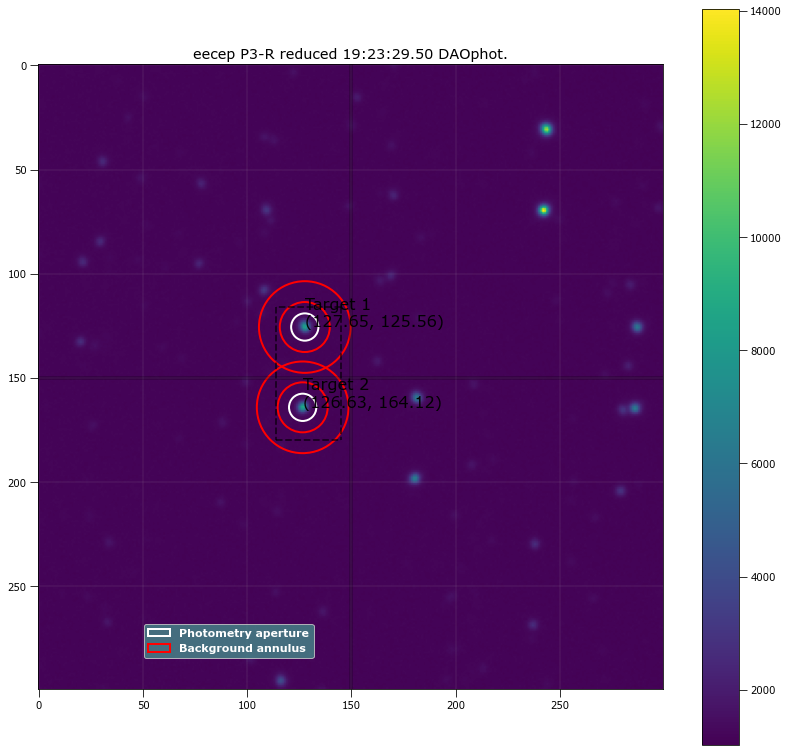

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.64873 125.56485 ...           3237.811      1235820.5          3783.7051
  2 126.63105 164.11532 ...          3227.7421      1236379.1          3785.3794

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.64873 125.56485 ...                 2760.6157             148203.24
  2 126.63105 164.11532 ...                 2750.3356             143222.18

Write this out the excel
401 19:23:29.50 P3-R 20.0 6.5483050847457624 127.64873077225256 125.5648524079215 148203.24246226982 2760.6156961397555

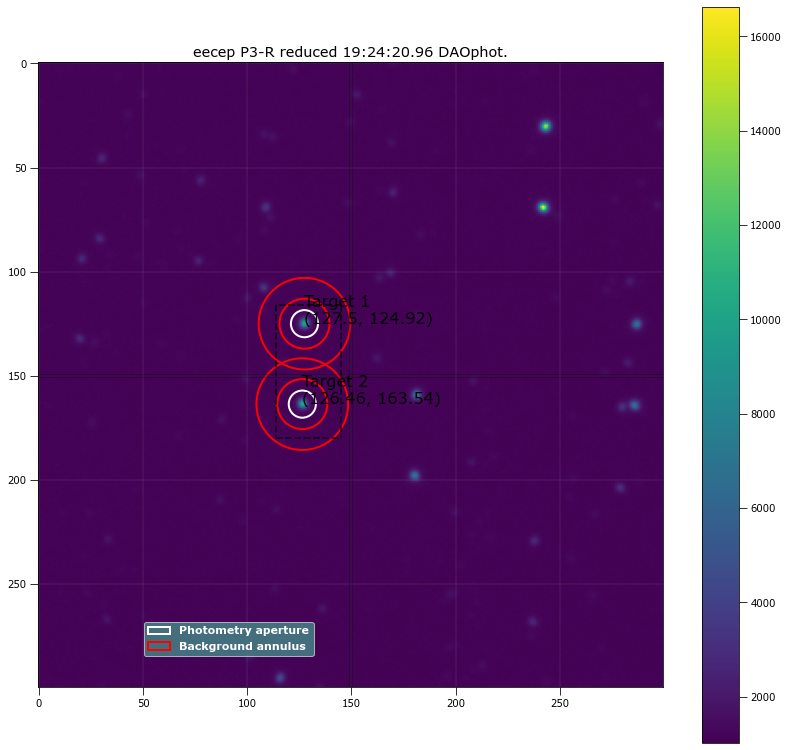

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.50007 124.92492 ...          3460.0935      1233389.5          3776.3006
  2 126.45905 163.54256 ...          3428.5688      1235088.9          3781.6396

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.50007 124.92492 ...                 2989.1793             151124.39
  2 126.45905 163.54256 ...                 2956.9888             146597.97

Write this out the excel
402 19:24:20.96 P3-R 20.0 6.511440677966101 127.50007131227748 124.92491668474524 151124.3919920051 2989.179305824818 1

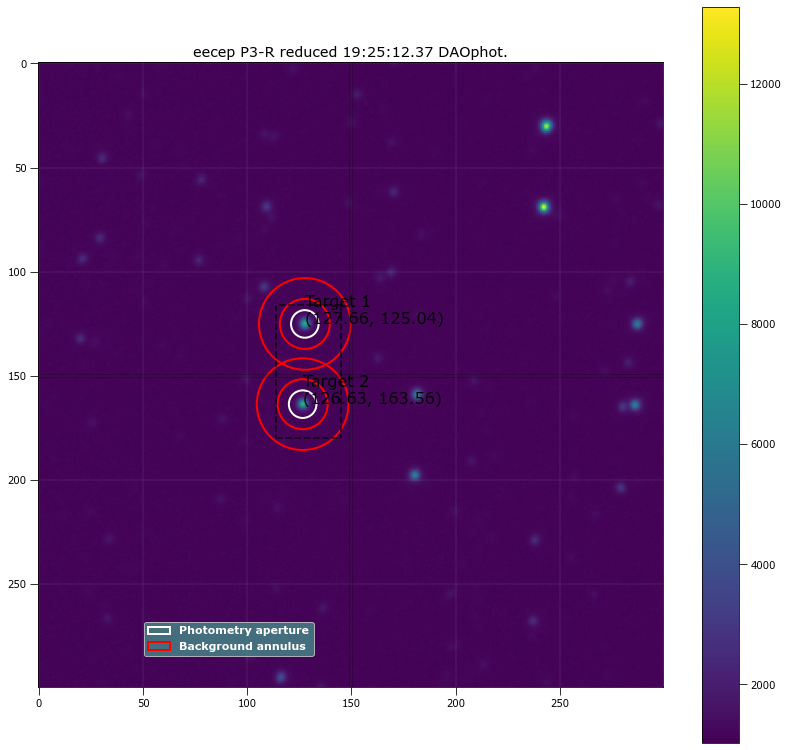

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.66288 125.04234 ...          3226.2774      1233717.7          3777.0683
  2 126.62989 163.56296 ...          3197.8427      1234262.7          3778.7956

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.66288 125.04234 ...                 2739.1319             146284.36
  2 126.62989 163.56296 ...                 2710.4744             141461.39

Write this out the excel
403 19:25:12.37 P3-R 20.0 6.622033898305084 127.66288238042739 125.0423357915128 146284.36482253188 2739.1319006566314 

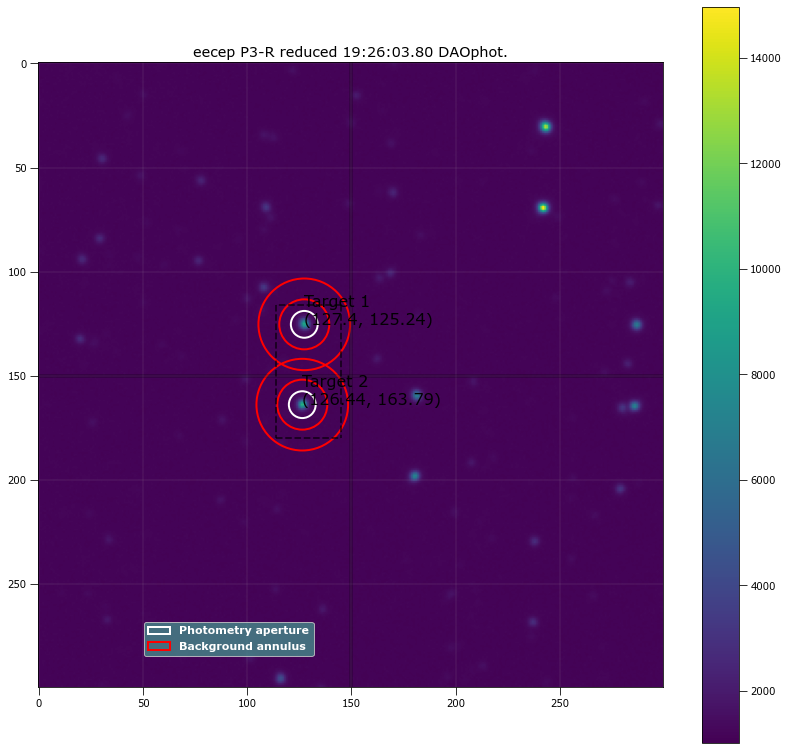

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.40136 125.23898 ...          3320.6462      1233440.6          3776.5857
  2 126.44407 163.79463 ...          3318.9961      1232893.1          3774.7533

 Aperture are: 130.20058706311798 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.40136 125.23898 ...                 2860.3011             147866.18
  2 126.44407 163.79463 ...                 2858.8744             142841.48

Write this out the excel
404 19:26:03.80 P3-R 20.0 6.437711864406779 127.40135506163571 125.23897765594434 147866.17808264773 2860.3010863729996

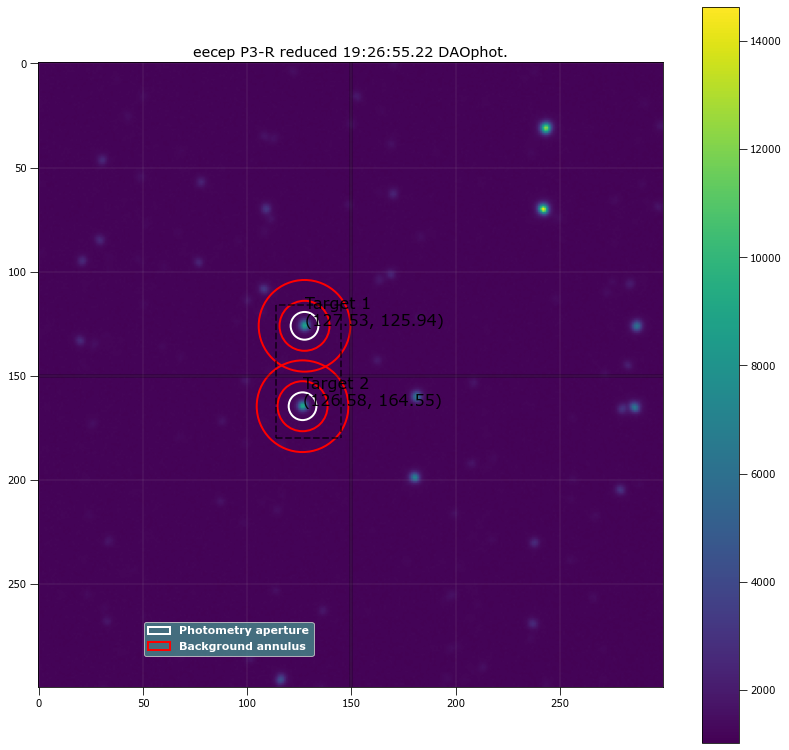

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.52647 125.94372 ...           3253.091      1234402.8          3779.2844
  2 126.57662 164.54546 ...          3234.0724      1234601.8          3779.8057

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.52647 125.94372 ...                 2760.2175             145861.68
  2 126.57662 164.54546 ...                 2741.1309              141248.3

Write this out the excel
405 19:26:55.22 P3-R 20.0 6.658898305084746 127.5264682600705 125.94372334492468 145861.68275150305 2760.2175484347135 

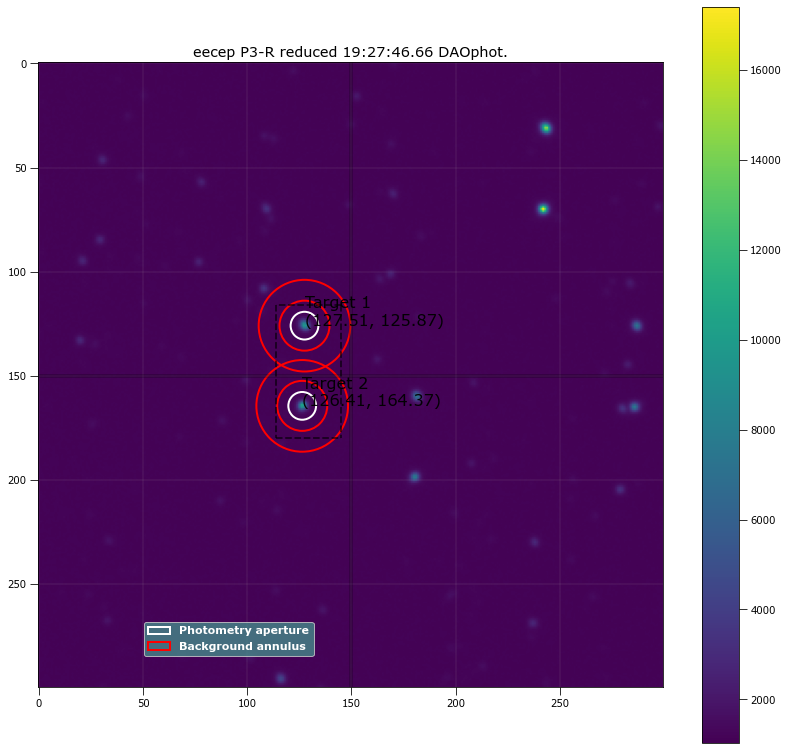

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51334 125.87129 ...          3378.2437      1233672.9          3777.2059
  2 126.40805  164.3744 ...          3402.2256      1236365.9          3785.3903

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51334 125.87129 ...                 2885.6413              148357.8
  2 126.40805  164.3744 ...                 2908.5558             143384.42

Write this out the excel
406 19:27:46.66 P3-R 20.0 6.658898305084746 127.51333804857921 125.87129163494384 148357.79714183894 2885.6413499589235

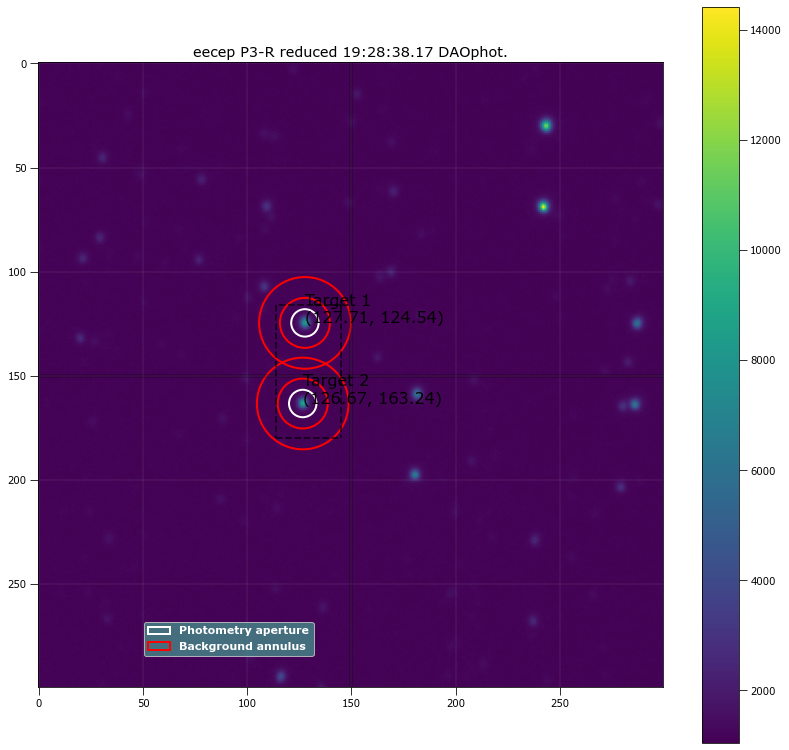

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.71364 124.54244 ...           3180.991      1240556.4           3797.897
  2 126.66751 163.24021 ...          3207.3439      1241858.3          3801.9744

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.71364 124.54244 ...                 2696.5976             144525.87
  2 126.66751 163.24021 ...                 2722.4305             140814.94

Write this out the excel
407 19:28:38.17 P3-R 20.0 6.5851694915254235 127.71364481116893 124.54244333202982 144525.86705008408 2696.597625167823

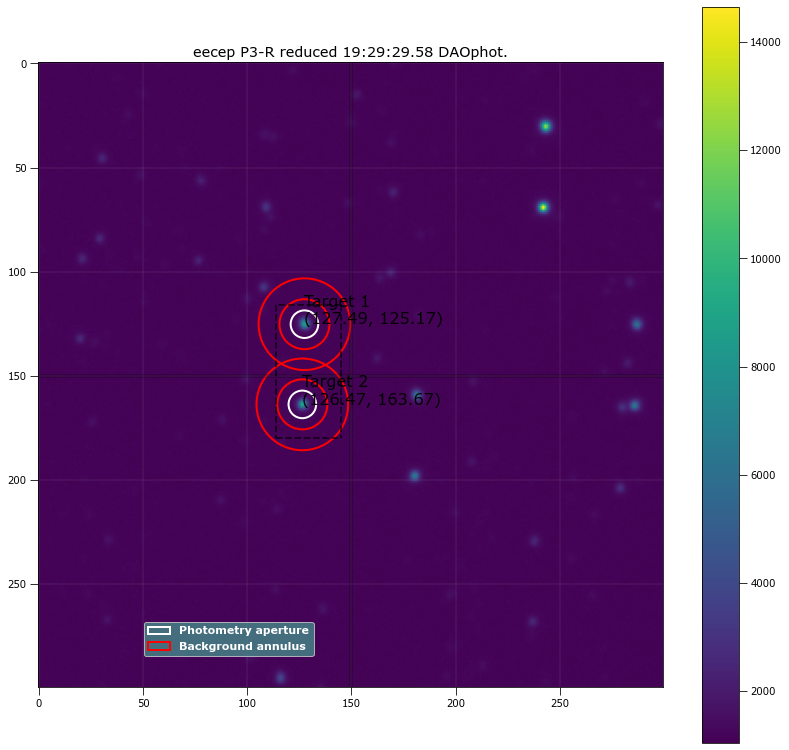

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.48869 125.17035 ...          3232.1152      1239832.2          3795.8435
  2 126.47308   163.668 ...          3240.0237      1242903.6          3805.1835

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.48869 125.17035 ...                 2742.5482             147021.83
  2 126.47308   163.668 ...                  2749.252             142220.27

Write this out the excel
408 19:29:29.58 P3-R 20.0 6.622033898305085 127.48868732336256 125.17035332208158 147021.83265072104 2742.5481892957155

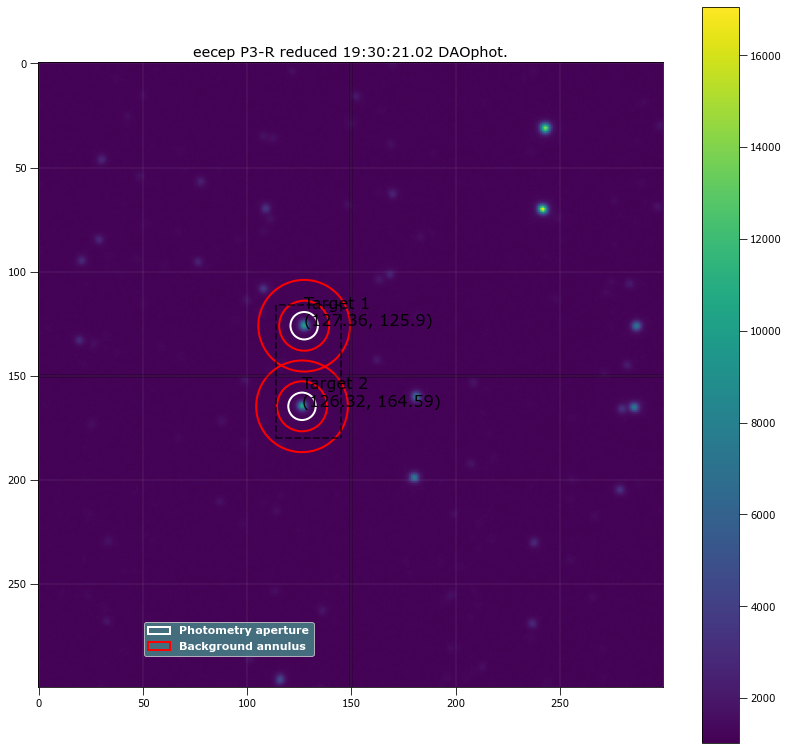

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.35774 125.90192 ...          3432.7041      1242601.9          3804.6456
  2 126.31624 164.58727 ...          3445.2531      1245528.6          3813.4099

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.35774 125.90192 ...                   2947.45             149488.38
  2 126.31624 164.58727 ...                 2958.8812             144172.99

Write this out the excel
409 19:30:21.02 P3-R 20.0 6.5851694915254235 127.35773512210449 125.90192242961179 149488.37566390648 2947.450004664455

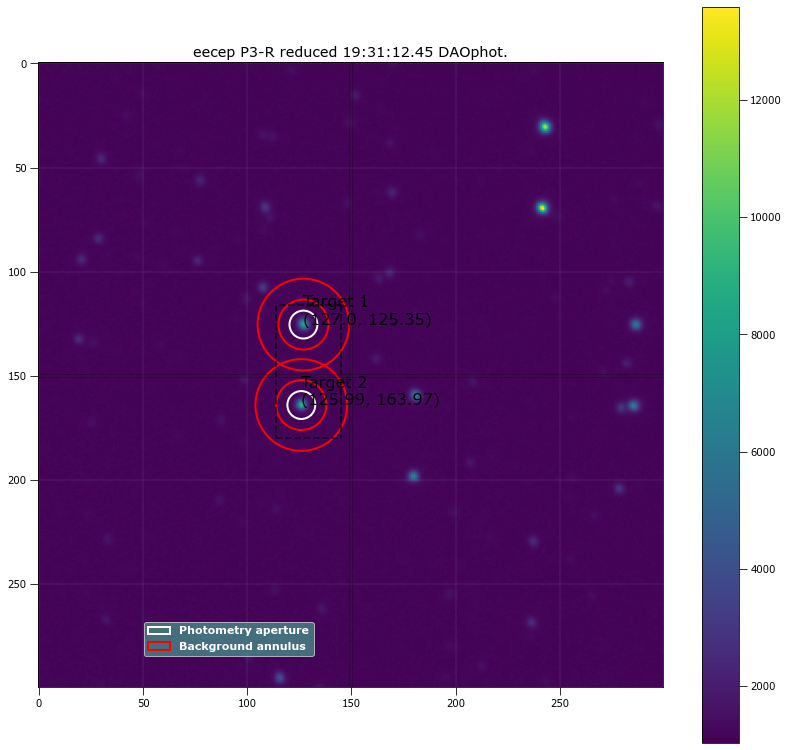

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.00496 125.35151 ...          3265.9602        1247267            3818.62
  2 125.98503 163.96998 ...          3295.1666      1249151.3          3824.3289

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.00496 125.35151 ...                 2762.4276             148664.65
  2 125.98503 163.96998 ...                 2790.8812             143688.45

Write this out the excel
410 19:31:12.45 P3-R 20.0 6.695762711864407 127.0049592374087 125.35151299708656 148664.6501082345 2762.4275879930606 1

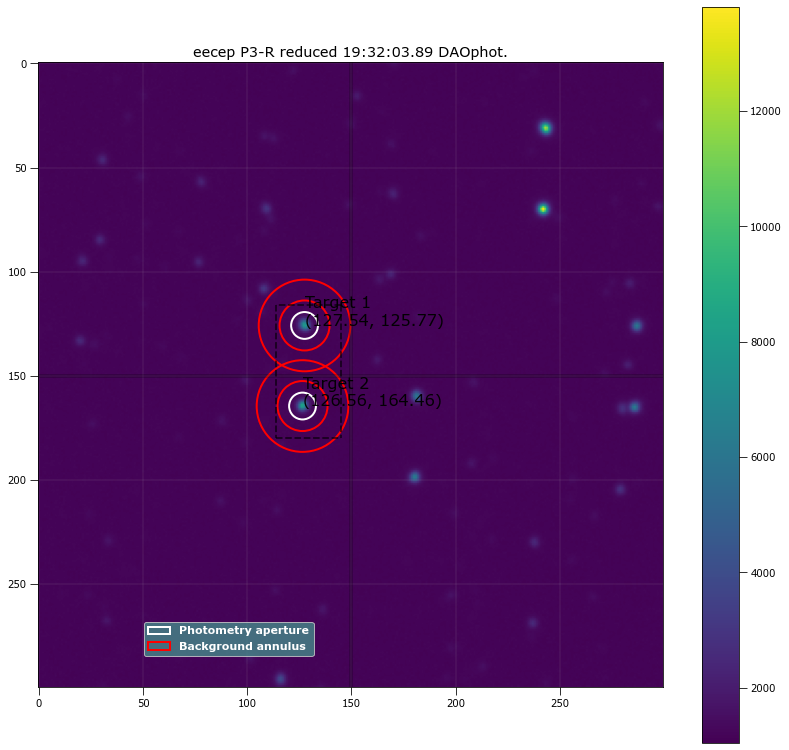

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.53651 125.77456 ...          3152.0832      1246192.2          3815.3125
  2 126.56367 164.45611 ...          3154.8298      1245641.3          3813.5603

 Aperture are: 130.20058706311798 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.53651 125.77456 ...                 2687.0176             145456.93
  2 126.56367 164.45611 ...                 2689.9778             140569.89

Write this out the excel
411 19:32:03.89 P3-R 20.0 6.437711864406779 127.53651221416017 125.77456097341377 145456.92572541063 2687.0175693868255

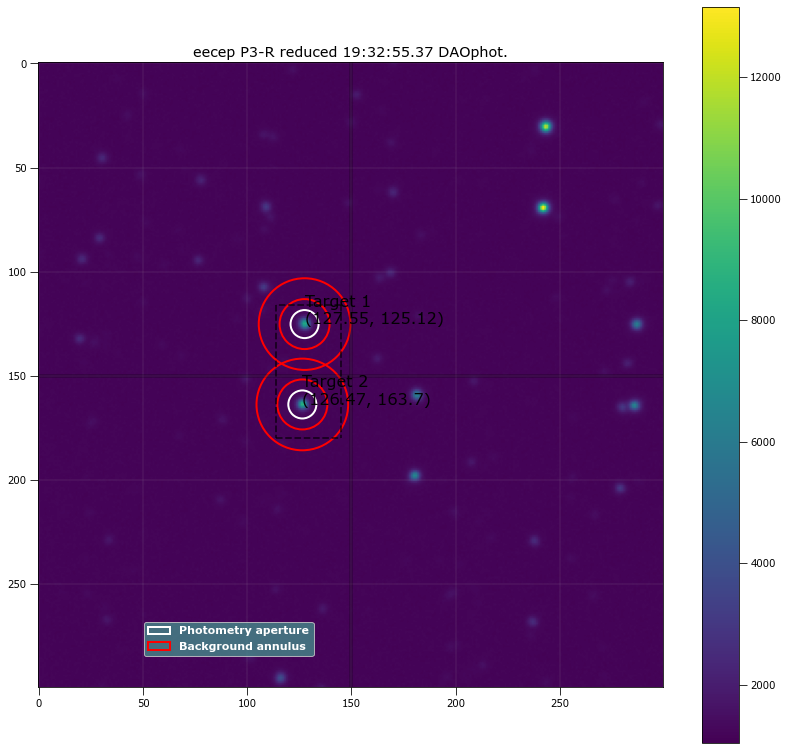

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.54971 125.11688 ...          3258.5418      1250579.1          3828.5387
  2 126.47452 163.70039 ...          3255.5607        1251777          3832.2074

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.54971 125.11688 ...                  2748.127             149231.52
  2 126.47452 163.70039 ...                 2744.6568             144739.09

Write this out the excel
412 19:32:55.37 P3-R 20.0 6.732627118644068 127.54971106964875 125.11688257172166 149231.51713977454 2748.1270284243087 

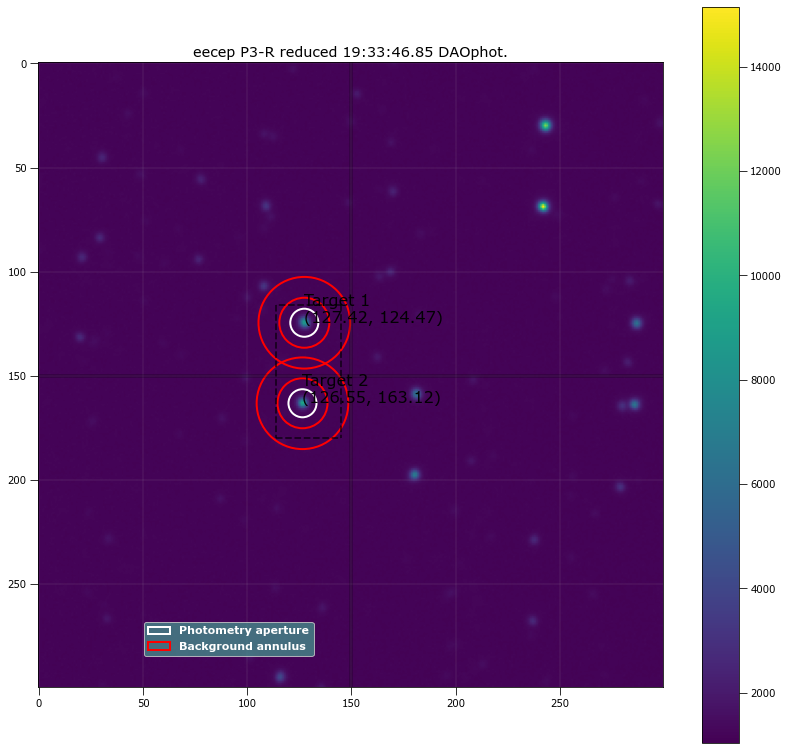

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.4244 124.47277 ...          3309.7035      1257081.7          3848.5941
  2 126.54651 163.12281 ...           3318.912      1255790.6          3844.7258

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.4244 124.47277 ...                 2796.6149             149813.96
  2 126.54651 163.12281 ...                 2806.3392             144770.69

Write this out the excel
413 19:33:46.85 P3-R 20.0 6.732627118644068 127.42440433970063 124.47276822453547 149813.95861061048 2796.6149446630902 

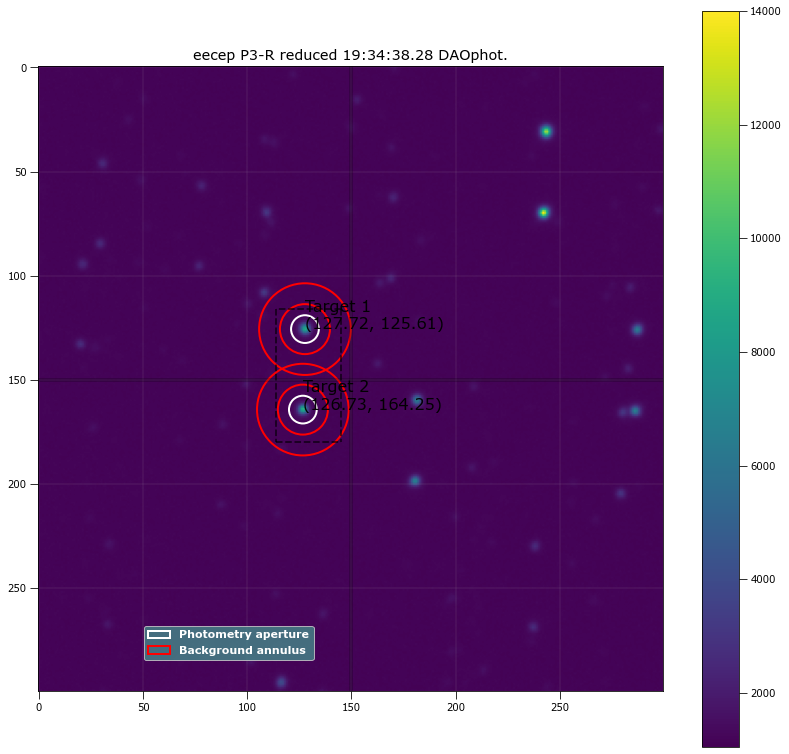

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.72391 125.60974 ...          3292.4718      1252922.7          3835.8654
  2 126.72554 164.24834 ...          3293.5105      1253310.6          3836.9945

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.72391 125.60974 ...                 2792.2194             148651.04
  2 126.72554 164.24834 ...                 2793.1109             144129.03

Write this out the excel
414 19:34:38.28 P3-R 20.0 6.658898305084746 127.7239125098352 125.6097406795291 148651.0411934106 2792.2193925928163 12

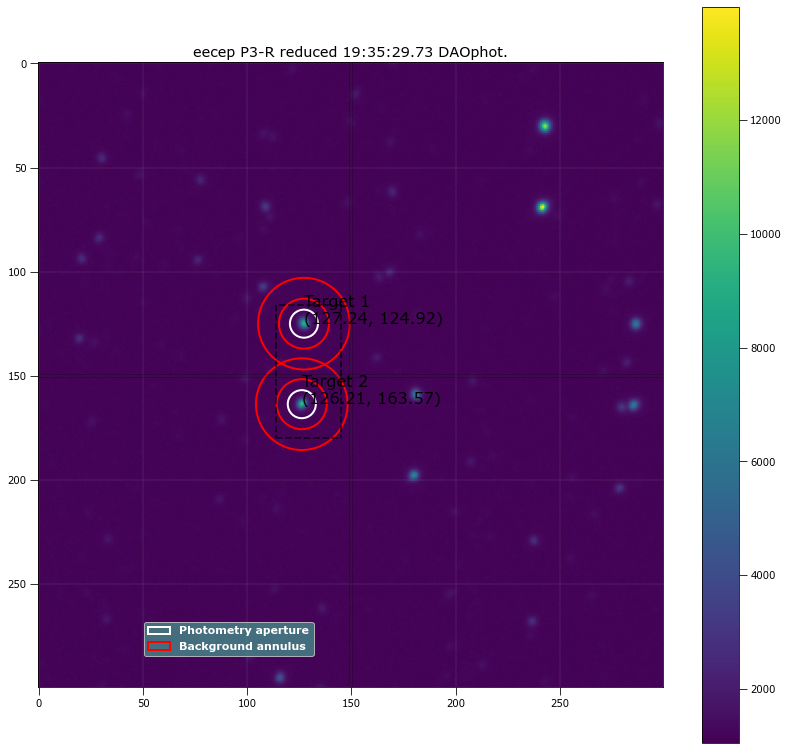

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.2405 124.91944 ...          3363.3916        1251775          3832.4254
  2 126.20813 163.56679 ...           3369.088      1254434.3          3840.5508

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.2405 124.91944 ...                 2852.4586             149828.74
  2 126.20813 163.56679 ...                 2857.0718             145309.95

Write this out the excel
415 19:35:29.73 P3-R 20.0 6.732627118644068 127.2404961959366 124.91943852285823 149828.73837223966 2852.4586098095233 1

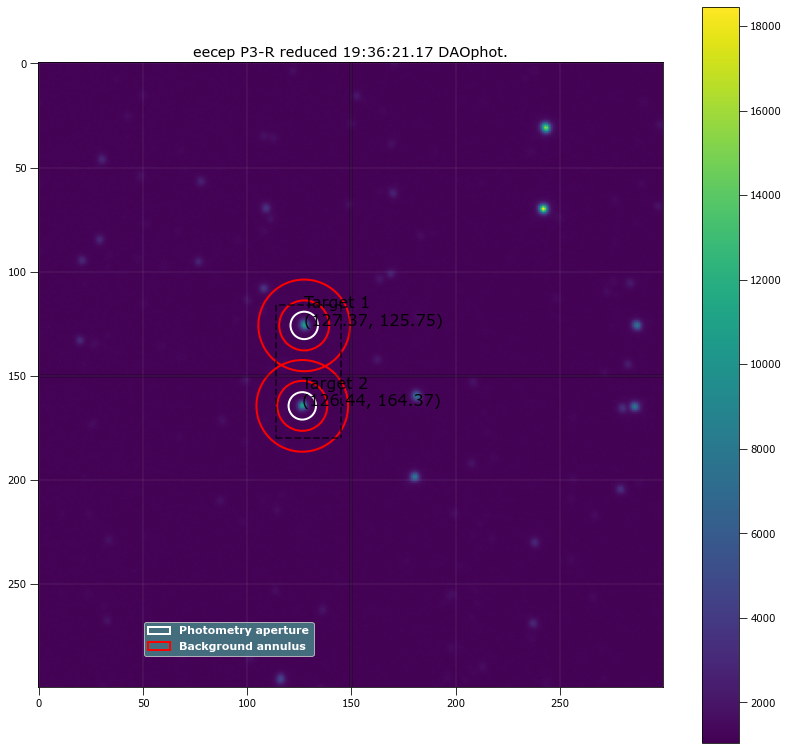

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.37389 125.75456 ...           3493.042      1255195.3          3843.3374
  2 126.44354 164.37105 ...          3511.9475      1256949.3          3848.4606

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.37389 125.75456 ...                  3002.853             147815.17
  2 126.44354 164.37105 ...                 3021.1051             143510.02

Write this out the excel
416 19:36:21.17 P3-R 20.0 6.5851694915254235 127.37388865995239 125.75456363822366 147815.16795367698 3002.85303630998 

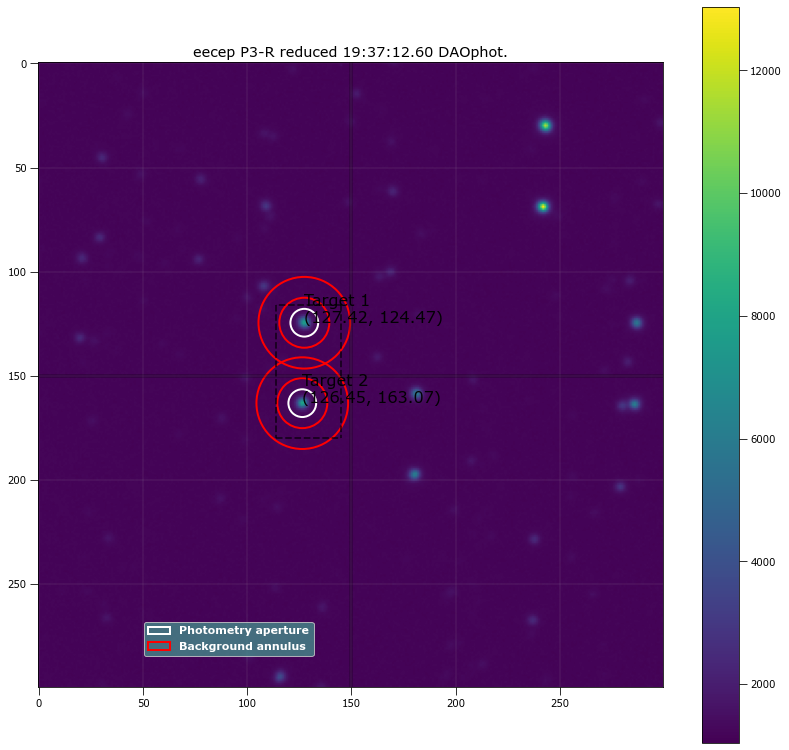

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.41903 124.46519 ...          3159.6571      1255450.5          3843.4816
  2 126.44556 163.07265 ...          3143.8012      1255458.9          3843.3384

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.41903 124.46519 ...                 2658.4114             146125.45
  2 126.44556 163.07265 ...                 2642.5741             141909.49

Write this out the excel
417 19:37:12.60 P3-R 20.0 6.658898305084746 127.41902656302125 124.46519128277211 146125.45173490516 2658.4114375435356

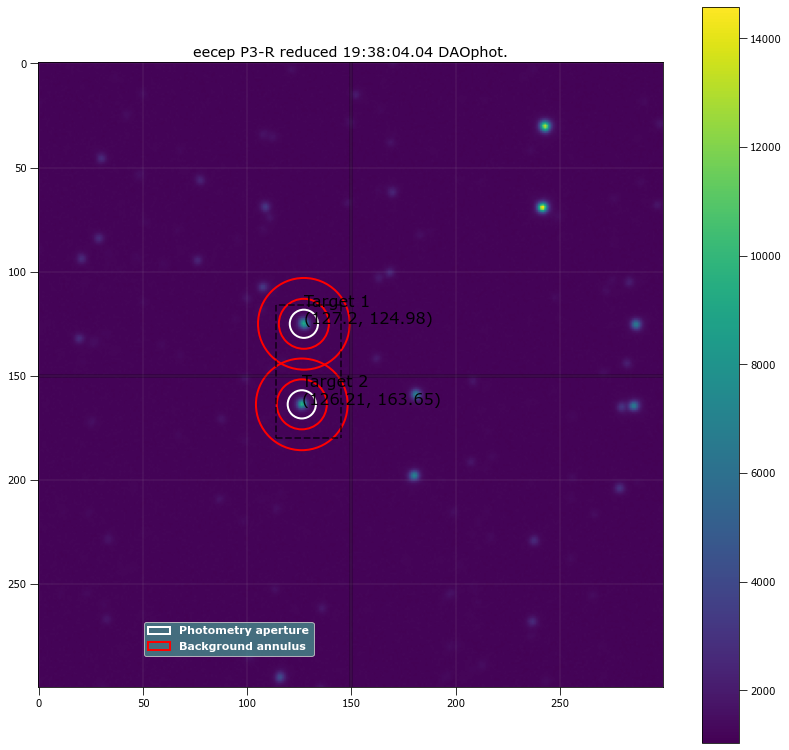

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.20481 124.97785 ...          3327.2903      1255572.8          3843.9698
  2 126.20763 163.65217 ...          3304.5997      1254962.5          3842.0985

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.20481 124.97785 ...                 2809.1909             148457.67
  2 126.20763 163.65217 ...                 2786.7524             143061.11

Write this out the excel
418 19:38:04.04 P3-R 20.0 6.769491525423728 127.20480705113657 124.9778522258469 148457.66559881184 2809.190870719818 1

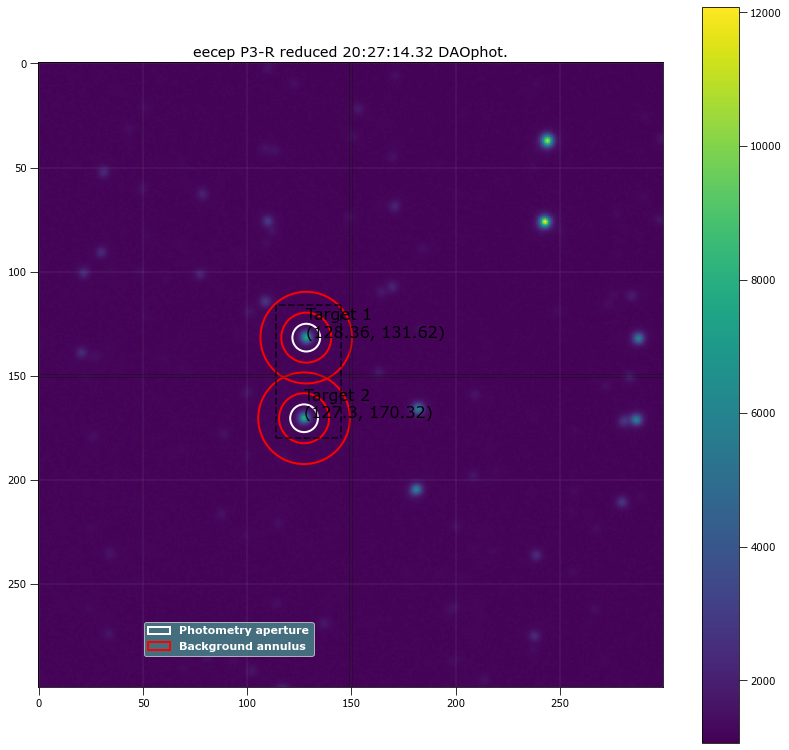

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.3589  131.6228 ...           3181.066      1271653.6          3893.0466
  2 127.30169 170.31797 ...          3183.7074      1273889.7          3899.8858

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.3589  131.6228 ...                 2673.3563             151987.09
  2 127.30169 170.31797 ...                 2675.1058             148307.79

Write this out the excel
419 20:27:14.32 P3-R 20.0 6.658898305084746 128.35890261724154 131.62279942500268 151987.08999491745 2673.3563033819 12

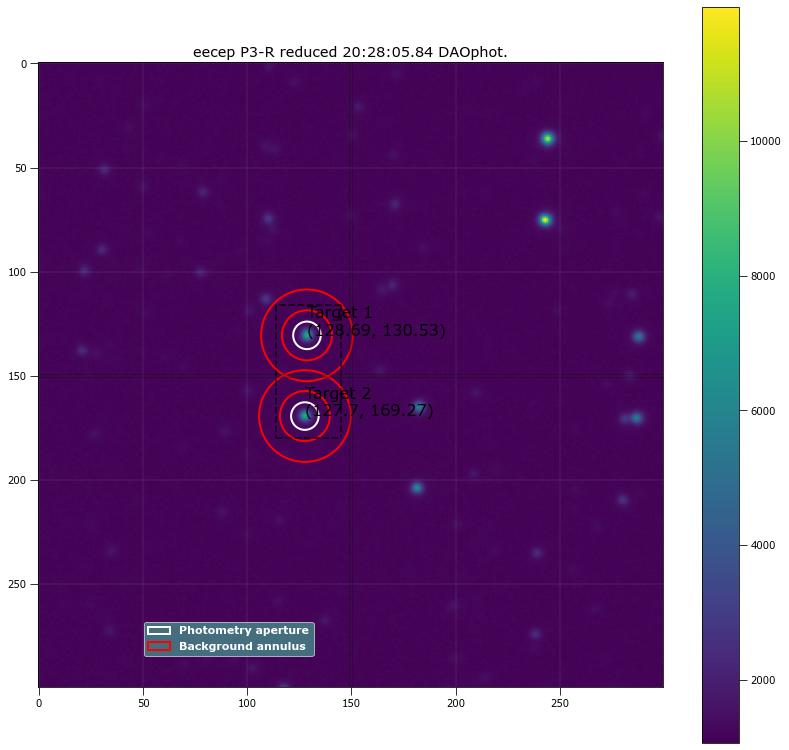

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.69426  130.5284 ...          3201.6919      1268075.8          3882.0776
  2 127.69721 169.27073 ...          3189.6976      1269522.5          3886.4992

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.69426  130.5284 ...                 2701.0028             151723.47
  2 127.69721 169.27073 ...                 2688.4383             148128.61

Write this out the excel
420 20:28:05.84 P3-R 20.0 6.622033898305085 128.69425616579497 130.52839522384411 151723.47386387974 2701.0027940132945

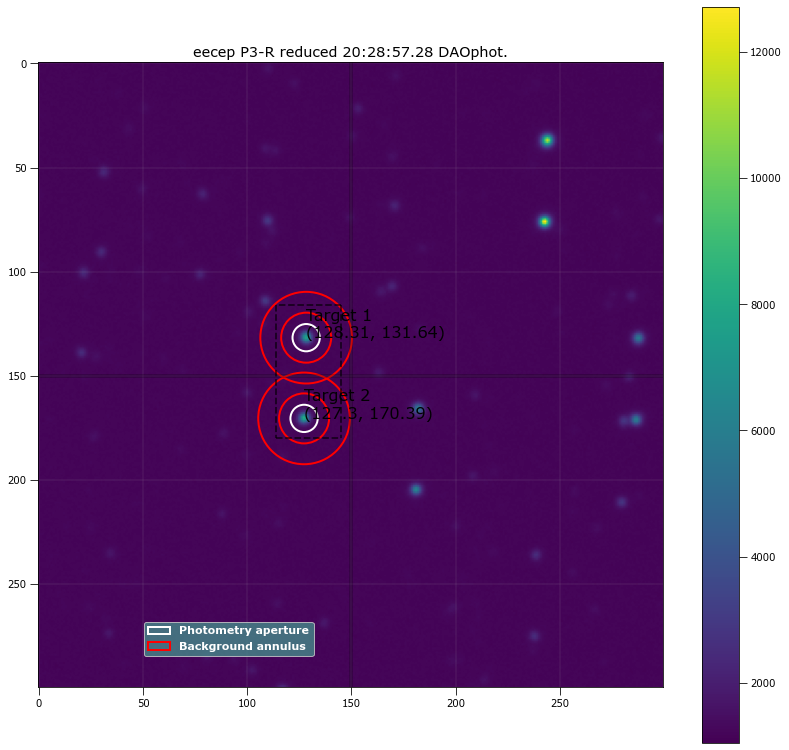

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.3103 131.63721 ...           3208.436      1269710.9          3887.1728
  2 127.30381 170.38989 ...          3215.6089      1271585.7           3892.753

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.3103 131.63721 ...                 2718.1915             151473.65
  2 127.30381 170.38989 ...                 2724.6606             148227.87

Write this out the excel
421 20:28:57.28 P3-R 20.0 6.5483050847457624 128.3102961510023 131.637209321361 151473.65063833317 2718.1915114150097 1

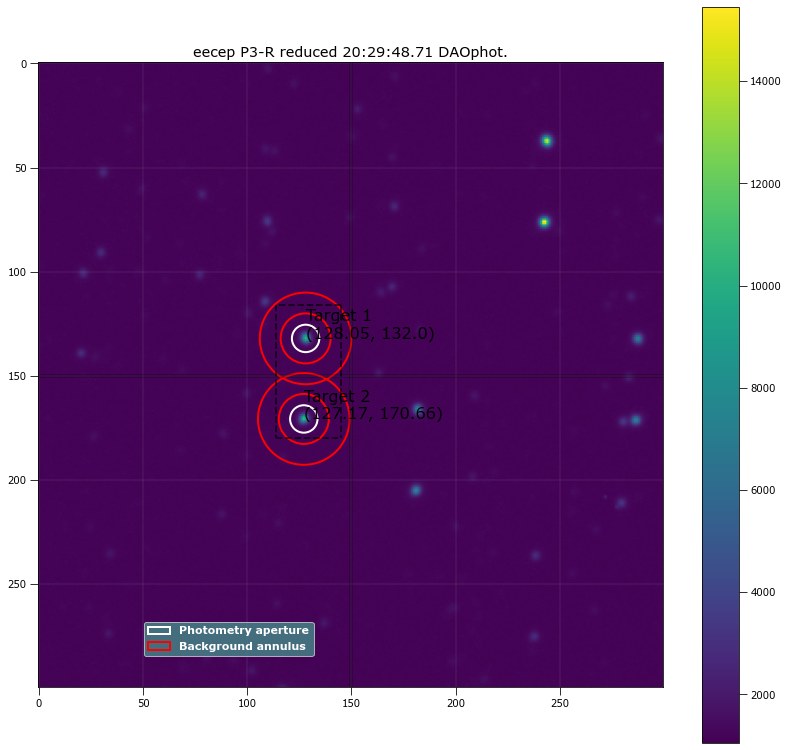

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.05144  131.9962 ...          3476.1305      1264996.7          3872.9951
  2 127.17338 170.65896 ...          3489.1854      1265378.6          3874.1841

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.05144  131.9962 ...                 2982.1589              153216.8
  2 127.17338 170.65896 ...                 2995.0622             149189.69

Write this out the excel
422 20:29:48.71 P3-R 20.0 6.5851694915254235 128.05144326760785 131.99619795639512 153216.79597836814 2982.158900635116

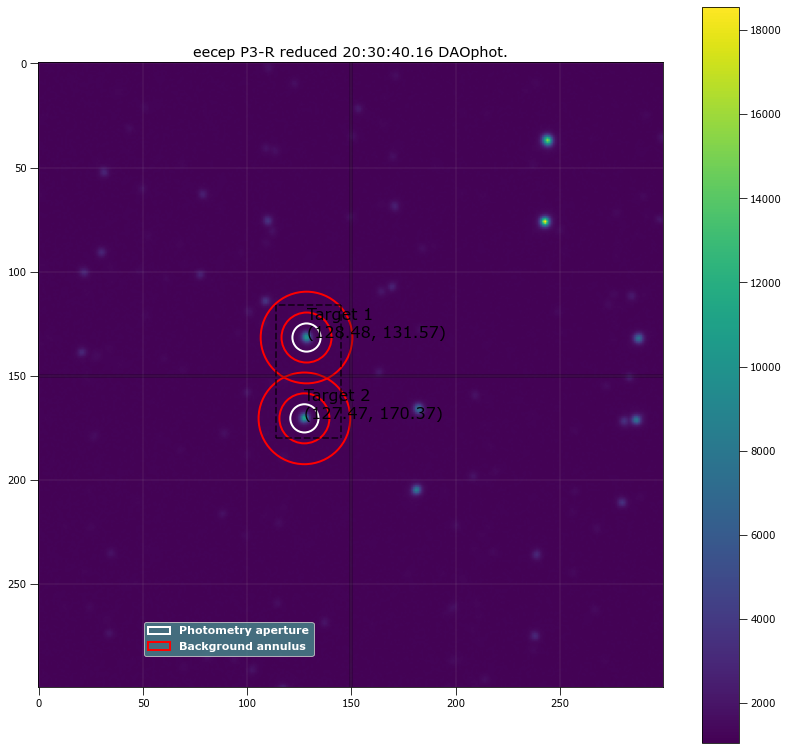

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.4785 131.56765 ...          3557.1509      1263569.2          3868.8549
  2 127.47066 170.37286 ...          3605.9362      1264697.3          3872.1704

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.4785 131.56765 ...                 3035.6974             156529.93
  2 127.47066 170.37286 ...                 3084.0358             152371.59

Write this out the excel
423 20:30:40.16 P3-R 20.0 6.769491525423728 128.47850353391425 131.5676507706219 156529.92541653378 3035.697358436479 1

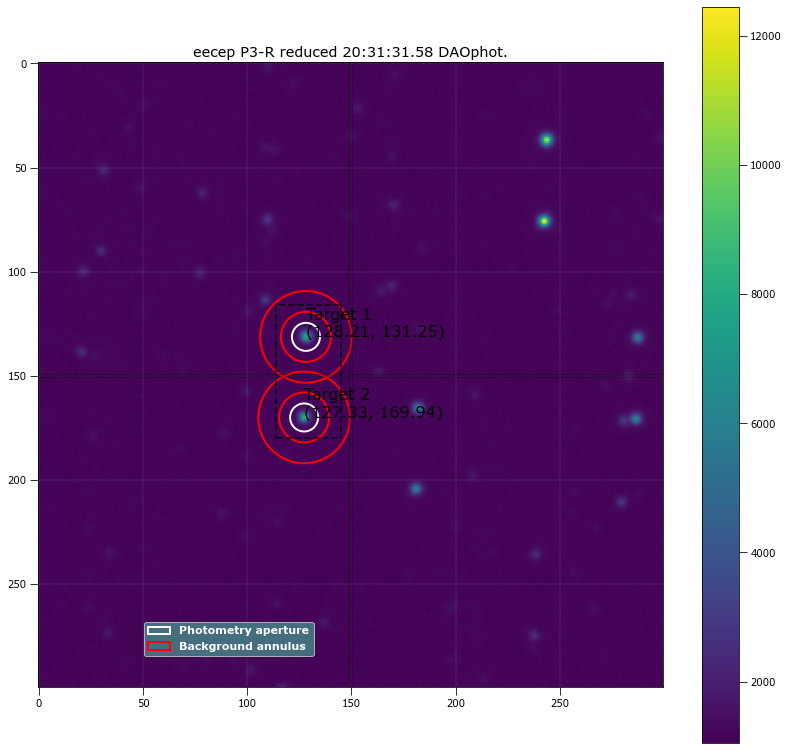

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.20909 131.25309 ...           3240.564        1263497          3868.0657
  2 127.33464  169.9421 ...          3235.2922      1262823.4          3865.9234

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.20909 131.25309 ...                 2724.8795             153955.21
  2 127.33464  169.9421 ...                 2719.8934             148731.77

Write this out the excel
424 20:31:31.58 P3-R 20.0 6.732627118644068 128.209087190645 131.25308688721844 153955.21004320038 2724.8794885734706 12

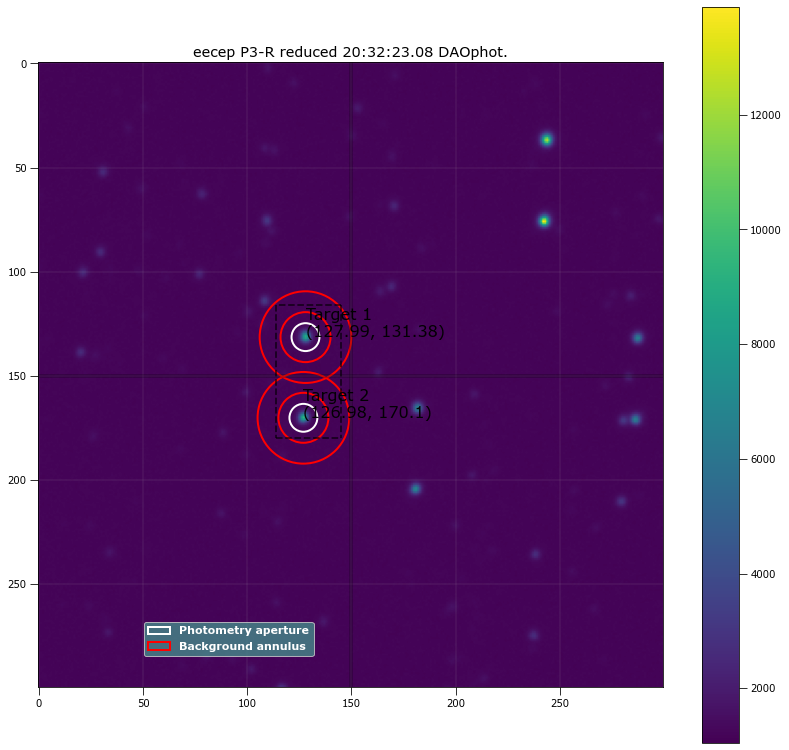

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.99419 131.37623 ...           3337.755      1266854.3          3878.4485
  2 126.98333 170.10494 ...          3340.7838      1267517.1          3880.5703

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.99419 131.37623 ...                 2826.3332              153431.7
  2 126.98333 170.10494 ...                 2829.0822             148402.27

Write this out the excel
425 20:32:23.08 P3-R 20.0 6.695762711864407 127.99419096351438 131.3762251372815 153431.6971386082 2826.333192790951 12

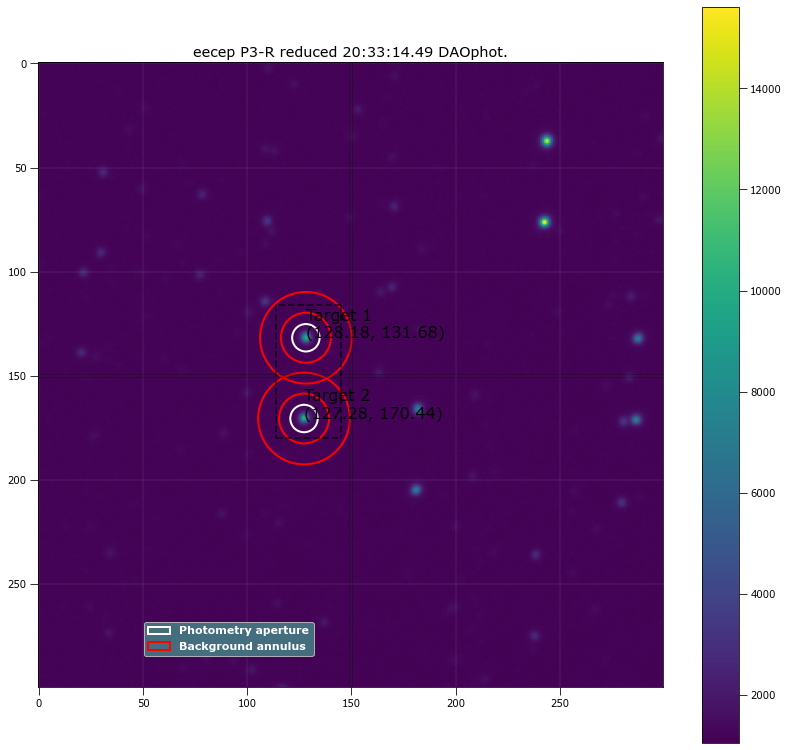

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.17643 131.68368 ...          3481.3107      1267190.7          3879.8319
  2 127.28314  170.4408 ...          3483.5192      1265195.1          3873.5179

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.17643 131.68368 ...                 2986.4672             155637.11
  2 127.28314  170.4408 ...                  2989.481             151220.25

Write this out the excel
426 20:33:14.49 P3-R 20.0 6.5851694915254235 128.17642748867647 131.68367527748163 155637.10844629625 2986.467159763034

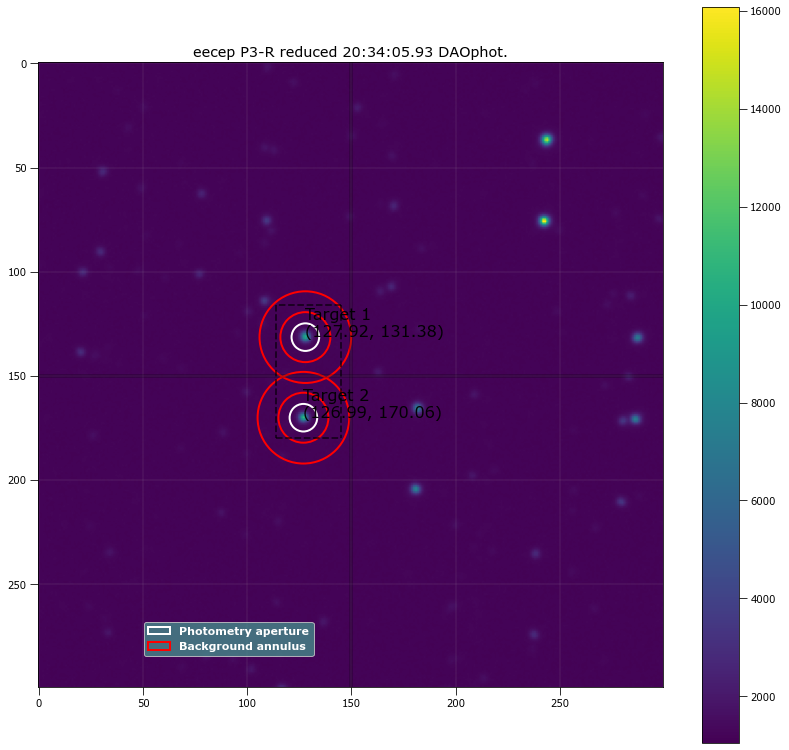

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1   127.924 131.38145 ...          3515.6593      1268593.6           3884.197
  2 126.98926   170.059 ...          3517.3894      1268307.8            3883.19

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1   127.924 131.38145 ...                 3014.6969             156053.34
  2 126.98926   170.059 ...                 3016.5569              151355.3

Write this out the excel
427 20:34:05.93 P3-R 20.0 6.622033898305085 127.92400024337687 131.38145248271186 156053.3423890831 3014.696944144464 1

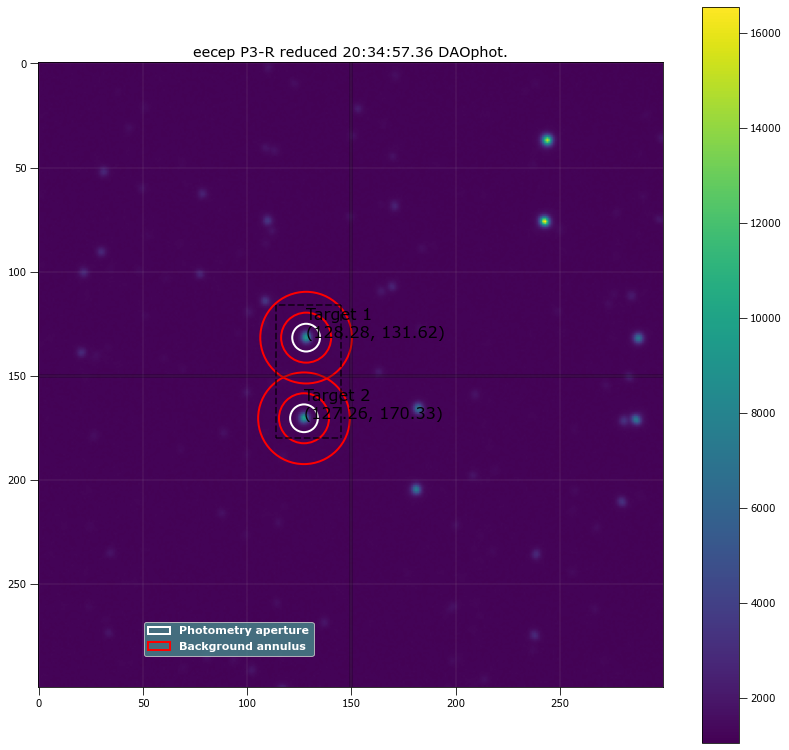

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.28489 131.62326 ...          3453.1867      1273121.1          3897.7925
  2 127.26499  170.3312 ...          3458.2937      1274716.7          3902.5898

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.28489 131.62326 ...                 2944.8581             155952.13
  2 127.26499  170.3312 ...                 2949.3394             151468.44

Write this out the excel
428 20:34:57.36 P3-R 20.0 6.658898305084746 128.2848891275055 131.62325518283512 155952.12912709234 2944.8580870293126 

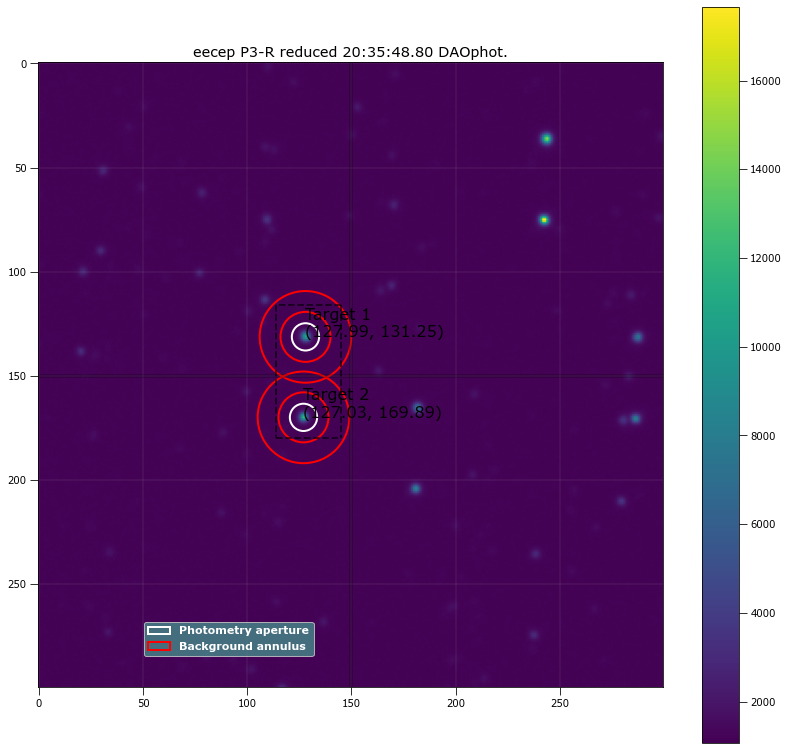

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1   127.986 131.25383 ...          3572.9128      1275626.5          3905.6657
  2 127.02781 169.89079 ...          3643.9597      1276986.6          3909.8092

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1   127.986 131.25383 ...                  3080.336             157118.29
  2 127.02781 169.89079 ...                 3150.8603             153807.32

Write this out the excel
429 20:35:48.80 P3-R 20.0 6.5483050847457624 127.98599627221688 131.25382777512058 157118.285749104 3080.3359623160727 

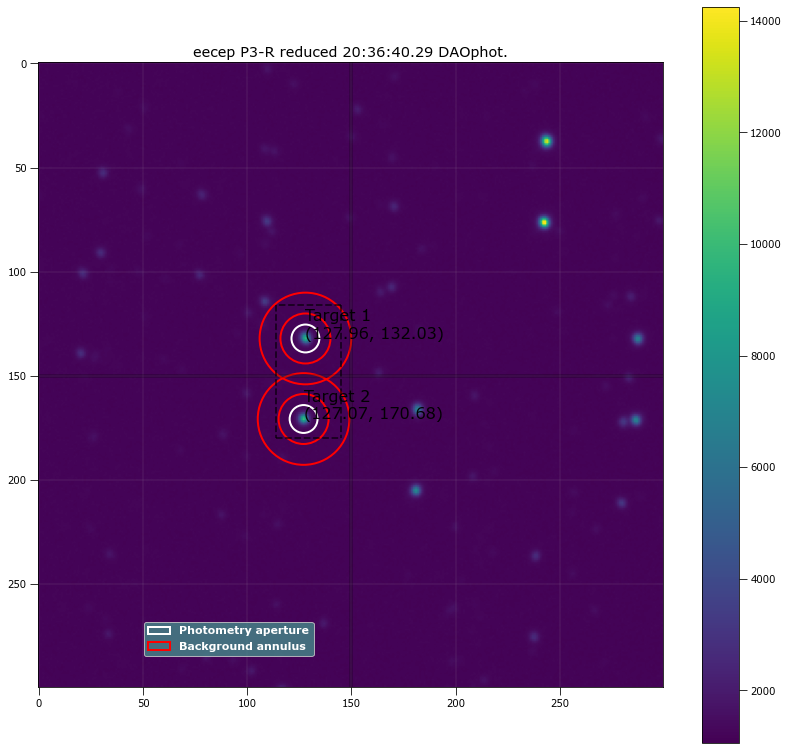

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.96231 132.02821 ...          3455.0852      1271665.3          3893.3759
  2 127.07084 170.68044 ...          3459.9049        1270716          3890.4969

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.96231 132.02821 ...                 2941.6951             157115.34
  2 127.07084 170.68044 ...                 2946.8943             153406.73

Write this out the excel
430 20:36:40.29 P3-R 20.0 6.695762711864407 127.96231205841144 132.0282085027032 157115.33807443795 2941.695086659277 1

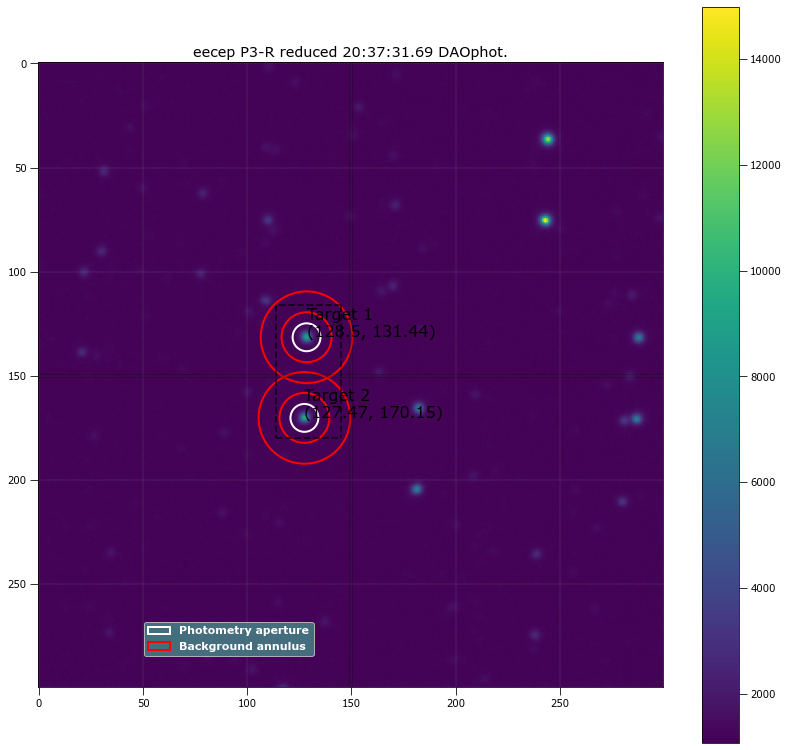

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.50108 131.43978 ...          3419.1242      1272155.4          3894.8816
  2 127.47352 170.14552 ...          3422.7162      1273077.8          3897.6699

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.50108 131.43978 ...                 2905.5355             156473.36
  2 127.47352 170.14552 ...                 2908.7598              151765.7

Write this out the excel
431 20:37:31.69 P3-R 20.0 6.695762711864406 128.50108441104717 131.43977892219127 156473.3618201666 2905.5354848321845 1

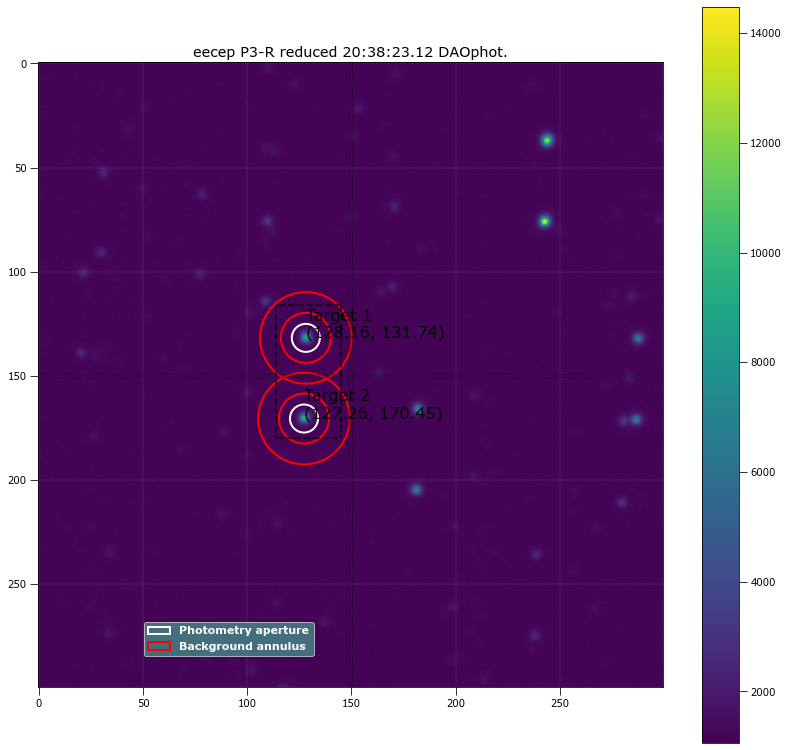

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.15601 131.74228 ...          3391.9896      1273589.1          3899.3846
  2 127.26468  170.4498 ...          3387.1691      1272289.7          3895.1483

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.15601 131.74228 ...                 2872.1298             155596.98
  2 127.26468  170.4498 ...                  2867.874             150503.14

Write this out the excel
432 20:38:23.12 P3-R 20.0 6.732627118644068 128.15600985059223 131.74228240085029 155596.97963679468 2872.1297627992 127

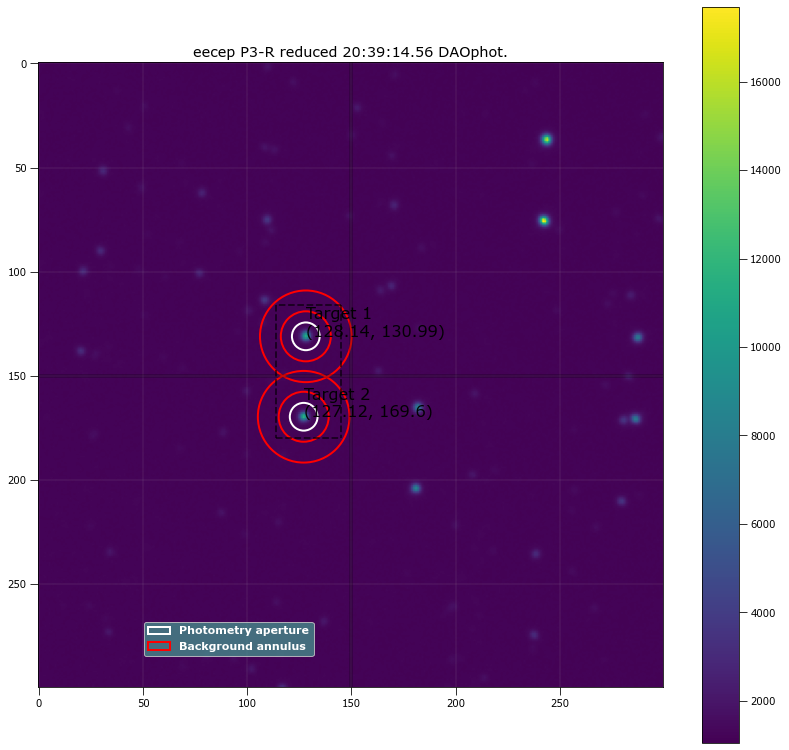

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.14216 130.98682 ...          3671.3254      1275236.5          3904.5506
  2 127.11948 169.59749 ...          3686.3654      1275548.1          3905.5129

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.14216 130.98682 ...                 3162.1154             159328.58
  2 127.11948 169.59749 ...                 3177.0299             155120.83

Write this out the excel
433 20:39:14.56 P3-R 20.0 6.658898305084746 128.14216031660501 130.98681626920737 159328.5752049799 3162.115401181325 1

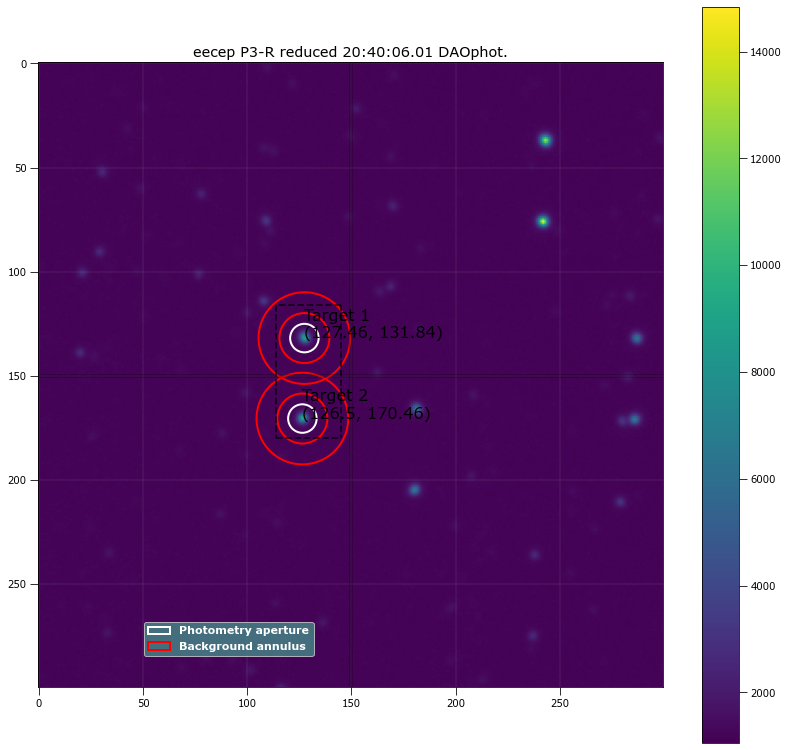

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.46118 131.83793 ...          3399.1985      1268980.4          3885.1354
  2 126.49581 170.46261 ...          3409.5244      1268690.6           3884.011

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.46118 131.83793 ...                 2864.0821             158177.98
  2 126.49581 170.46261 ...                 2874.5628             154545.78

Write this out the excel
434 20:40:06.01 P3-R 20.0 6.84322033898305 127.46118302213648 131.83793007338372 158177.9786521634 2864.0821091688863 12

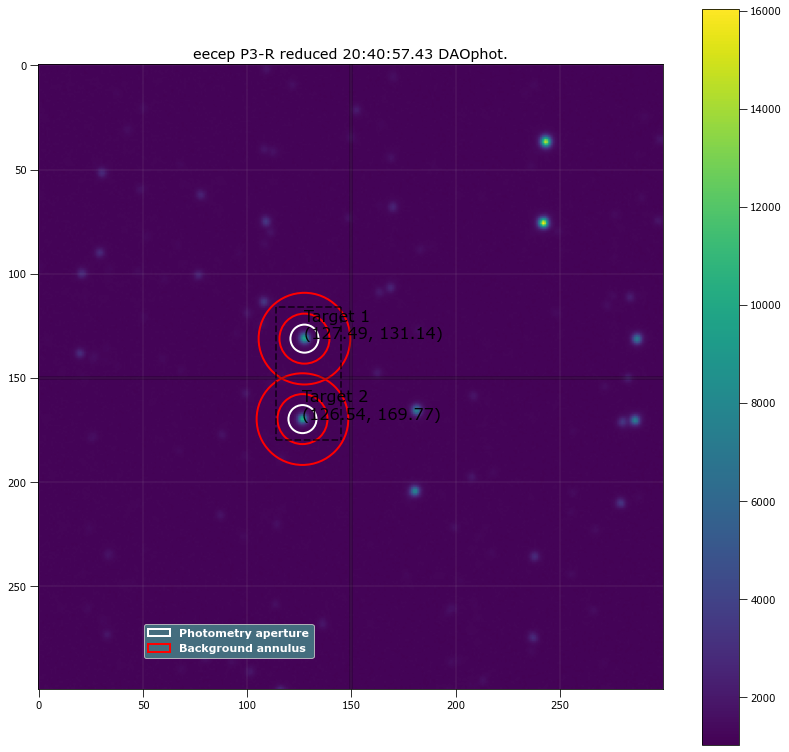

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.49224 131.14264 ...          3513.6831      1267012.1          3879.2212
  2 126.53584 169.77195 ...          3510.6821      1265199.1          3873.7003

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.49224 131.14264 ...                 2996.5114             158165.35
  2 126.53584 169.77195 ...                 2994.2464             152514.45

Write this out the excel
435 20:40:57.43 P3-R 20.0 6.732627118644068 127.49223755784384 131.14264011565922 158165.34676277588 2996.511381646194 1

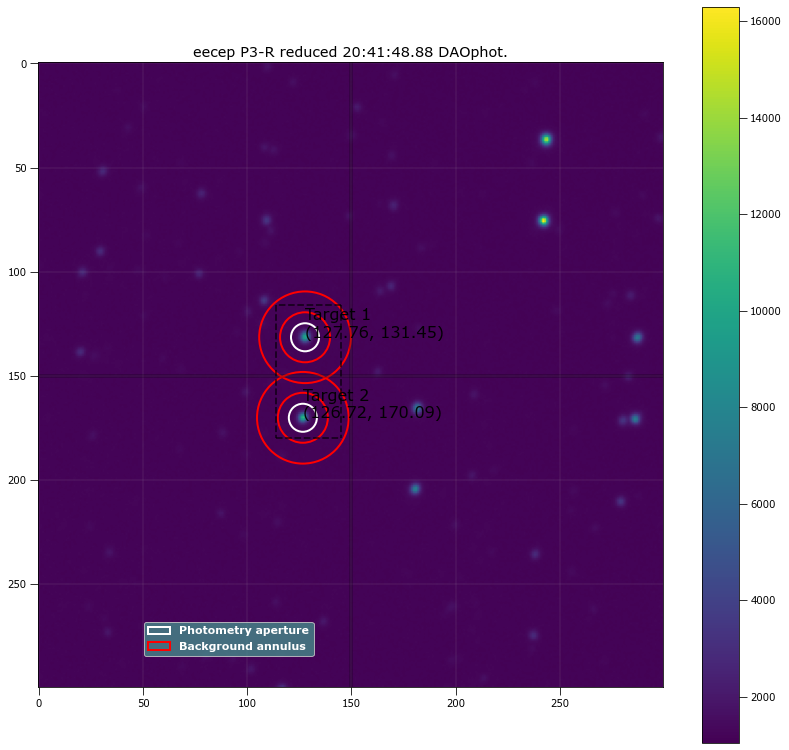

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7643 131.44747 ...           3556.391        1262397          3865.1623
  2 126.71988 170.09027 ...          3591.3553      1264353.9           3871.001

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7643 131.44747 ...                 3041.0936             159700.97
  2 126.71988 170.09027 ...                 3075.2795             155068.43

Write this out the excel
436 20:41:48.88 P3-R 20.0 6.732627118644068 127.7642981563374 131.44746909068724 159700.9711936091 3041.093642168745 126

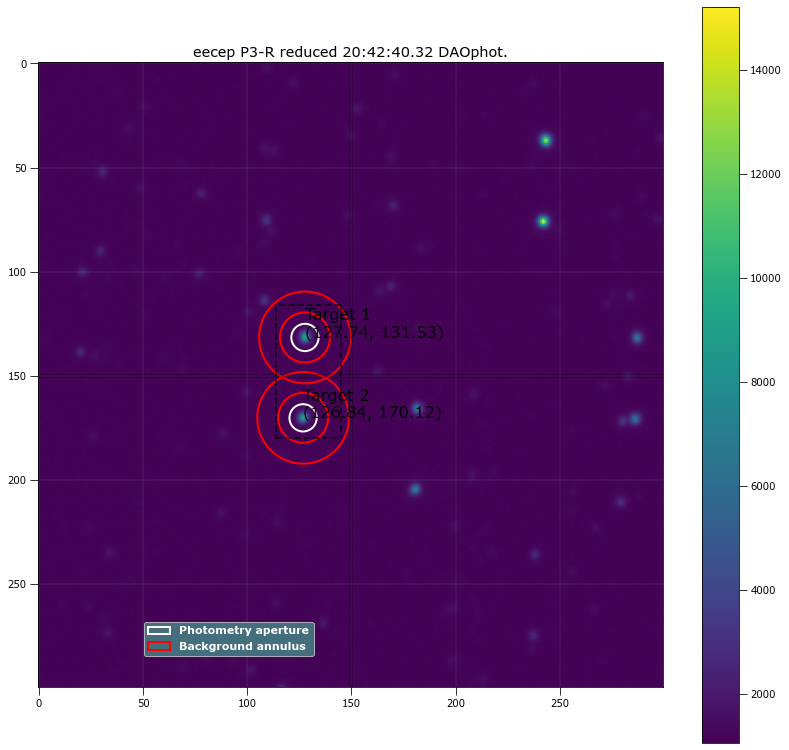

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.73682 131.53424 ...          3420.9161      1259761.7          3856.9563
  2 126.83643 170.12243 ...          3364.4274      1260279.3          3858.4527

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.73682 131.53424 ...                 2934.4825             159158.28
  2 126.83643 170.12243 ...                  2877.805             153693.88

Write this out the excel
437 20:42:40.32 P3-R 20.0 6.5483050847457624 127.73682060214547 131.5342438433544 159158.277857847 2934.482457824876 12

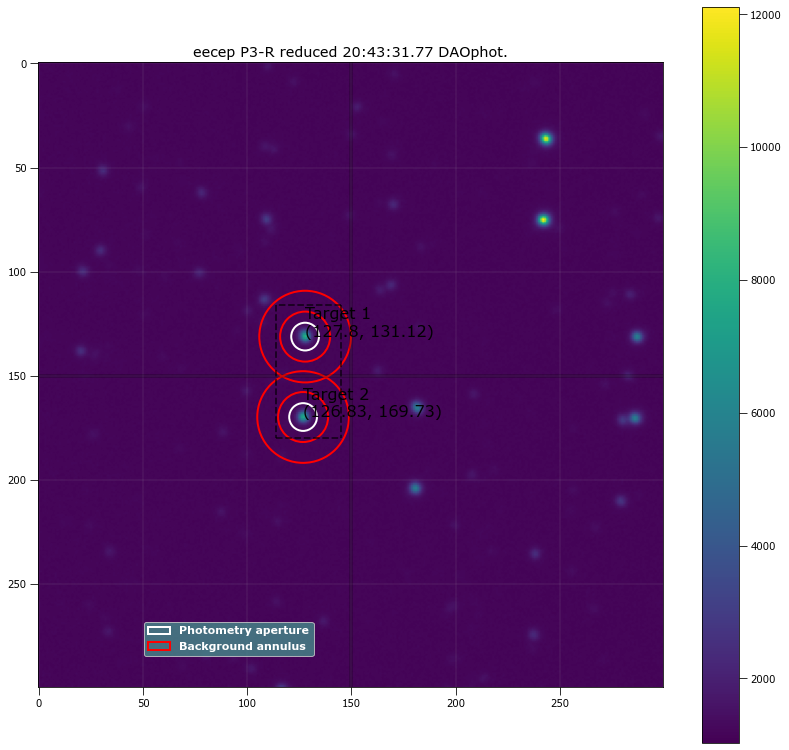

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.80401 131.12292 ...          3246.3338        1258936          3854.0578
  2 126.83374 169.73225 ...          3175.7752      1258737.4          3853.5326

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.80401 131.12292 ...                 2743.7088             155578.05
  2 126.83374 169.73225 ...                 2673.2187             149888.68

Write this out the excel
438 20:43:31.77 P3-R 20.0 6.658898305084746 127.80401108777419 131.12292103983546 155578.04758821768 2743.708799998587 

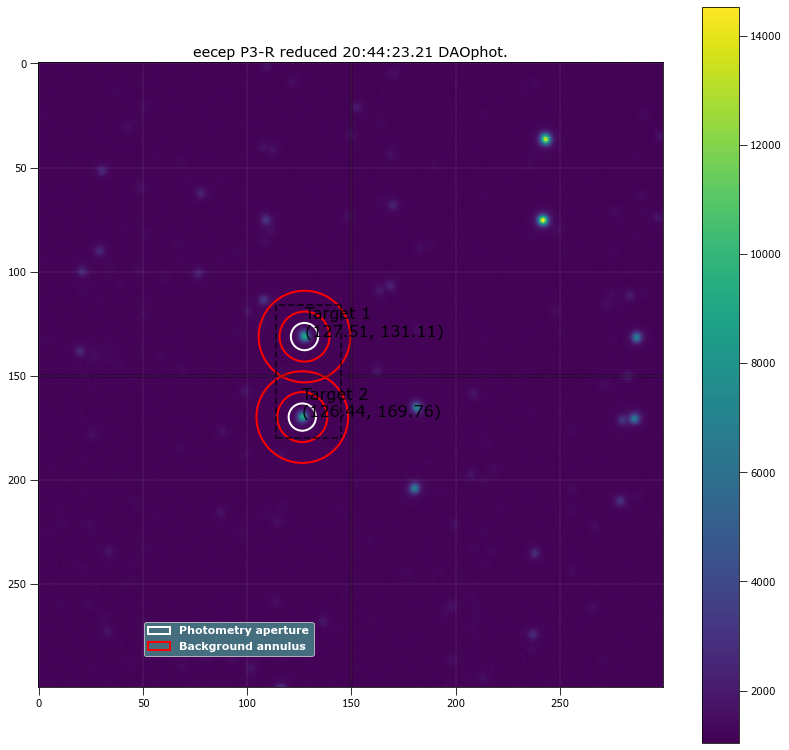

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51401 131.11292 ...          3426.8473      1257529.9          3850.0858
  2 126.44298  169.7613 ...          3367.2731      1258901.3          3854.3587

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51401 131.11292 ...                 2941.2802             158333.41
  2 126.44298  169.7613 ...                  2881.167             152649.71

Write this out the excel
439 20:44:23.21 P3-R 20.0 6.5483050847457624 127.51400663390517 131.11292473052538 158333.41147521482 2941.280164025789

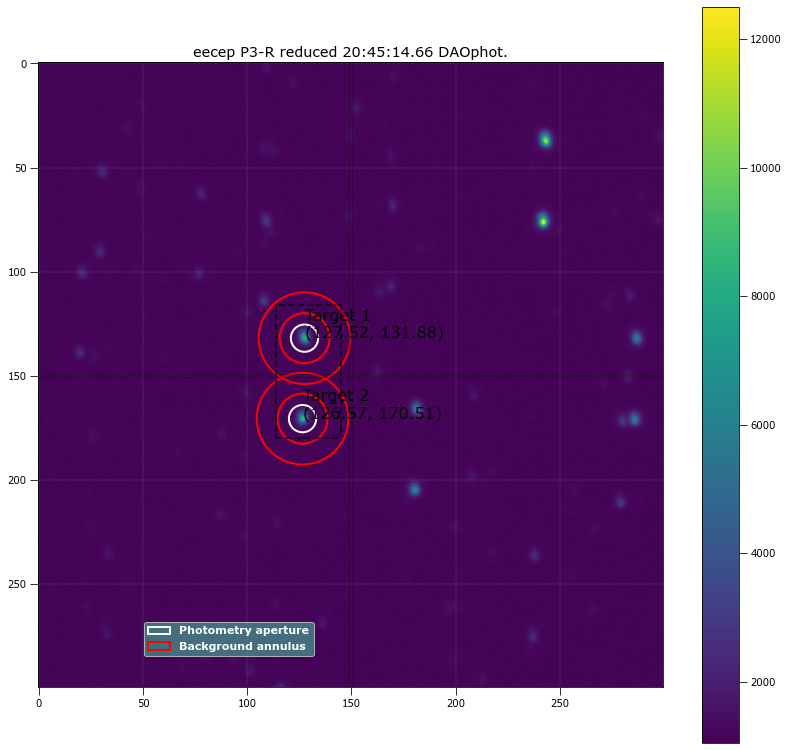

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51972 131.87622 ...          3309.4173      1253702.8          3838.2205
  2 126.57275  170.5051 ...          3309.2074      1253292.8          3836.8395

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51972 131.87622 ...                 2825.3466             156764.54
  2 126.57275  170.5051 ...                 2825.3108             153287.54

Write this out the excel
440 20:45:14.66 P3-R 20.0 6.5483050847457624 127.51972361115587 131.87622429493123 156764.54369577047 2825.346598087997

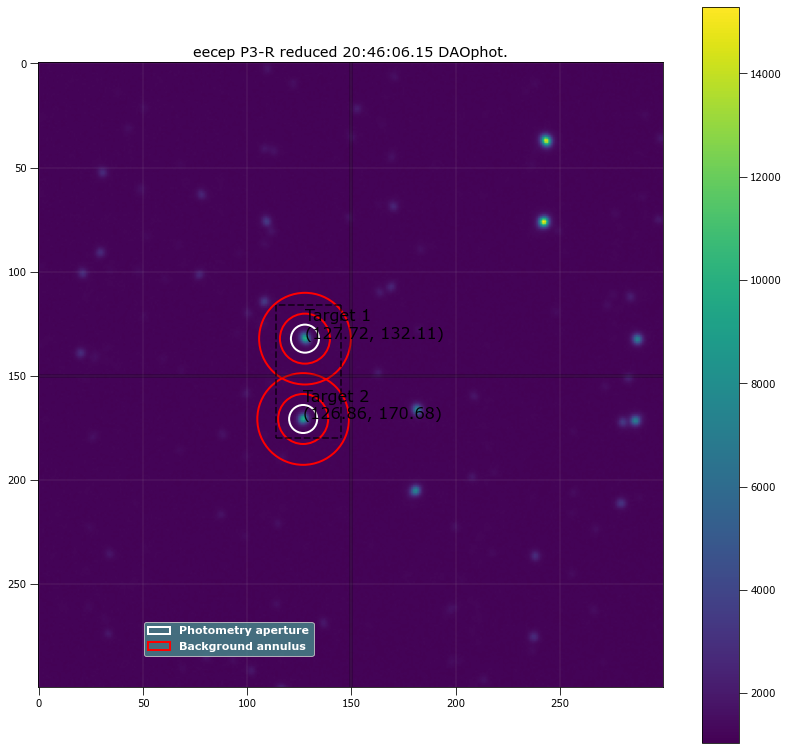

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.72398 132.10584 ...          3494.7841      1251456.3          3831.6681
  2 126.86301 170.67857 ...          3441.8172      1250880.4          3829.9384

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.72398 132.10584 ...                 2983.9521             157934.92
  2 126.86301 170.67857 ...                 2931.2158             153060.65

Write this out the excel
441 20:46:06.15 P3-R 20.0 6.732627118644068 127.7239775038916 132.10583642910672 157934.9227012918 2983.95205675223 126.

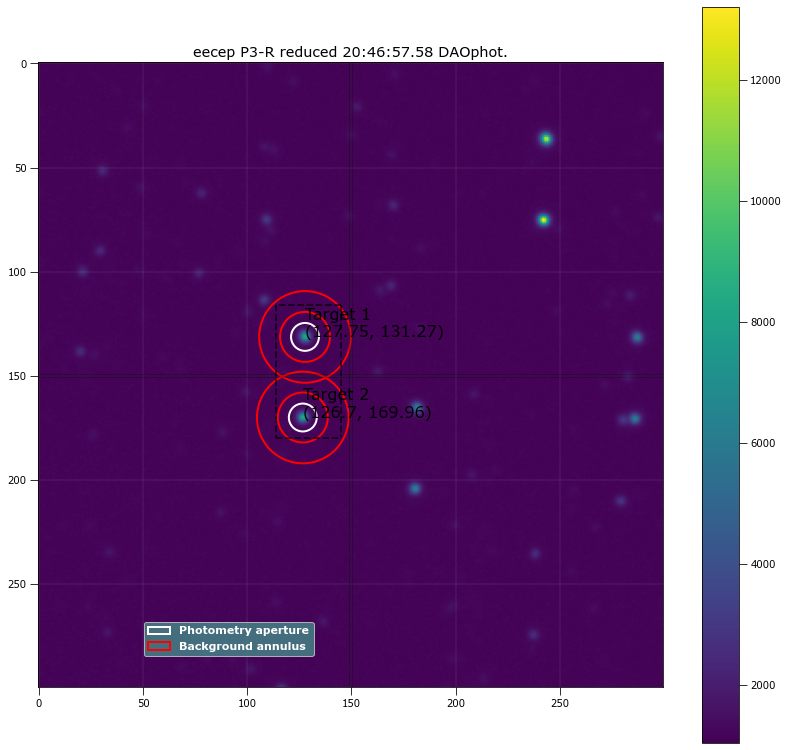

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.75243 131.27138 ...          3302.0919      1252647.8          3835.0207
  2 126.69901 169.96232 ...           3285.903      1253469.4          3837.4745

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.75243 131.27138 ...                 2796.3966             156987.66
  2 126.69901 169.96232 ...                 2779.8842              152659.4

Write this out the excel
442 20:46:57.58 P3-R 20.0 6.695762711864406 127.75242606363035 131.27138187483152 156987.65550450847 2796.396649931905 1

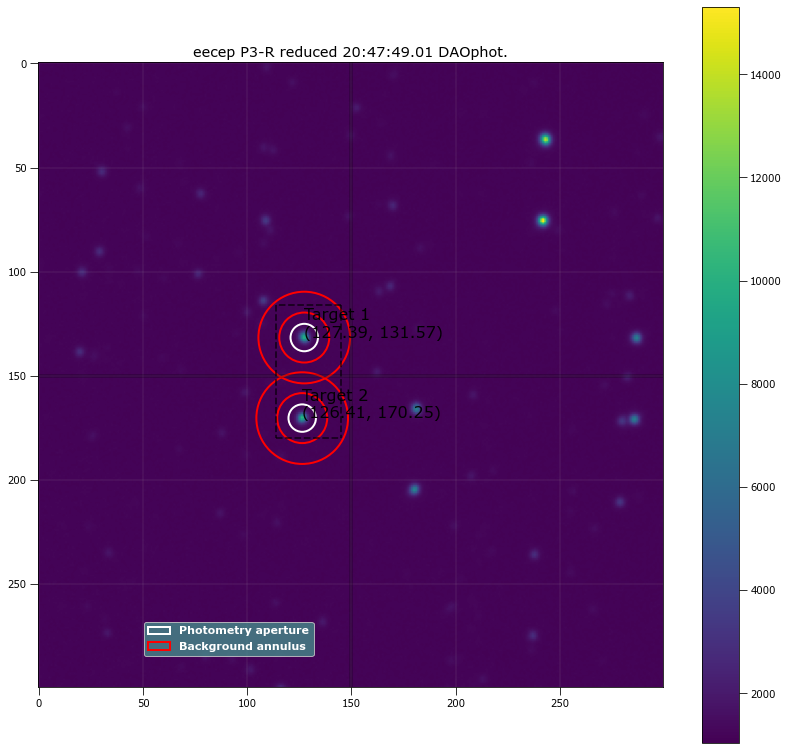

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.39307 131.57426 ...          3518.1649      1250662.6          3829.2832
  2 126.40746 170.25209 ...          3512.0887      1250413.8          3828.3481

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.39307 131.57426 ...                 3029.7685              159300.3
  2 126.40746 170.25209 ...                 3023.8115             155165.09

Write this out the excel
443 20:47:49.01 P3-R 20.0 6.5851694915254235 127.3930660175935 131.57426071694388 159300.30403079168 3029.768488698788 

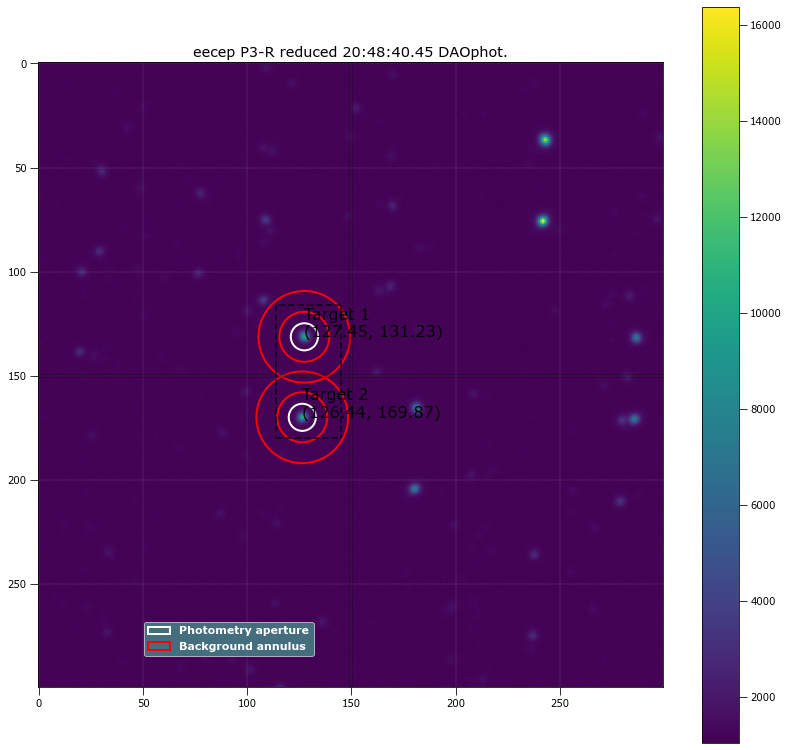

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.44626  131.2285 ...           3496.442      1248042.7          3821.4143
  2 126.44357 169.87265 ...          3516.5921        1248871          3823.7616

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.44626  131.2285 ...                  3019.902             158359.71
  2 126.44357 169.87265 ...                 3039.7593              153759.2

Write this out the excel
444 20:48:40.45 P3-R 20.0 6.511440677966101 127.4462593358573 131.2285022453873 158359.7110967915 3019.901996275352 126

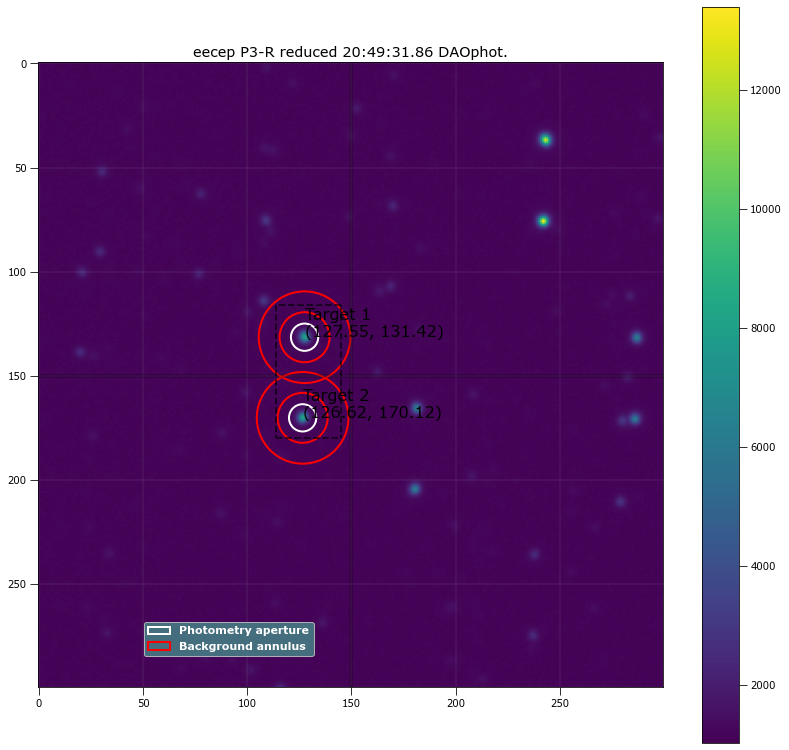

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.54952 131.41675 ...          3263.0394      1248985.1          3823.8543
  2 126.61981 170.12215 ...          3231.9769      1247741.9          3820.0083

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.54952 131.41675 ...                 2780.7805             155418.46
  2 126.61981 170.12215 ...                 2750.2031             150801.46

Write this out the excel
445 20:49:31.86 P3-R 20.0 6.5483050847457624 127.54952490500109 131.41675136992438 155418.45624470987 2780.780488996222

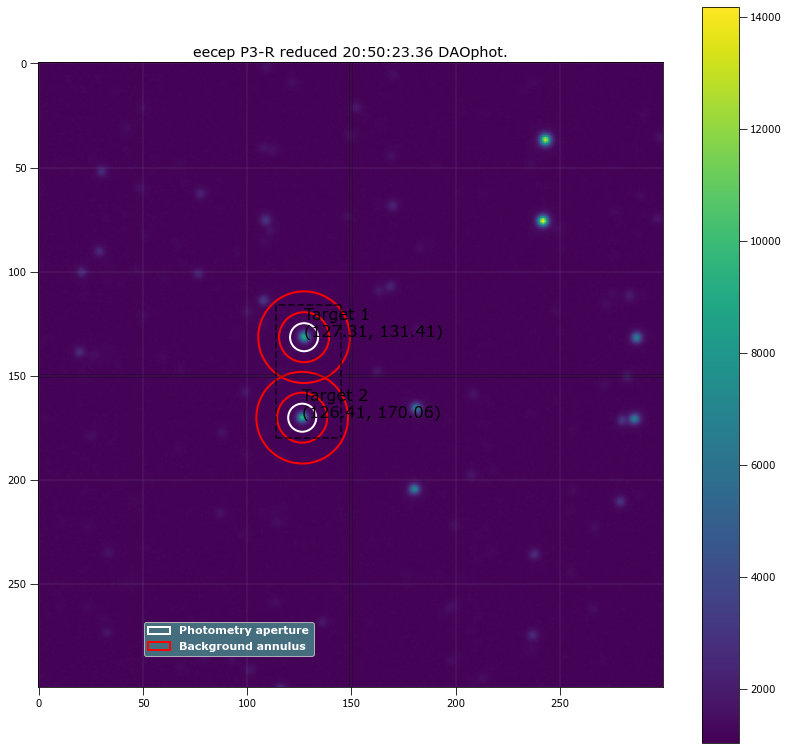

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.30602 131.41229 ...          3410.7513      1249857.5          3826.5323
  2   126.408 170.05588 ...          3419.3475        1251277          3830.8828

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.30602 131.41229 ...                  2900.604             159967.58
  2   126.408 170.05588 ...                 2908.6202             154685.08

Write this out the excel
446 20:50:23.36 P3-R 20.0 6.732627118644068 127.30601948684026 131.41228780398768 159967.58036233456 2900.6039871633075 

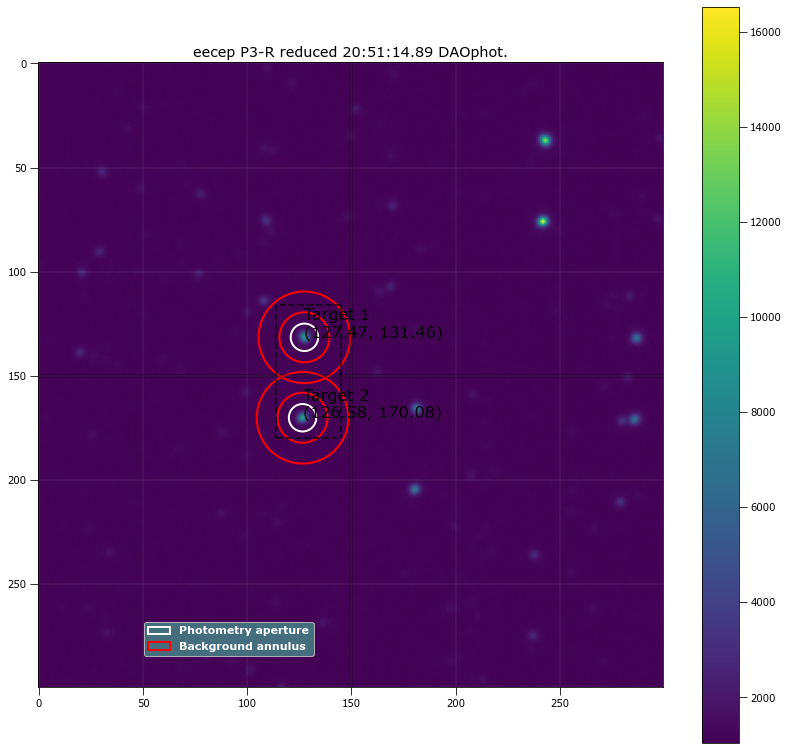

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.46658 131.46323 ...          3431.0845      1247773.4          3820.4233
  2 126.57923  170.0781 ...          3442.4233      1248261.1          3821.7221

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.46658 131.46323 ...                 2943.8181             157630.88
  2 126.57923  170.0781 ...                 2954.9912             153540.44

Write this out the excel
447 20:51:14.89 P3-R 20.0 6.5851694915254235 127.4665766645143 131.46322937006002 157630.88217673576 2943.818084733561 

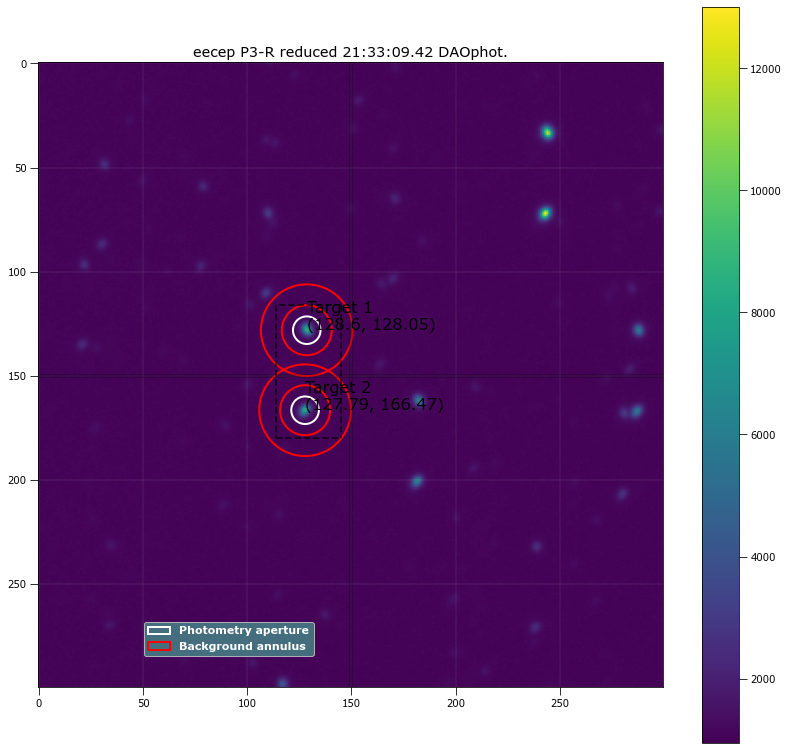

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.59871 128.05261 ...          3312.2131      1154857.3          3536.1024
  2 127.78898 166.46854 ...          3241.7154        1152119           3527.455

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.59871 128.05261 ...                  2856.146             164115.19
  2 127.78898 166.46854 ...                 2786.7637             158917.89

Write this out the excel
448 21:33:09.42 P3-R 20.0 6.622033898305085 128.59871262433768 128.0526074864053 164115.1883146164 2856.146033197244 12

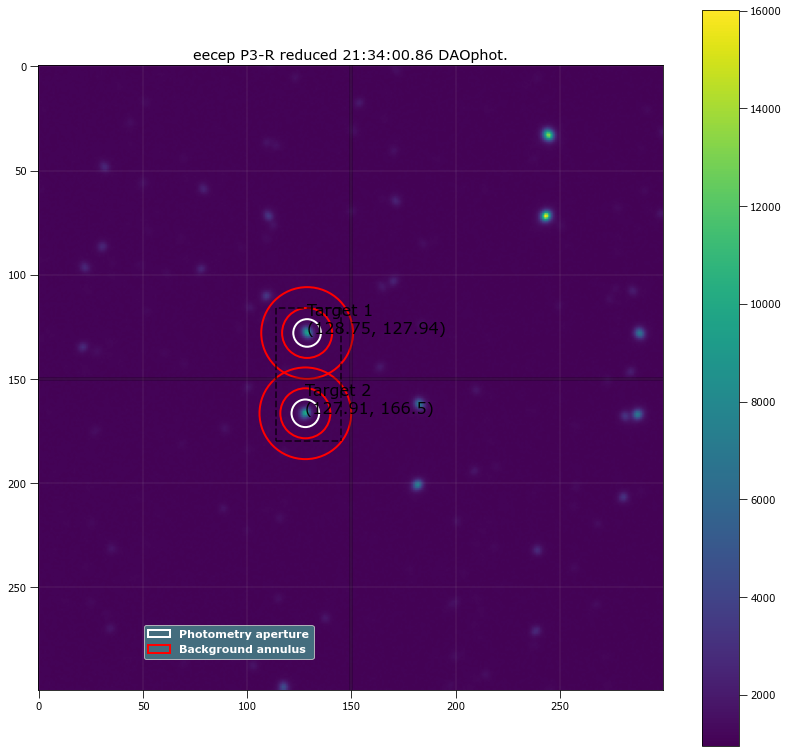

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.7515 127.93665 ...          3459.7608      1150765.9          3523.7365
  2 127.91427 166.50066 ...          3438.6834      1150064.4          3521.3311

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.7515 127.93665 ...                 3005.2886             166642.44
  2 127.91427 166.50066 ...                 2984.5215             161256.63

Write this out the excel
449 21:34:00.86 P3-R 20.0 6.622033898305085 128.75149703674077 127.93665457417225 166642.43883307496 3005.288608040235 

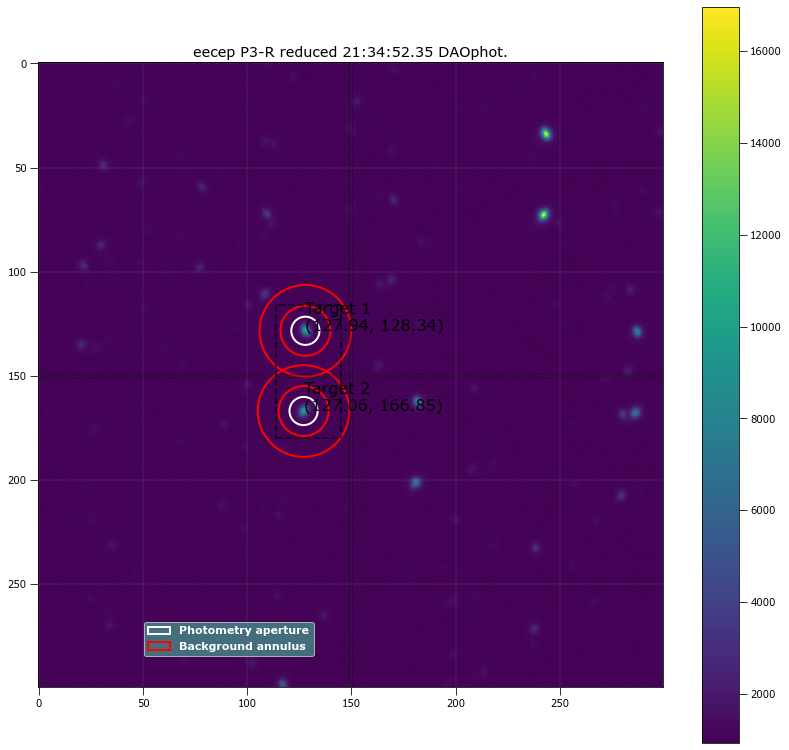

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.94189 128.34215 ...          3638.8368      1149083.1           3519.086
  2 127.06212 166.85176 ...          3501.9612      1149972.5          3521.3562

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.94189 128.34215 ...                 3164.5259             166688.71
  2 127.06212 166.85176 ...                 3027.3443             160568.62

Write this out the excel
450 21:34:52.35 P3-R 20.0 6.769491525423728 127.94188788774653 128.34214562364704 166688.70725780493 3164.5259265751724

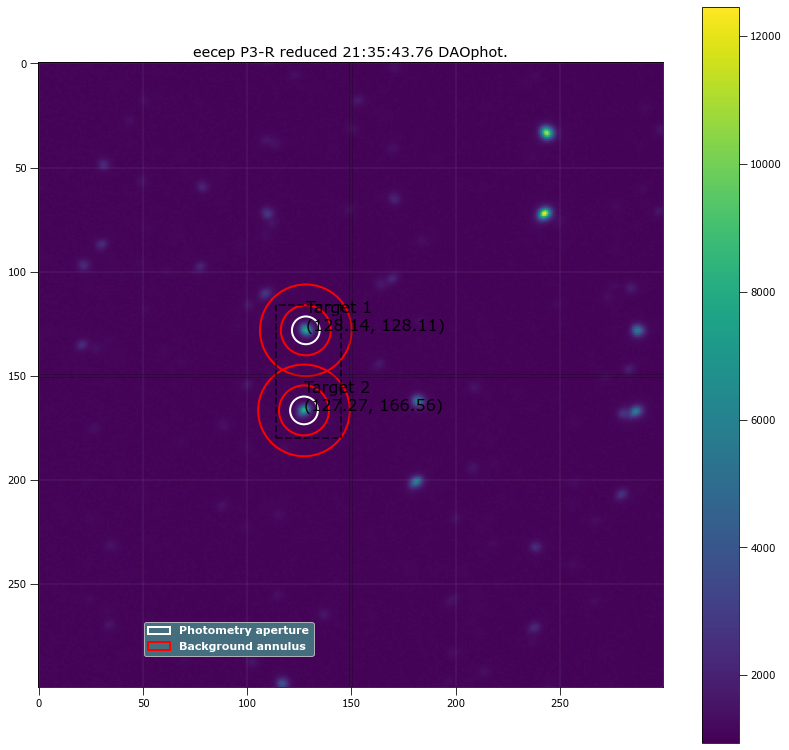

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.14267 128.10732 ...          3244.4666      1144732.6           3505.019
  2 127.26575 166.55902 ...          3241.6454      1144247.8          3503.4915

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.14267 128.10732 ...                 2787.3614             164652.86
  2 127.26575 166.55902 ...                 2784.7394                159579

Write this out the excel
451 21:35:43.76 P3-R 20.0 6.658898305084746 128.14266575799283 128.10731732826363 164652.857159877 2787.361368211732 12

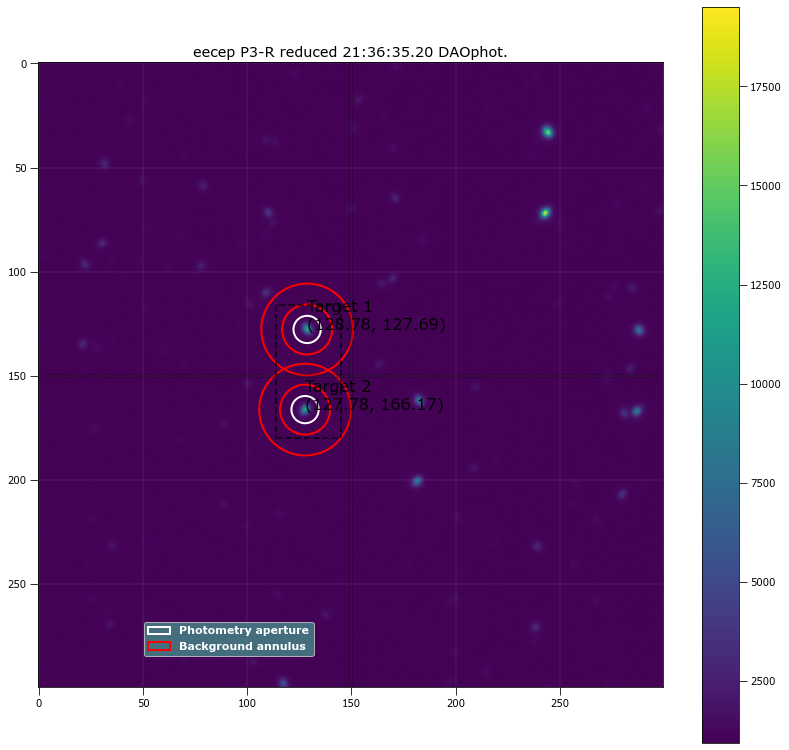

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.77778 127.69197 ...          3649.2841      1142425.3          3498.6204
  2 127.78369 166.17203 ...          3636.3689      1144834.6          3506.2735

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.77778 127.69197 ...                 3208.0432             167739.38
  2 127.78369 166.17203 ...                 3194.1629             161832.11

Write this out the excel
452 21:36:35.20 P3-R 20.0 6.5483050847457624 128.77777851667577 127.69196934154802 167739.3829717851 3208.043207098477 

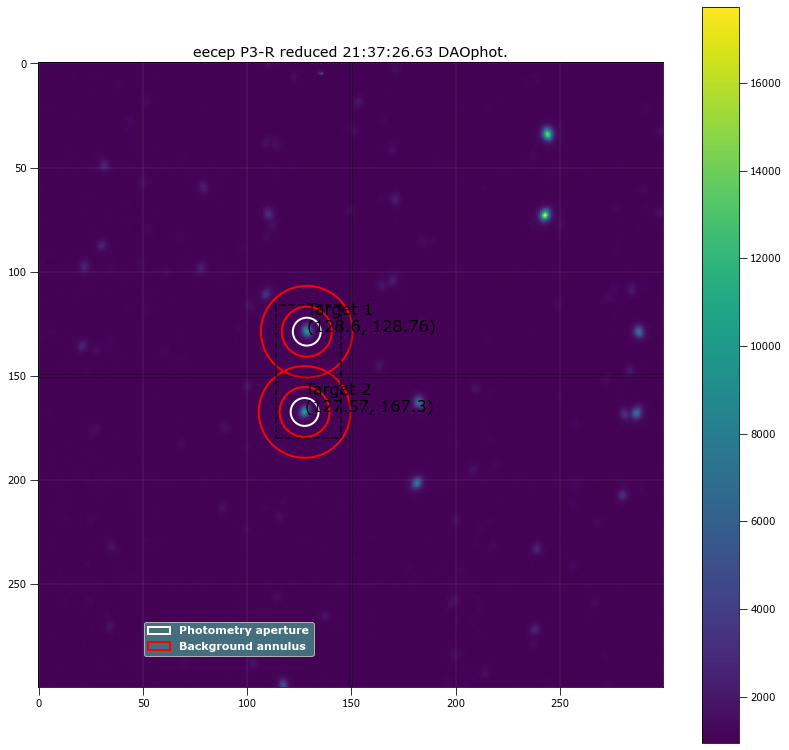

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.59954 128.75872 ...          3496.7244      1142421.9          3498.2961
  2 127.56811 167.29923 ...          3500.2176      1142483.9          3498.5005

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.59954 128.75872 ...                 3035.4305             167623.38
  2 127.56811 167.29923 ...                 3038.8966             163115.82

Write this out the excel
453 21:37:26.63 P3-R 20.0 6.695762711864406 128.5995420250565 128.75872136563646 167623.381496051 3035.430460472781 127.

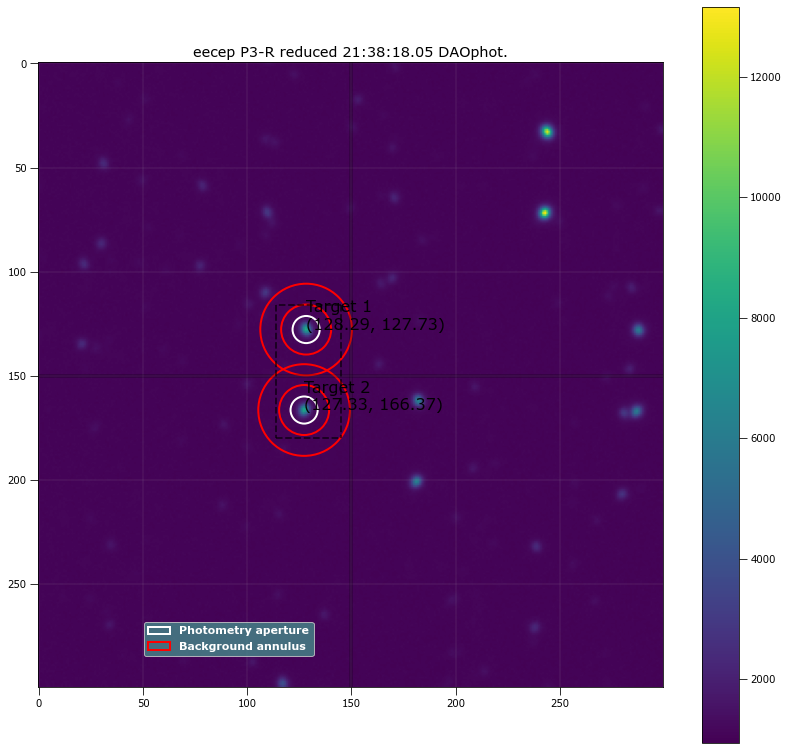

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.28989 127.73207 ...          3263.0759      1139763.8           3489.931
  2  127.3257 166.37307 ...          3204.4406      1140293.3          3491.4355

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.28989 127.73207 ...                 2827.8727             164484.53
  2  127.3257 166.37307 ...                 2769.0497             159328.63

Write this out the excel
454 21:38:18.05 P3-R 20.0 6.511440677966101 128.28988555014945 127.73206649124073 164484.53395628103 2827.872660689337 

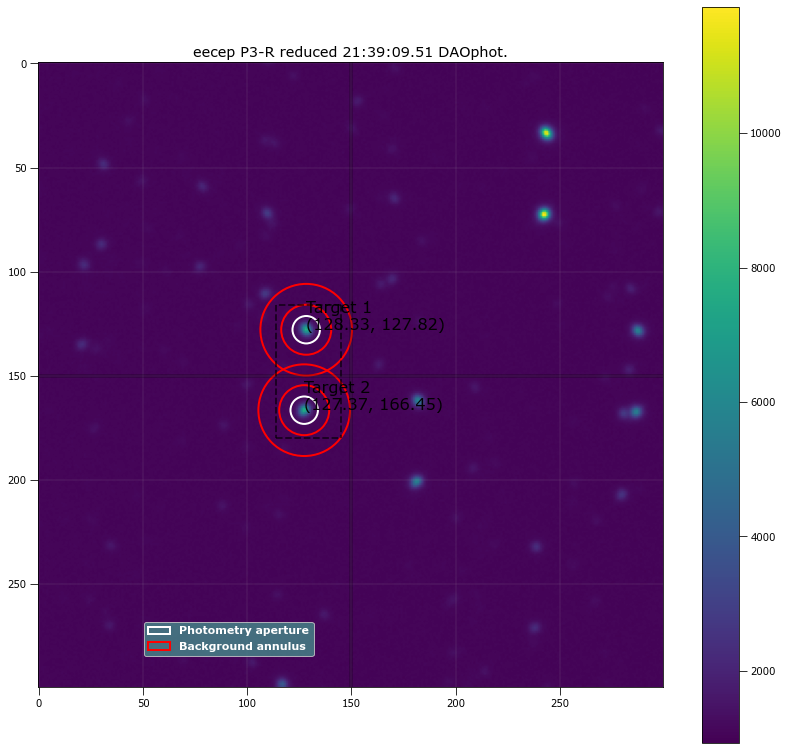

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.33078 127.82088 ...          3202.0987      1139576.8          3489.2947
  2 127.37108  166.4477 ...          3161.9452      1138032.6           3484.257

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.33078 127.82088 ...                 2757.0653             163740.48
  2 127.37108  166.4477 ...                 2717.5542             159447.07

Write this out the excel
455 21:39:09.51 P3-R 20.0 6.5851694915254235 128.33077557950497 127.82088098587467 163740.47524445466 2757.065271729701

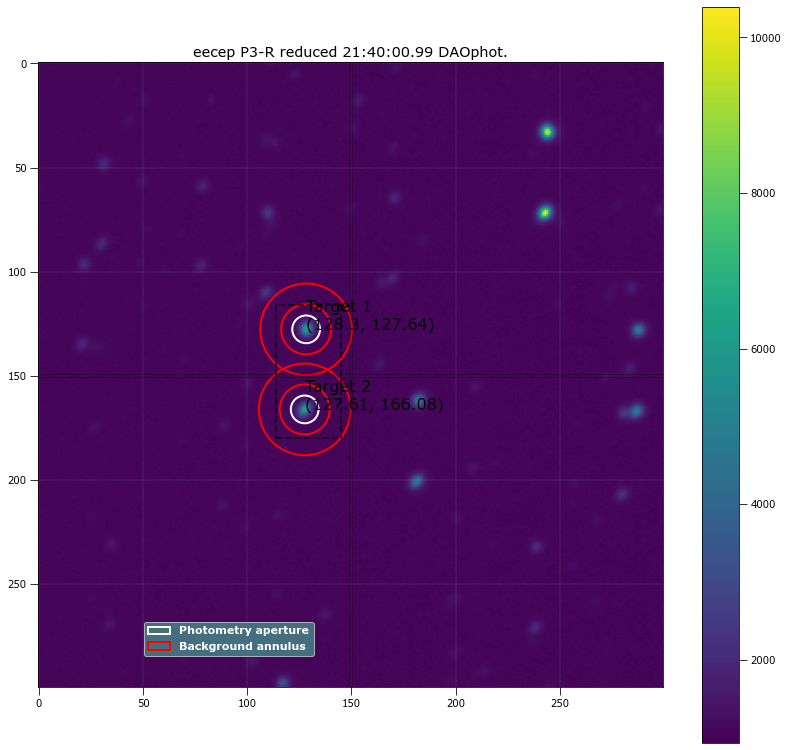

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.30056 127.63862 ...          3043.7087      1138113.6          3484.5794
  2 127.60576 166.07666 ...          2980.0203      1136072.5          3478.1297

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.30056 127.63862 ...                  2589.269             162818.11
  2 127.60576 166.07666 ...                 2526.4218             156618.42

Write this out the excel
456 21:40:00.99 P3-R 20.0 6.658898305084746 128.30055606624109 127.6386232044775 162818.1071493454 2589.269034056688 12

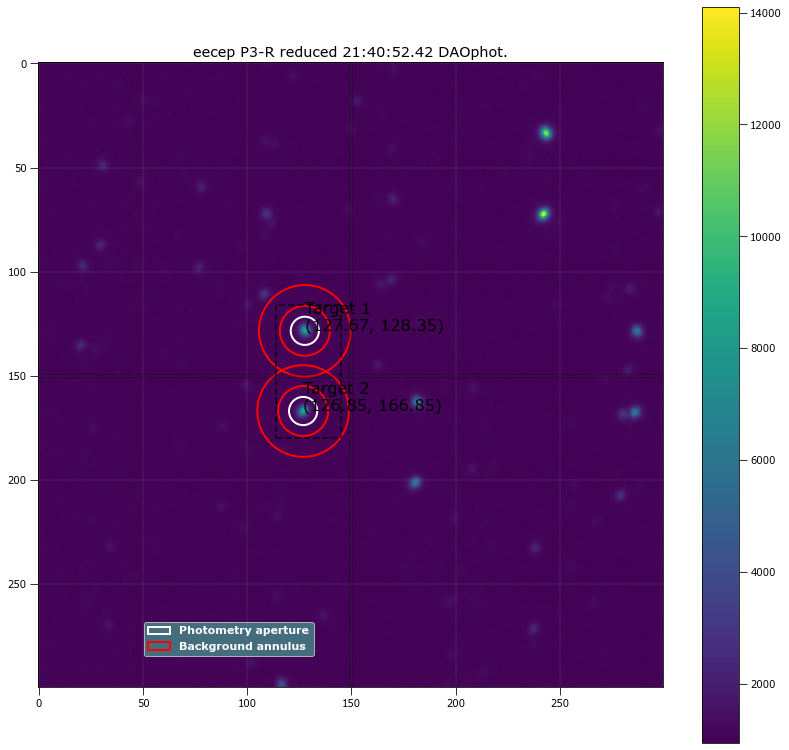

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.67079 128.34885 ...          3337.5897        1138647          3486.5573
  2 126.84556  166.8497 ...          3338.4926      1137500.5          3482.9397

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.67079 128.34885 ...                 2867.6631             165839.37
  2 126.84556  166.8497 ...                 2869.0536              160094.7

Write this out the excel
457 21:40:52.42 P3-R 20.0 6.769491525423728 127.67079034690599 128.34884647040283 165839.37485218974 2867.6631428213964

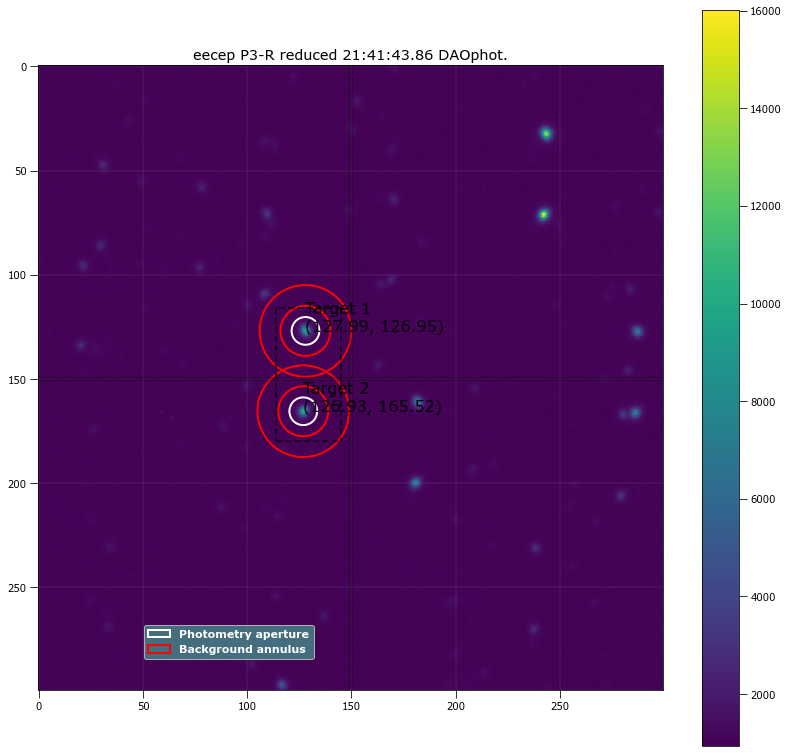

 id  xcenter  ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix      pix    ...                                                     
--- --------- -------- ... ------------------ -------------- ------------------
  1 127.98603 126.9549 ...          3497.0609        1135231          3476.4509
  2 126.92503 165.5189 ...          3482.5588        1136853          3481.2743

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter  ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix      pix    ...                                                
--- --------- -------- ... ------------------------- ---------------------
  1 127.98603 126.9549 ...                 3043.6814             167976.98
  2 126.92503 165.5189 ...                 3028.5502             162997.23

Write this out the excel
458 21:41:43.86 P3-R 20.0 6.658898305084746 127.98602818872826 126.9549031044284 167976.98087995735 3043.6813619098716 126.925027

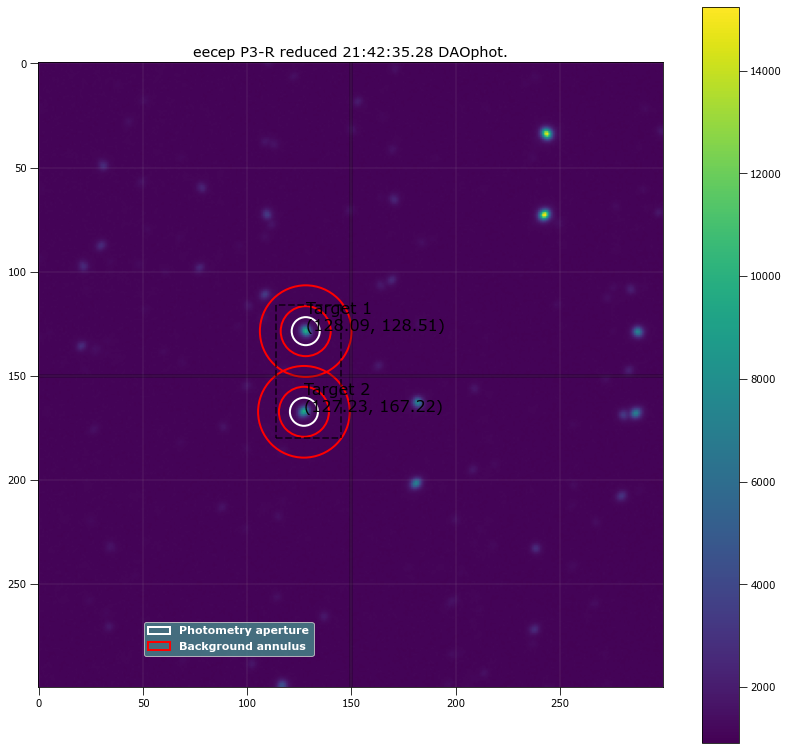

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09384 128.51179 ...          3476.5547      1128869.8           3457.032
  2 127.23265 167.21714 ...          3416.8073      1128557.3          3455.8446

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09384 128.51179 ...                 3015.6686             167537.39
  2 127.23265 167.21714 ...                 2956.0795             161595.81

Write this out the excel
459 21:42:35.28 P3-R 20.0 6.732627118644068 128.09383743118036 128.51178940383616 167537.3905855544 3015.6686450927255 1

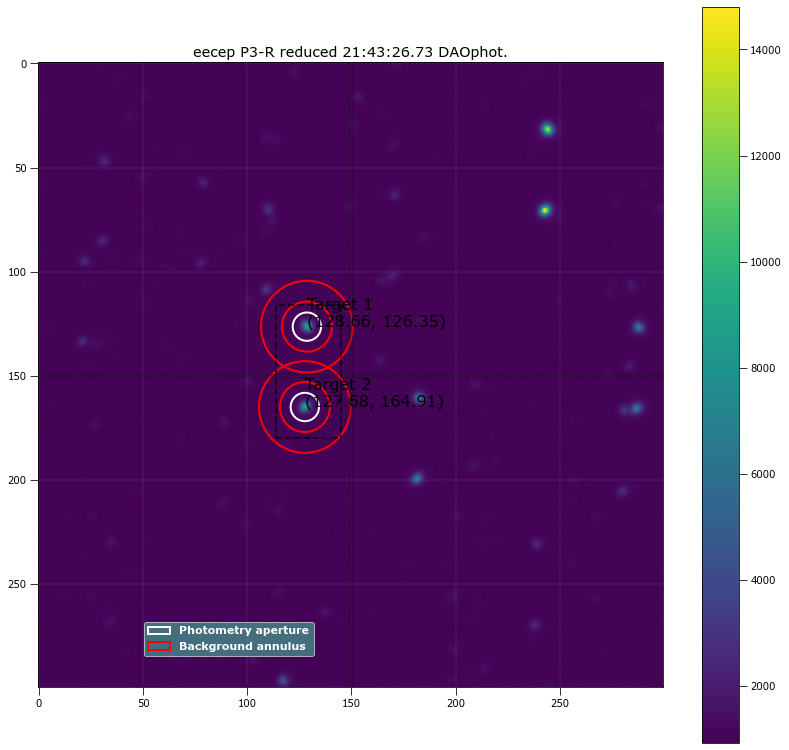

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.65584  126.3549 ...          3376.2721      1125250.3           3445.589
  2 127.67581 164.91302 ...          3322.3114      1125638.5          3446.7437

 Aperture are: 145.53893261452635 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.65584  126.3549 ...                 2906.7956             166657.47
  2 127.67581 164.91302 ...                 2852.6775             160549.31

Write this out the excel
460 21:43:26.73 P3-R 20.0 6.806355932203389 128.65583734437135 126.35490422411806 166657.46743001562 2906.7955926025165

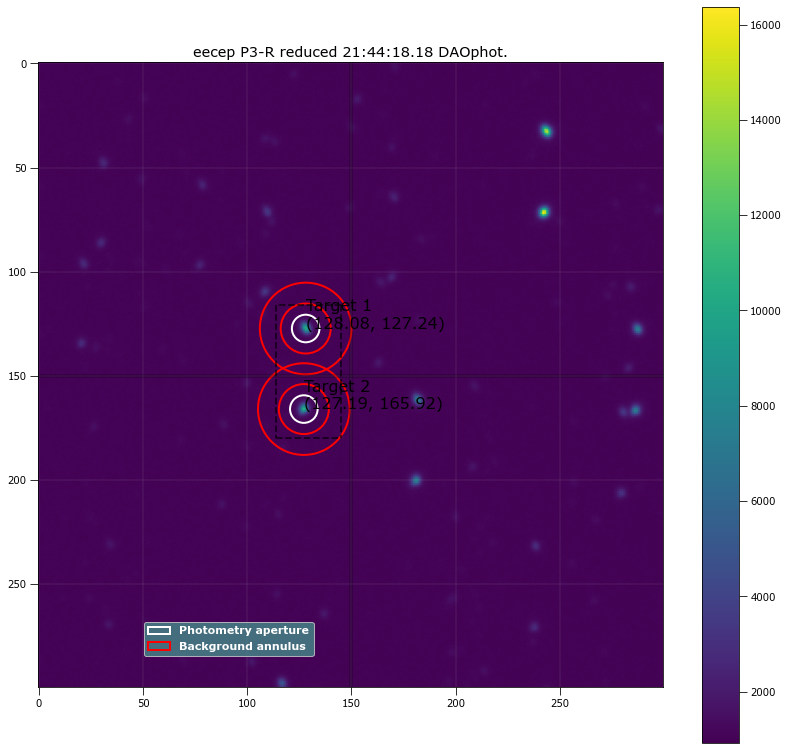

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08015  127.2363 ...          3568.1714      1123728.3          3441.2626
  2 127.18802 165.91688 ...          3528.0536      1125153.5          3445.5356

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08015  127.2363 ...                 3124.3363             170442.34
  2 127.18802 165.91688 ...                 3083.6674             164779.03

Write this out the excel
461 21:44:18.18 P3-R 20.0 6.622033898305085 128.08015444105456 127.23630274542263 170442.33878672632 3124.336259239927 

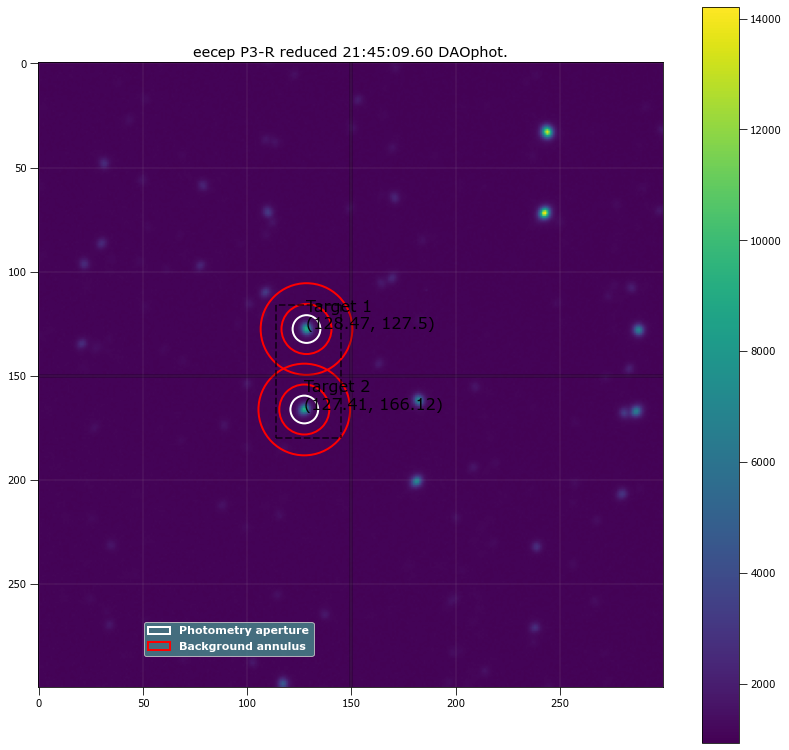

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.46548 127.49735 ...          3410.7943      1124972.1          3444.6481
  2 127.41165 166.12195 ...          3370.2964      1126634.9          3449.6972

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.46548 127.49735 ...                 2961.5623             168207.25
  2 127.41165 166.12195 ...                 2920.4059             163099.17

Write this out the excel
462 21:45:09.60 P3-R 20.0 6.658898305084746 128.46548274422818 127.49735135015491 168207.24781420108 2961.562324081 127

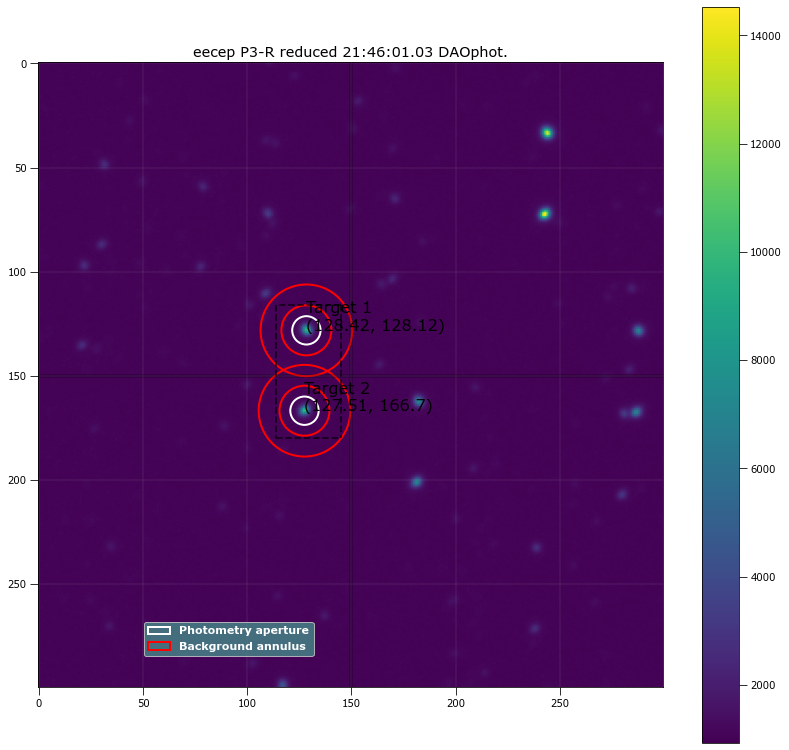

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.42058 128.11848 ...           3499.721      1125020.4          3445.0676
  2  127.5052 166.70421 ...          3476.3271      1123790.7          3441.2182

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.42058 128.11848 ...                 3030.3155             170424.26
  2  127.5052 166.70421 ...                 3007.4461             165987.31

Write this out the excel
463 21:46:01.03 P3-R 20.0 6.80635593220339 128.42058353561345 128.11847998337916 170424.26305348924 3030.3155256327364 1

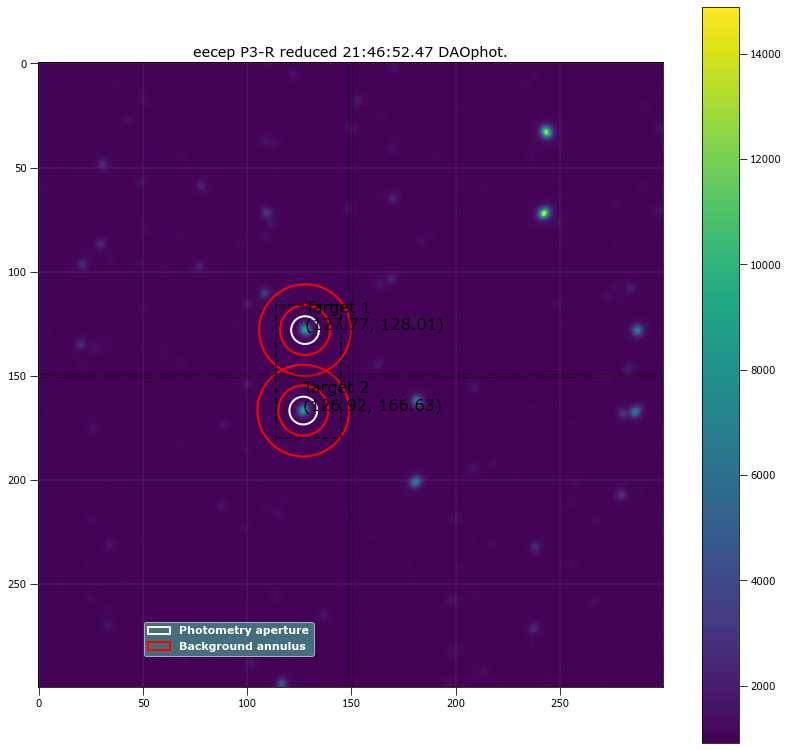

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.77426 128.00641 ...          3389.1852      1119822.4          3429.1509
  2  126.9152 166.63043 ...          3357.5108      1117394.1          3421.6343

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.77426 128.00641 ...                 2941.9742              165776.2
  2  126.9152 166.63043 ...                 2911.2802             161112.53

Write this out the excel
464 21:46:52.47 P3-R 20.0 6.658898305084746 127.77426467627032 128.0064054747851 165776.20274391424 2941.9741904196285 

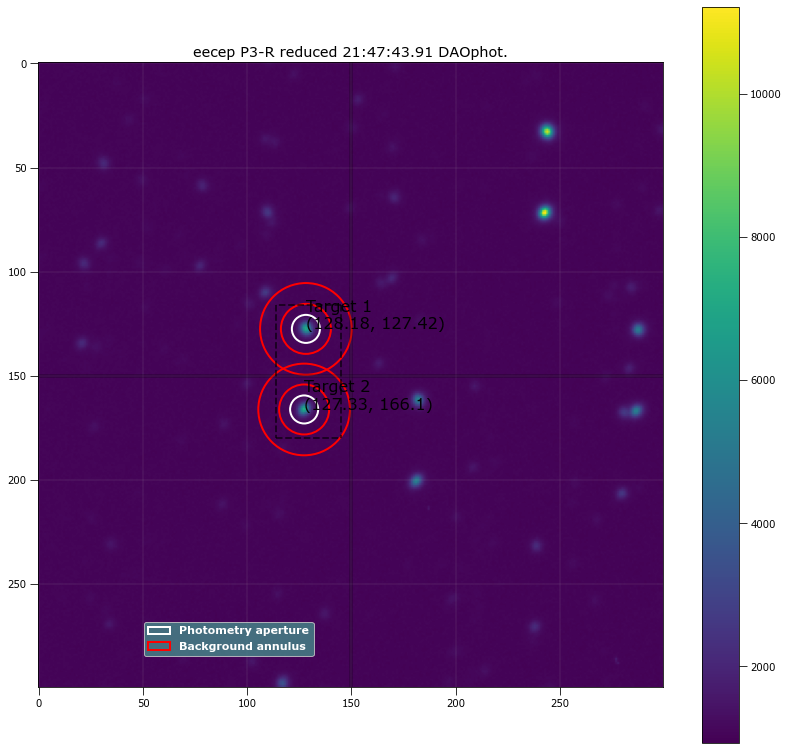

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.18298  127.4209 ...          3107.9171      1119521.6          3427.9121
  2 127.33473 166.10064 ...          3081.0732      1117561.8          3421.4954

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.18298  127.4209 ...                 2650.9132             163241.73
  2 127.33473 166.10064 ...                 2624.9248              158222.3

Write this out the excel
465 21:47:43.91 P3-R 20.0 6.732627118644068 128.18297938895924 127.42090258453267 163241.73385898554 2650.913194528746 1

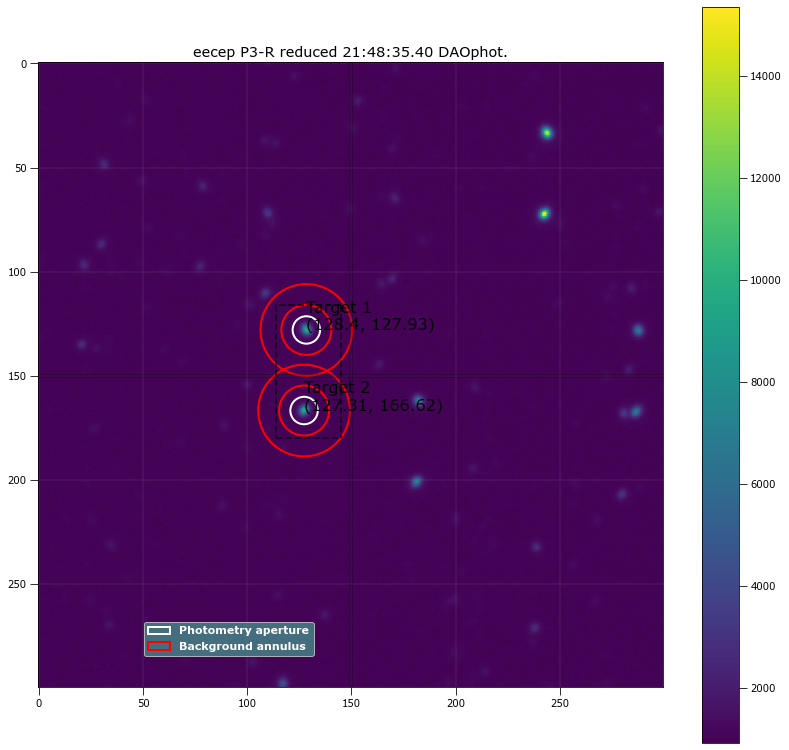

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.39719 127.93162 ...          3475.7239      1119651.8          3428.6258
  2 127.30851 166.61593 ...           3426.558      1120113.8          3430.2332

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.39719 127.93162 ...                 3038.4283             166464.12
  2 127.30851 166.61593 ...                 2989.0574             161264.32

Write this out the excel
466 21:48:35.40 P3-R 20.0 6.5851694915254235 128.39718948144585 127.93161792138906 166464.12205689357 3038.428271317645

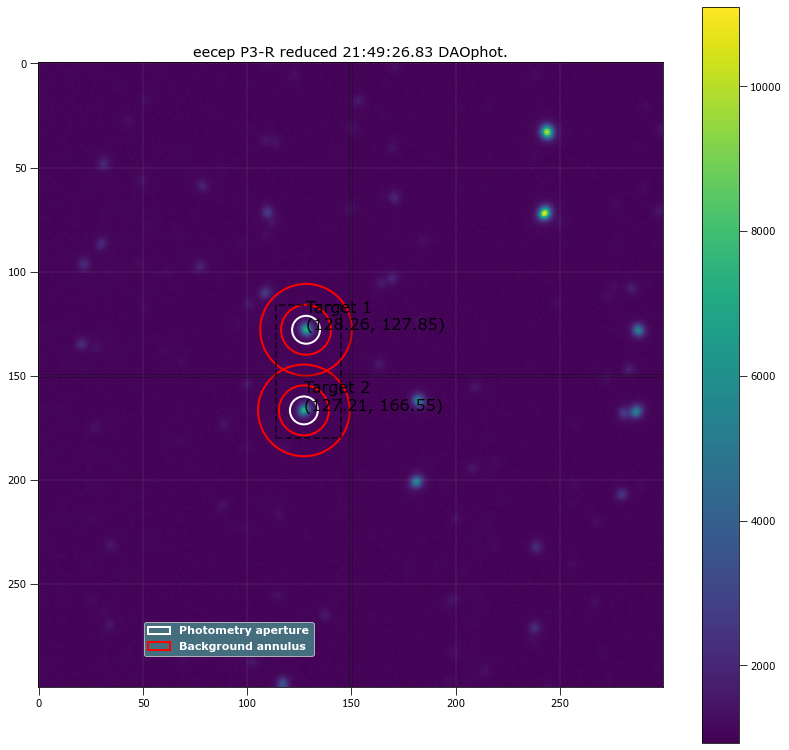

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.25855 127.84568 ...          3139.3647      1117740.8          3422.2114
  2 127.21382 166.54521 ...          3104.2793      1117672.3          3421.7331

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.25855 127.84568 ...                 2688.1034             164277.49
  2 127.21382 166.54521 ...                 2653.0811             159028.92

Write this out the excel
467 21:49:26.83 P3-R 20.0 6.695762711864407 128.25855051229672 127.84567718125446 164277.49138831167 2688.1034411364094

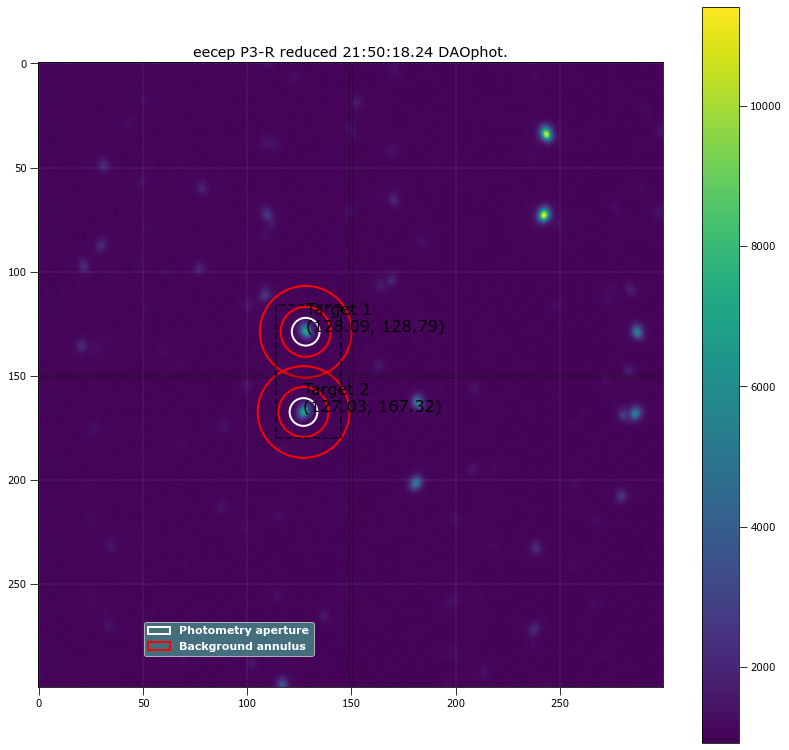

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08694 128.78869 ...          3138.4606      1115273.2           3414.821
  2 127.02739 167.31884 ...          3086.7893      1115714.8          3416.0637

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08694 128.78869 ...                 2693.1184             163823.96
  2 127.02739 167.31884 ...                 2641.2851             158355.82

Write this out the excel
468 21:50:18.24 P3-R 20.0 6.658898305084746 128.0869400121237 128.78869100055317 163823.95817529576 2693.118415335131 1

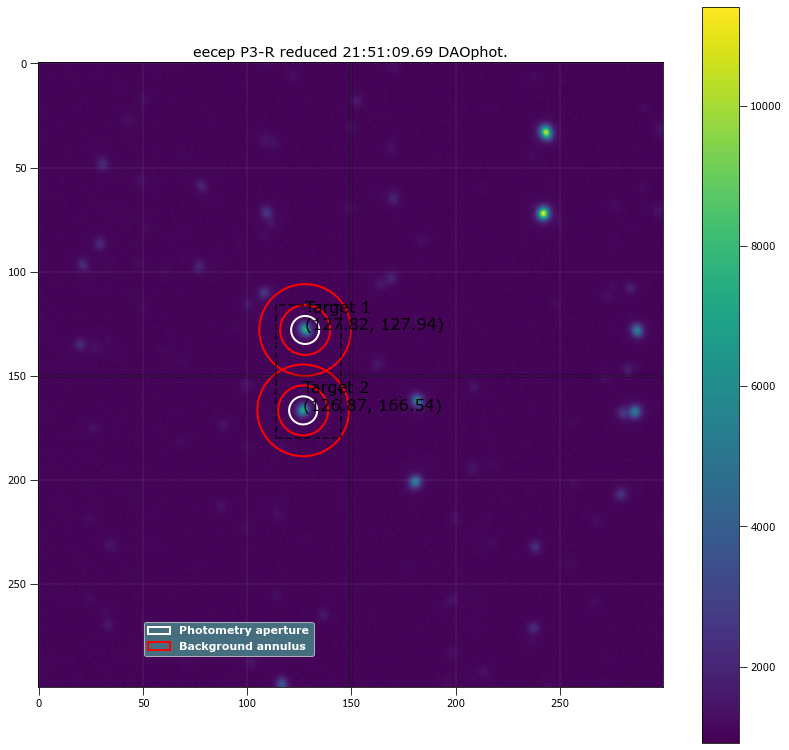

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.8194 127.93904 ...          3163.8341      1111136.8          3402.1641
  2 126.86815 166.53895 ...          3116.0296      1112281.9          3405.4727

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.8194 127.93904 ...                 2710.2629             165598.48
  2 126.86815 166.53895 ...                 2662.0174              161209.2

Write this out the excel
469 21:51:09.69 P3-R 20.0 6.732627118644068 127.8194016241587 127.93904358236988 165598.4788093297 2710.262948589776 126

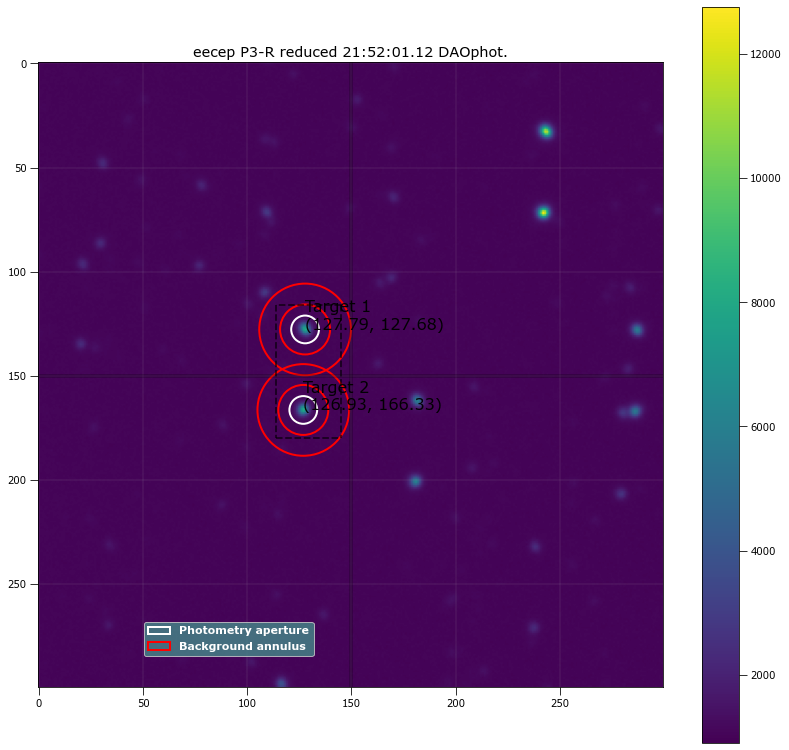

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.78848 127.68444 ...          3245.1063      1107270.6          3390.3656
  2 126.92911 166.33229 ...          3206.9023      1107536.2          3390.9706

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.78848 127.68444 ...                 2802.9535             167735.59
  2 126.92911 166.33229 ...                 2764.6706             162132.87

Write this out the excel
470 21:52:01.12 P3-R 20.0 6.658898305084746 127.78848073266839 127.68443786039157 167735.588746488 2802.953473332953 12

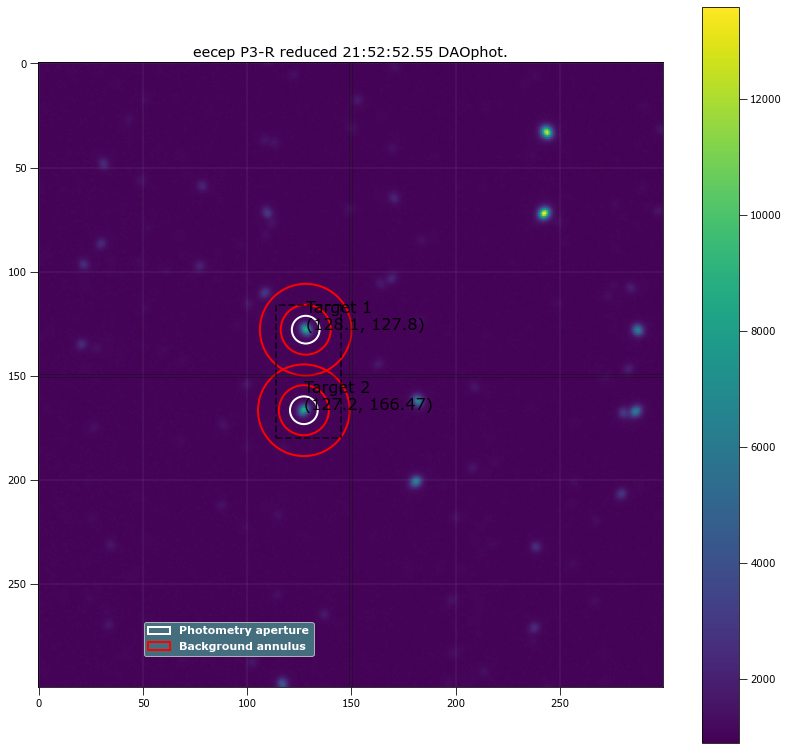

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09617  127.7996 ...          3365.9968      1103954.8          3380.4826
  2 127.19852 166.47168 ...          3313.3636      1104836.1          3382.9528

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09617  127.7996 ...                 2925.1329             169549.67
  2 127.19852 166.47168 ...                 2872.1775             163859.48

Write this out the excel
471 21:52:52.55 P3-R 20.0 6.658898305084746 128.09616770634676 127.79959590220297 169549.67060107525 2925.132864574689 

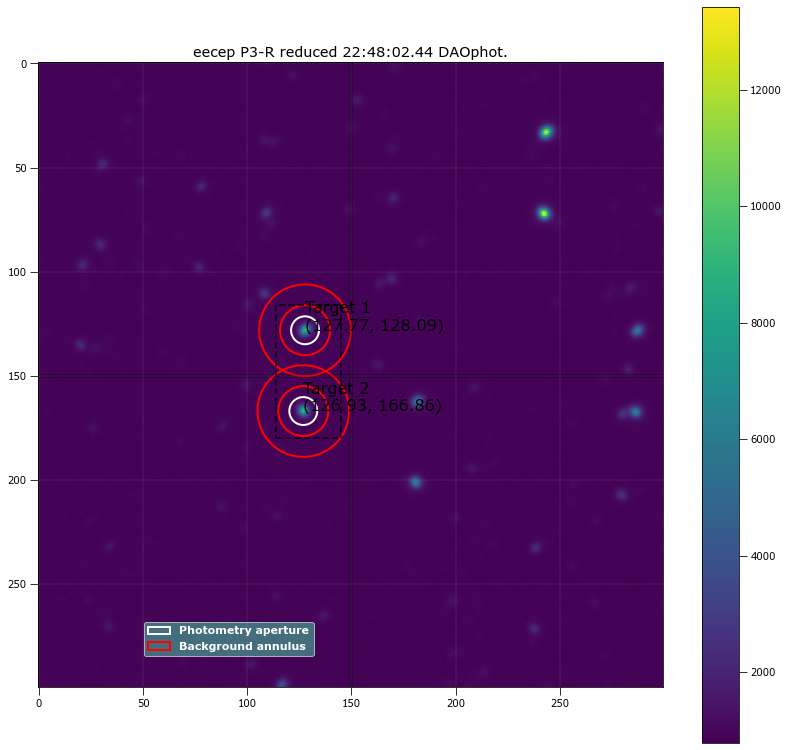

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7688 128.08648 ...          3347.6086      961271.78          2944.3553
  2 126.92786 166.86079 ...          3297.9272      959341.75          2938.2198

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7688 128.08648 ...                 2959.3586             179621.12
  2 126.92786 166.86079 ...                 2910.4863             174199.56

Write this out the excel
472 22:48:02.44 P3-R 20.0 6.695762711864406 127.76880438140047 128.08647763967895 179621.11680928635 2959.35864991154 12

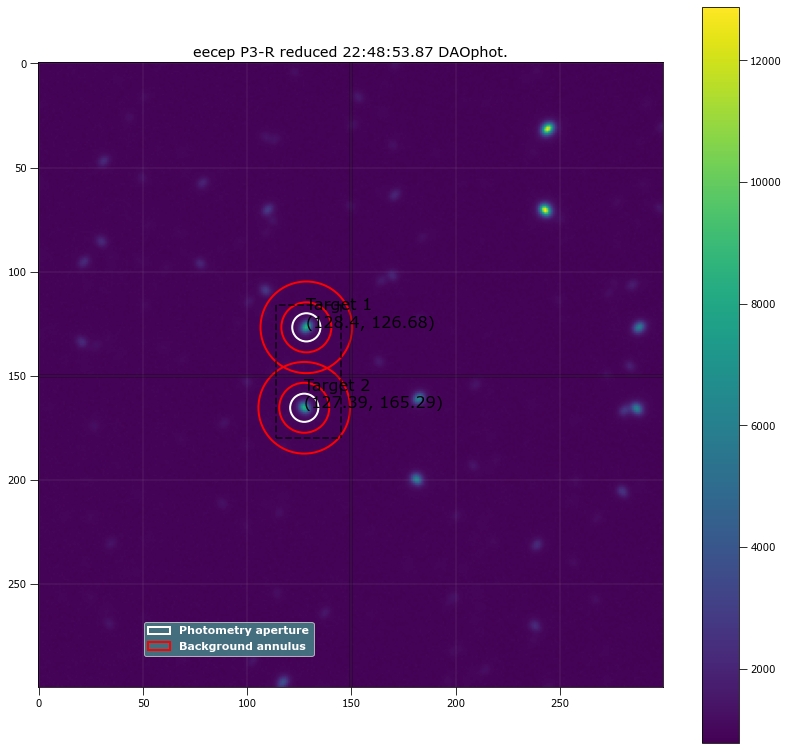

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.39534 126.67837 ...          3295.0055      962602.78          2948.2737
  2 127.39256 165.28869 ...           3225.855      962915.02          2949.1207

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.39534 126.67837 ...                 2897.6301             178114.85
  2 127.39256 165.28869 ...                 2828.3654             172547.14

Write this out the excel
473 22:48:53.87 P3-R 20.0 6.769491525423728 128.39534245480655 126.67837191593956 178114.8480103062 2897.630108971176 1

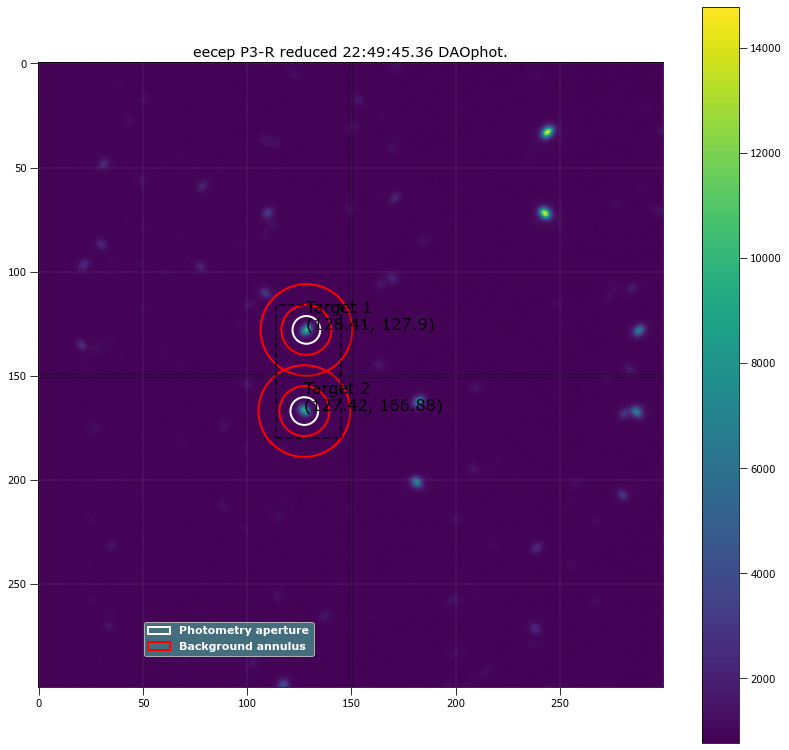

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.41297  127.8991 ...          3526.7323      958878.11          2937.1657
  2 127.41557 166.87757 ...          3421.9908      958798.62          2936.9057

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.41297  127.8991 ...                 3143.6834             181267.52
  2 127.41557 166.87757 ...                 3038.9757             174948.92

Write this out the excel
474 22:49:45.36 P3-R 20.0 6.658898305084746 128.4129673119547 127.89910332912548 181267.52100537444 3143.6833747188716 

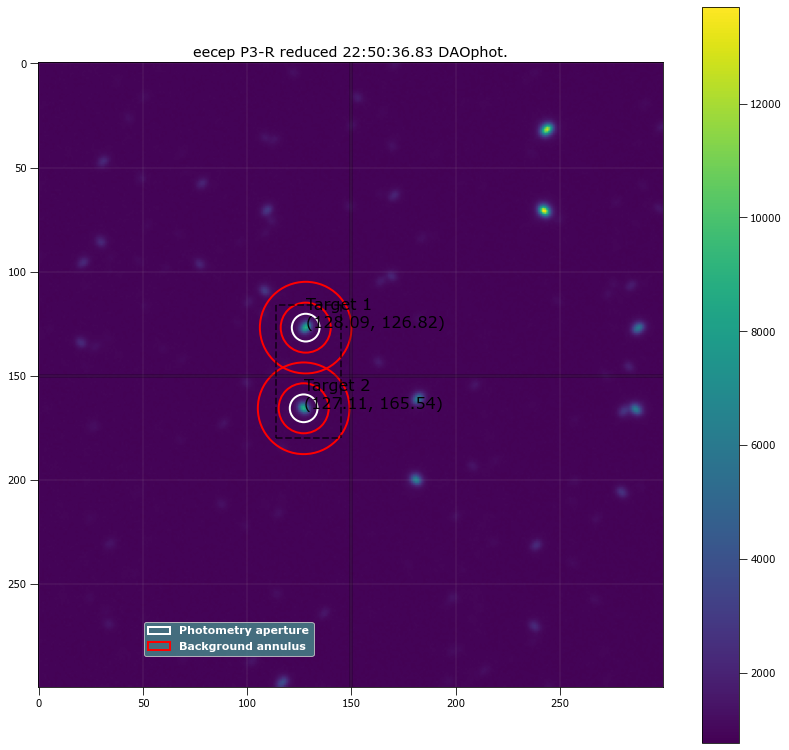

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08746 126.82118 ...          3335.4762      956399.31          2929.3854
  2 127.11194 165.53887 ...          3276.9076      957908.18          2933.8753

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08746 126.82118 ...                 2953.4419              179130.1
  2 127.11194 165.53887 ...                 2894.2878             172583.84

Write this out the excel
475 22:50:36.83 P3-R 20.0 6.658898305084746 128.08745992265412 126.8211836661573 179130.0970337055 2953.441869167044 12

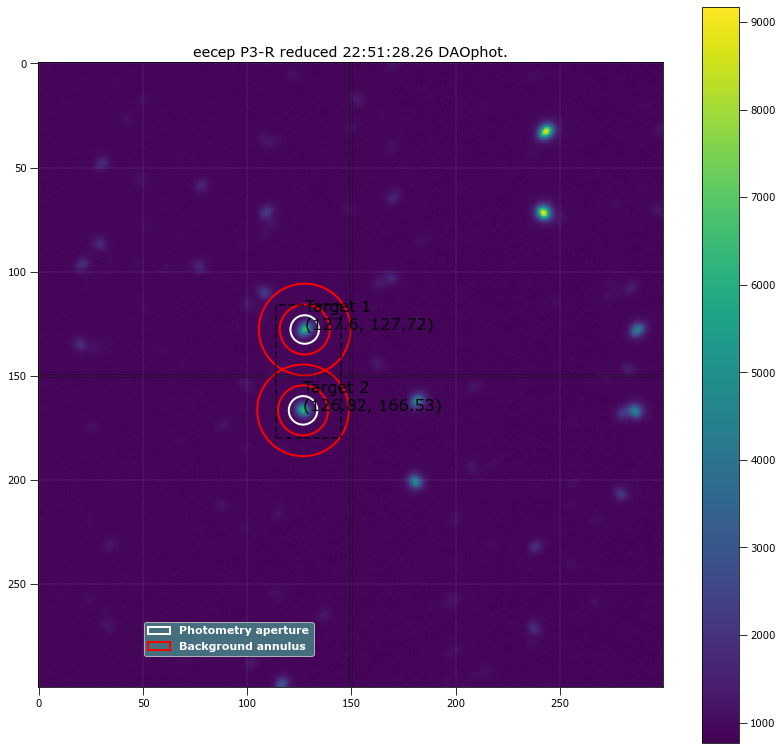

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.59922 127.71616 ...          2974.3352      953952.01          2921.6493
  2 126.81697 166.52848 ...          2897.8587      952057.37          2915.3205

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.59922 127.71616 ...                 2571.9239             174310.85
  2 126.81697 166.52848 ...                 2496.3191             168263.09

Write this out the excel
476 22:51:28.26 P3-R 20.0 6.84322033898305 127.59922049382084 127.71615902591996 174310.8544864973 2571.923850721577 126

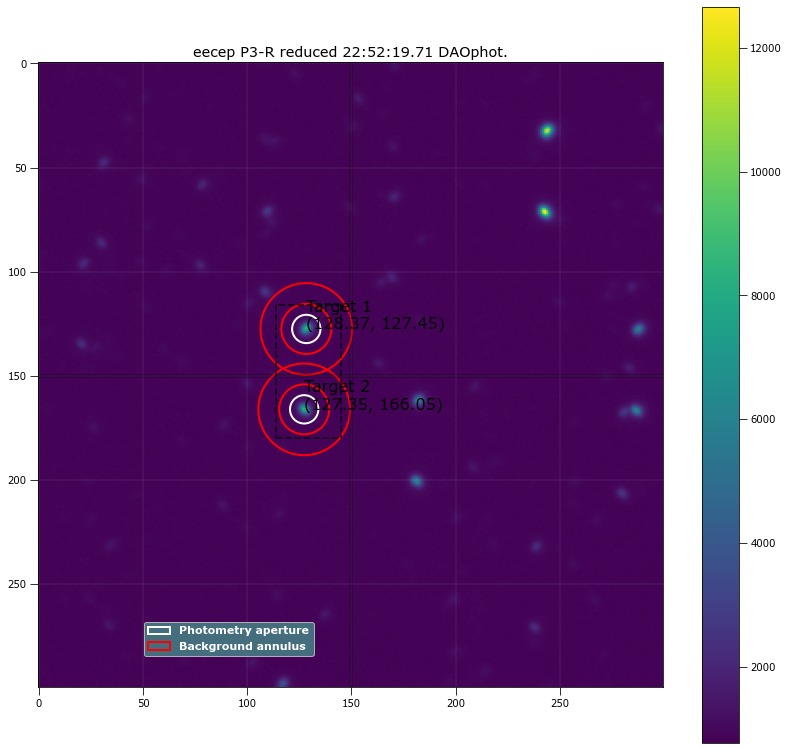

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.37496 127.45409 ...          3246.5084      952317.77           2916.993
  2 127.35402  166.0462 ...          3198.9597         949493          2908.0091

 Aperture are: 145.53893261452635 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.37496 127.45409 ...                 2849.0554             177054.83
  2 127.35402  166.0462 ...                 2802.7308             171576.29

Write this out the excel
477 22:52:19.71 P3-R 20.0 6.806355932203389 128.37496383172805 127.45409160049346 177054.83114153807 2849.0553981783 12

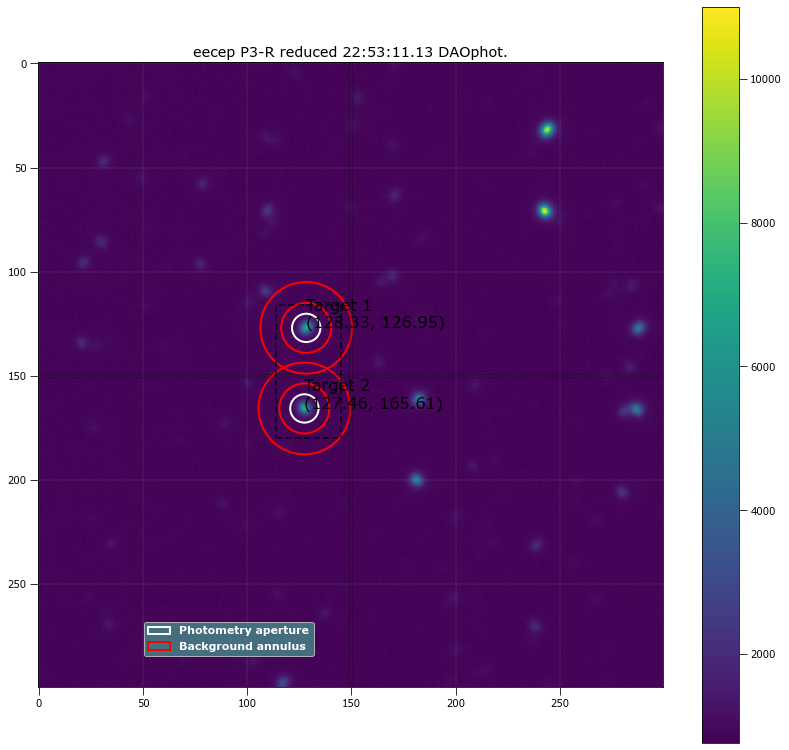

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.32936 126.94705 ...          3052.3513       951744.7          2914.7826
  2  127.4565 165.61244 ...          3026.8817      949694.18          2908.3096

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.32936 126.94705 ...                 2655.1995             174273.87
  2  127.4565 165.61244 ...                 2630.6118             169268.87

Write this out the excel
478 22:53:11.13 P3-R 20.0 6.80635593220339 128.3293580437107 126.94704502366406 174273.8677484676 2655.1994996567255 127

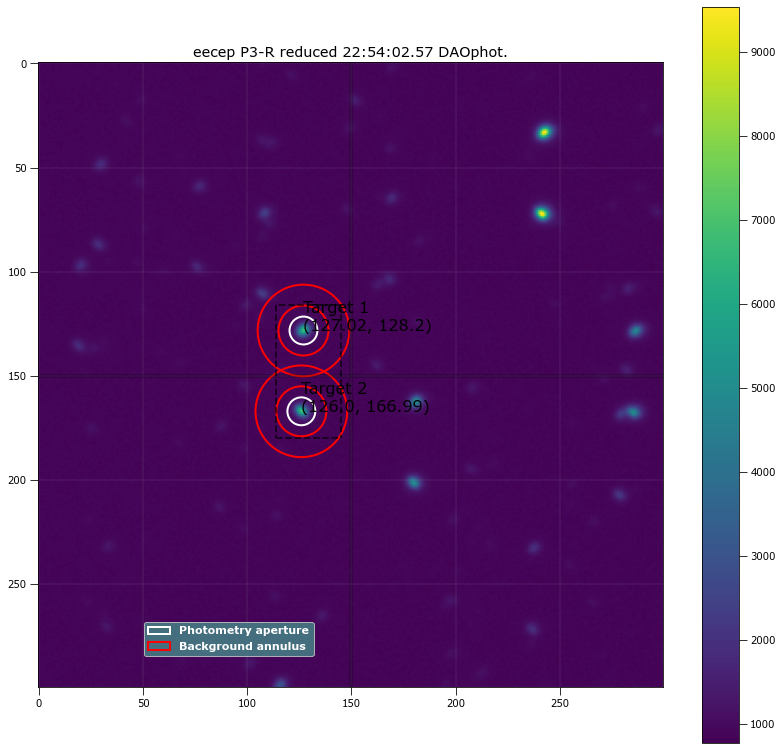

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.01947 128.19909 ...          3016.9226      947244.49          2901.1102
  2 126.00079 166.98704 ...          2979.7773      944306.04          2891.6072

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.01947 128.19909 ...                 2634.3751             174192.47
  2 126.00079 166.98704 ...                 2598.4829             169913.97

Write this out the excel
479 22:54:02.57 P3-R 20.0 6.695762711864407 127.01947348294851 128.1990929373926 174192.46972743317 2634.3750693820925 

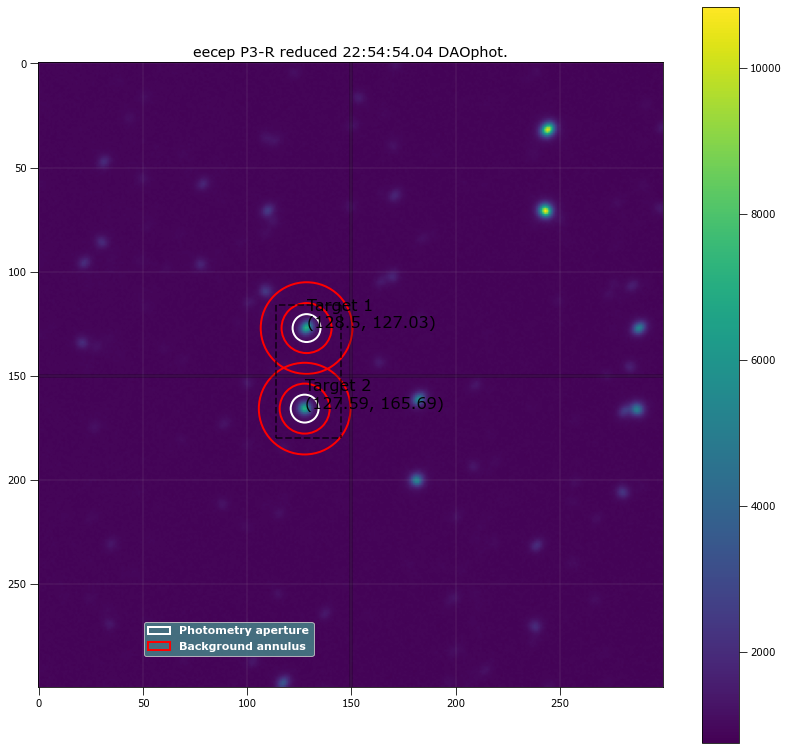

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.4984 127.03174 ...          3071.2819      942467.45          2886.4066
  2 127.58945 165.69239 ...           3006.189      941251.19          2882.4072

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.4984 127.03174 ...                 2690.6732             176284.07
  2 127.58945 165.69239 ...                 2626.1077             170631.56

Write this out the excel
480 22:54:54.04 P3-R 20.0 6.695762711864407 128.49840077340048 127.03173965836459 176284.06755102574 2690.673242900824 

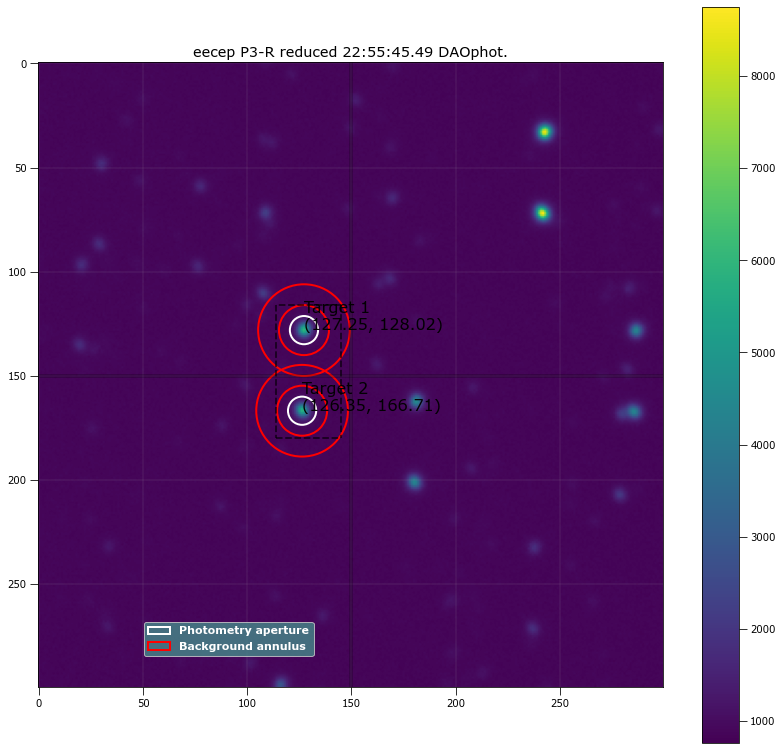

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.25418 128.01561 ...          2921.0314      943155.97          2888.4526
  2 126.35272  166.7071 ...          2849.6481      940459.91          2879.7464

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.25418 128.01561 ...                 2531.7189             174058.46
  2 126.35272  166.7071 ...                  2461.509              168592.3

Write this out the excel
481 22:55:45.49 P3-R 20.0 6.769491525423728 127.25418238333624 128.01560647809762 174058.4596293468 2531.718867206111 1

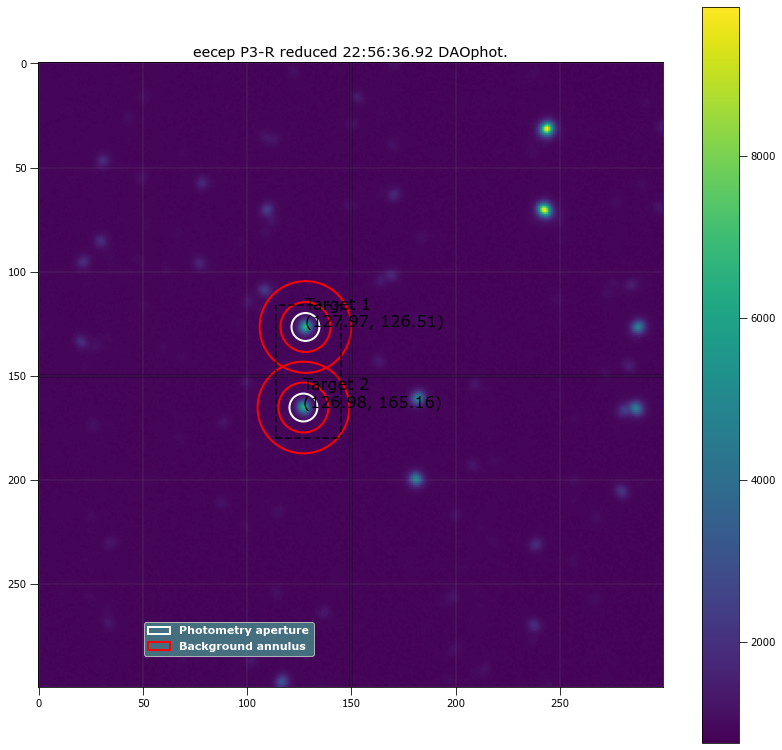

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.96678 126.51166 ...          2996.9655      944290.99          2892.1789
  2 126.97902 165.16437 ...          2909.5272      940522.49          2880.0065

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.96678 126.51166 ...                 2615.5956             174182.19
  2 126.97902 165.16437 ...                 2529.7624             168354.51

Write this out the excel
482 22:56:36.92 P3-R 20.0 6.695762711864407 127.9667812160995 126.51166484244614 174182.18821774976 2615.5956238250105 

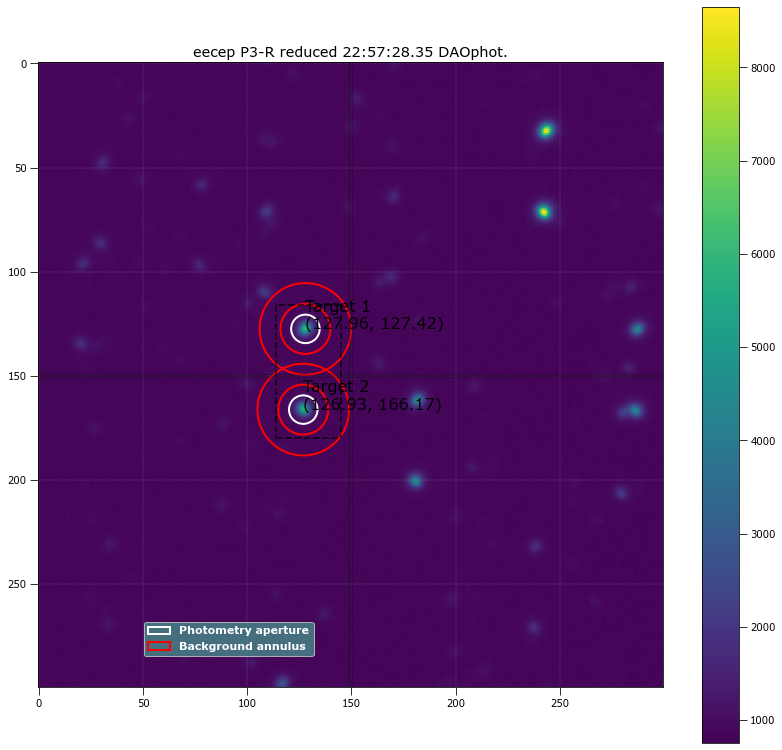

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.95805 127.42443 ...          2865.6279      941899.11          2884.3664
  2 126.92654 166.16782 ...          2809.6985      940165.98          2878.7965

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.95805 127.42443 ...                 2468.3517             169452.93
  2 126.92654 166.16782 ...                 2413.1895             165189.61

Write this out the excel
483 22:57:28.35 P3-R 20.0 6.84322033898305 127.9580529142125 127.42442679966304 169452.92676033103 2468.351737143651 126

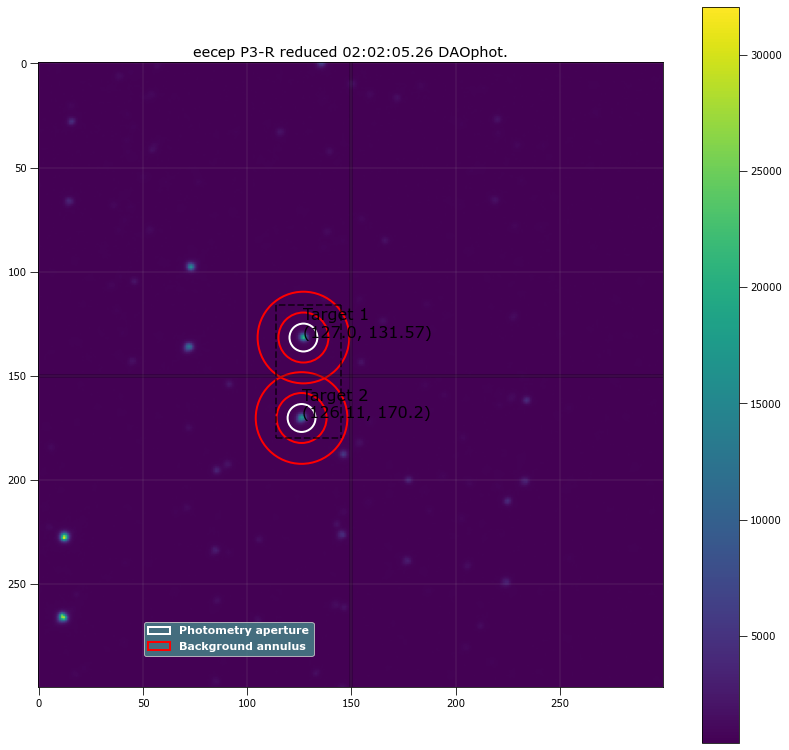

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.00248 131.57013 ...          4897.2032      540008.19          1660.9419
  2 126.10533 170.19958 ...          4440.2158      535935.67           1649.628

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.00248 131.57013 ...                 4678.1873             216588.67
  2 126.10533 170.19958 ...                 4222.6918             211812.85

Write this out the excel
484 02:02:05.26 P3-R 20.0 6.695762711864406 127.00247602819019 131.57013111441233 216588.66828991091 4678.18731974626 12

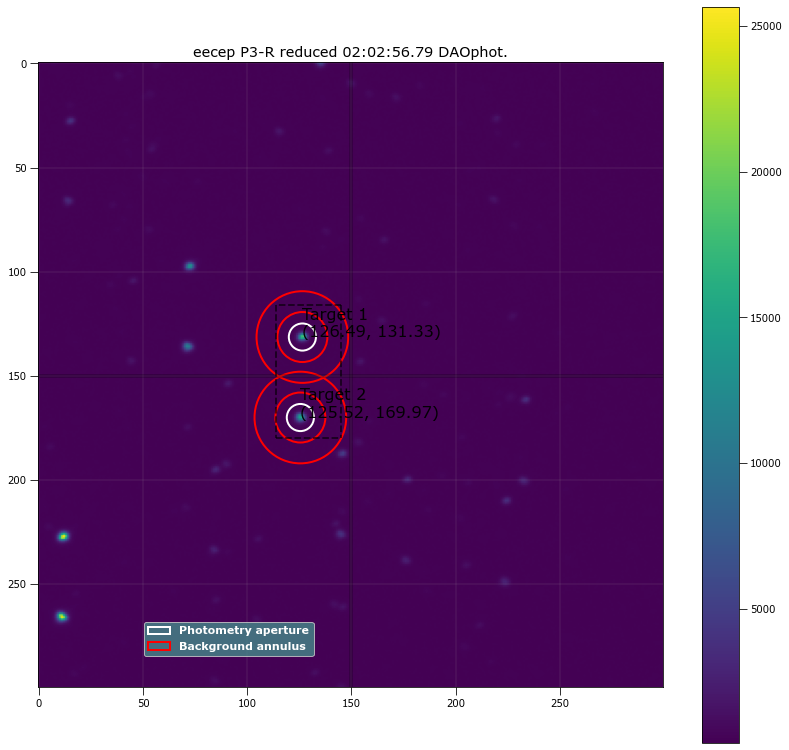

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  126.4945 131.33258 ...          4670.6944      537491.54          1652.1617
  2 125.52332 169.97221 ...          4237.6539      534120.39          1641.9786

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  126.4945 131.33258 ...                 4464.6657             216335.74
  2 125.52332 169.97221 ...                  4032.895             210998.16

Write this out the excel
485 02:02:56.79 P3-R 20.0 6.511440677966101 126.49450450099526 131.3325751538777 216335.74055136403 4464.665687082369 1

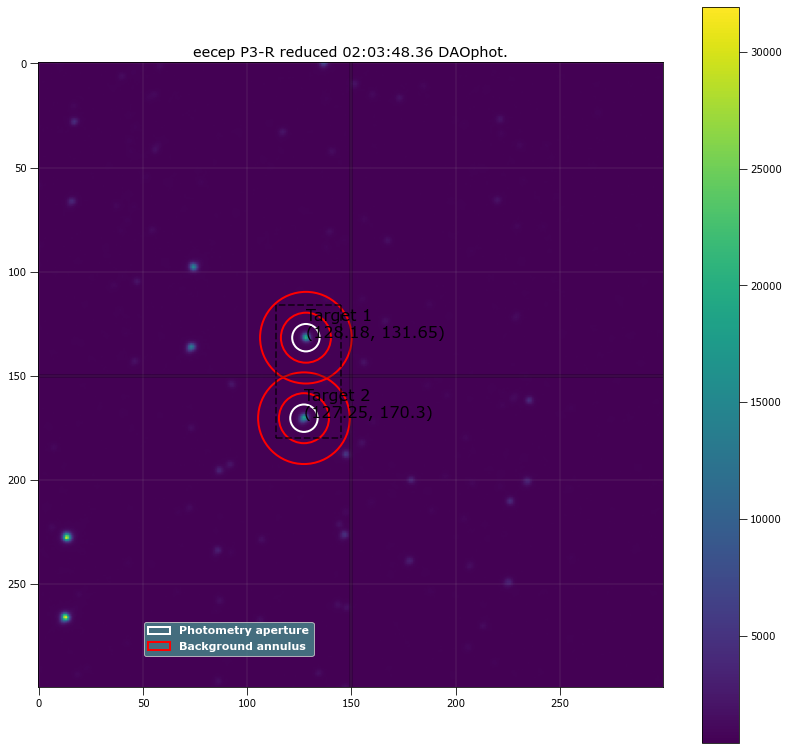

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.18264 131.64661 ...          4858.6548      538412.35           1655.665
  2 127.24871 170.29769 ...          4587.0503      535469.83          1647.8399

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.18264 131.64661 ...                 4647.4872             216849.04
  2 127.24871 170.29769 ...                 4376.8807             212783.41

Write this out the excel
486 02:03:48.36 P3-R 20.0 6.5851694915254235 128.18263626603138 131.64660904365377 216849.03658997873 4647.487153767929

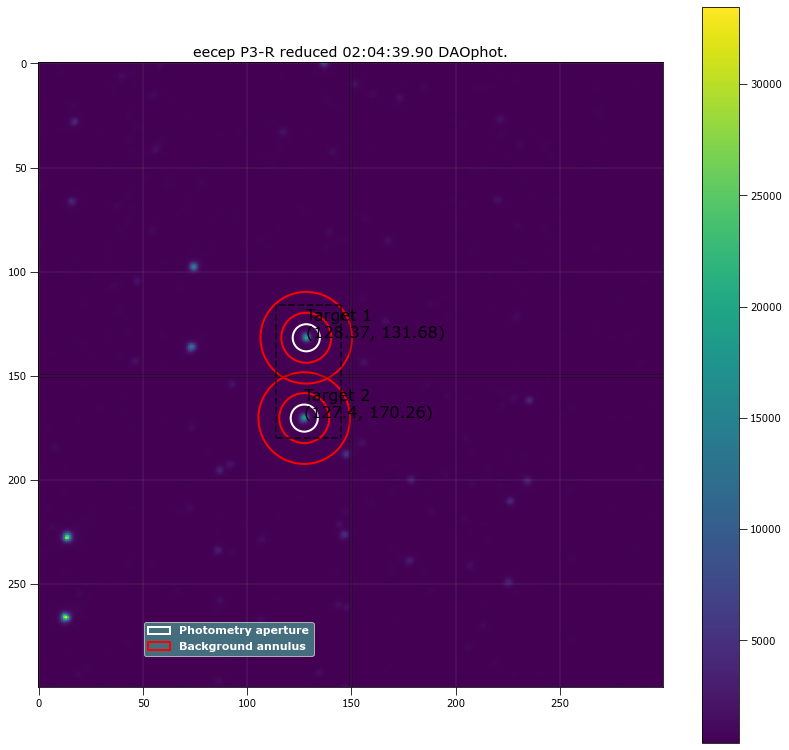

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.36606 131.68134 ...          4918.3991       533717.5          1642.1947
  2 127.39915 170.25649 ...          4612.3349      532388.45          1638.7972

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.36606 131.68134 ...                 4713.6133              216992.6
  2 127.39915 170.25649 ...                 4407.9728             211707.31

Write this out the excel
487 02:04:39.90 P3-R 20.0 6.511440677966101 128.36606233539246 131.68133971077904 216992.5971204312 4713.613258089949 1

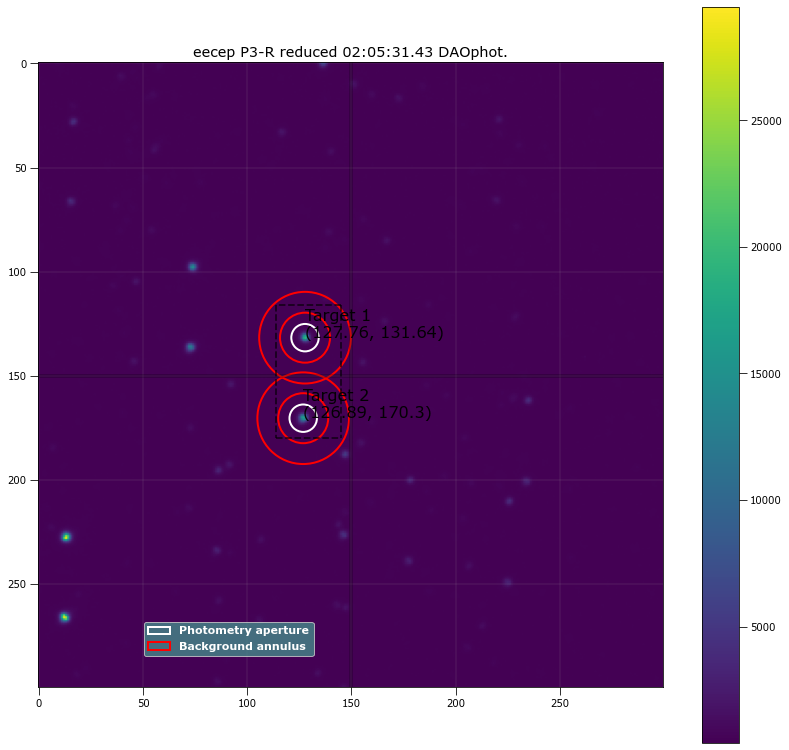

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.75912 131.63958 ...          4776.7479       534497.8           1643.468
  2 126.88877 170.29709 ...          4423.9543       530683.1          1632.9139

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.75912 131.63958 ...                 4567.1358             216223.27
  2 126.88877 170.29709 ...                 4215.6884             211152.58

Write this out the excel
488 02:05:31.43 P3-R 20.0 6.5851694915254235 127.75911936983856 131.63958442082173 216223.2695328205 4567.13584864767 1

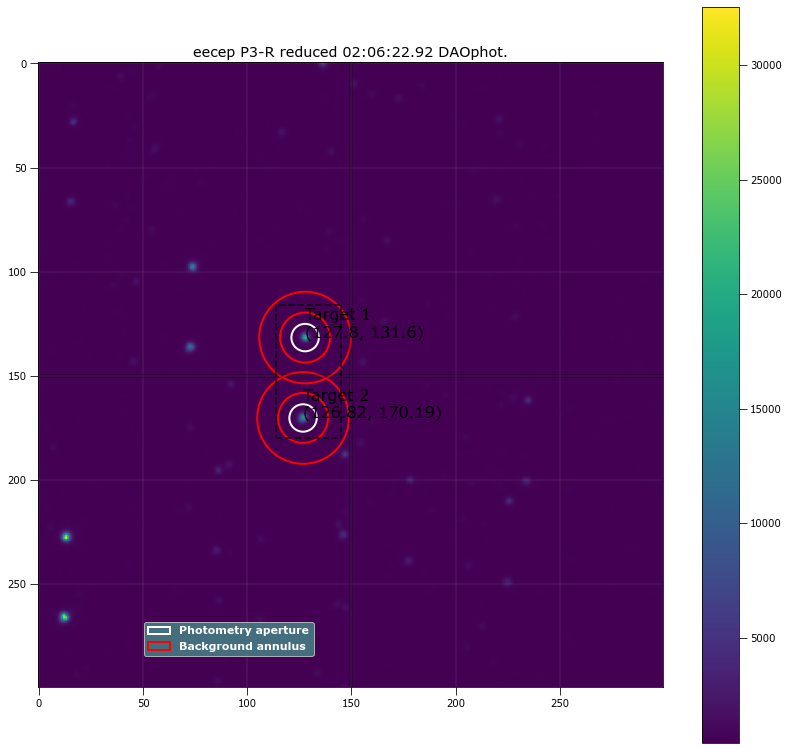

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.80394 131.59542 ...          4906.1766      534811.58          1645.6951
  2 126.82168 170.19141 ...          4426.6165      532272.45          1638.2043

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.80394 131.59542 ...                 4696.2805             216340.01
  2 126.82168 170.19141 ...                 4217.6758             211644.99

Write this out the excel
489 02:06:22.92 P3-R 20.0 6.5851694915254235 127.8039350887482 131.59541678089352 216340.00832776562 4696.280502354987 

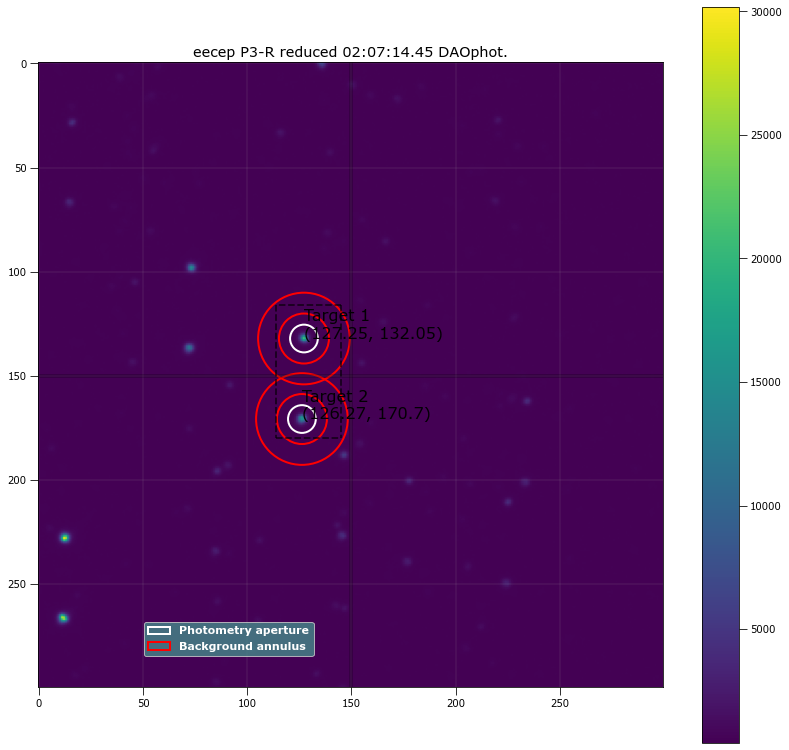

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.24923 132.04501 ...           4858.158      533432.94          1640.6853
  2 126.26899 170.69518 ...          4359.4289      530923.13          1633.5388

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.24923 132.04501 ...                 4644.1889             217408.64
  2 126.26899 170.69518 ...                 4146.3918             211554.95

Write this out the excel
490 02:07:14.45 P3-R 20.0 6.658898305084746 127.24922561116048 132.04501010428768 217408.64130702944 4644.188899504681 

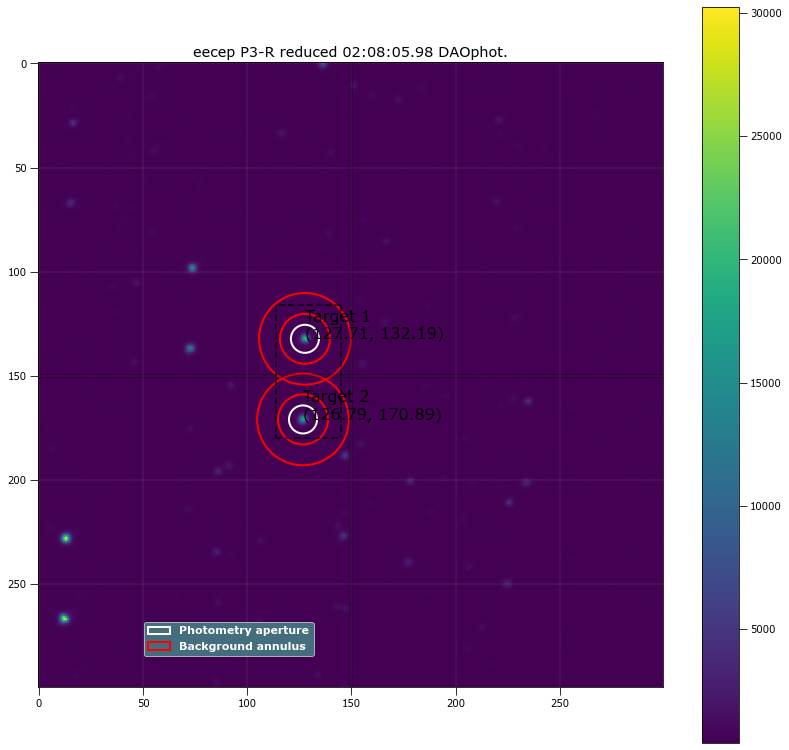

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.71167 132.19021 ...          4847.0449      532668.64          1638.1989
  2 126.79201 170.89159 ...          4462.0315      529587.18          1629.9128

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.71167 132.19021 ...                 4628.6428             217274.71
  2 126.79201 170.89159 ...                  4244.734             212895.91

Write this out the excel
491 02:08:05.98 P3-R 20.0 6.732627118644068 127.7116712373008 132.1902135927698 217274.71373199328 4628.642769148983 126

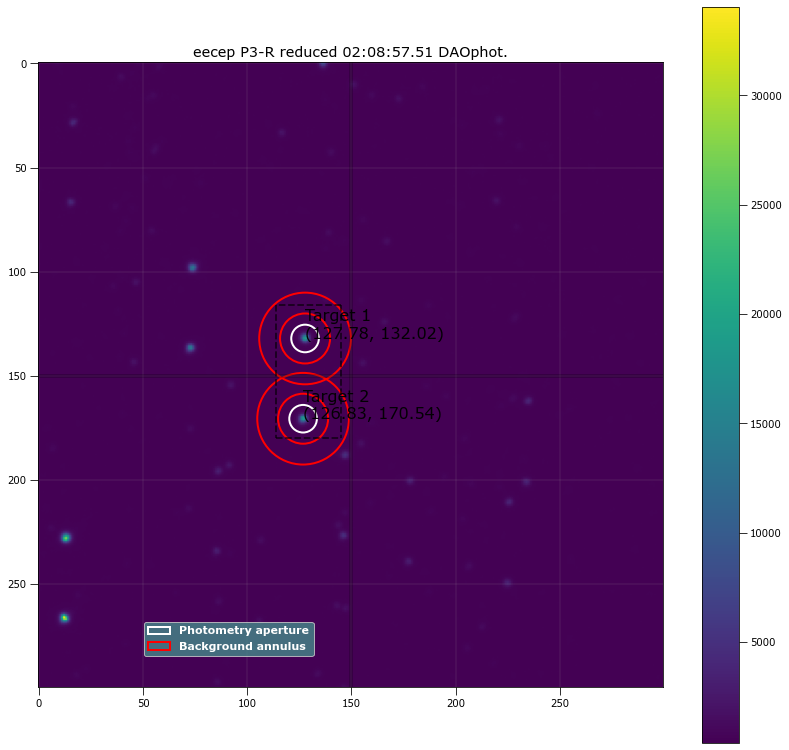

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7758 132.02217 ...          4712.7857      531381.57           1634.652
  2 126.83404  170.5442 ...          4663.5892      527768.79          1624.1857

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7758 132.02217 ...                 4501.9573             217432.33
  2 126.83404  170.5442 ...                 4454.1107             211641.62

Write this out the excel
492 02:08:57.51 P3-R 20.0 6.622033898305084 127.77579924149332 132.02216812822286 217432.33451916234 4501.957266595039 

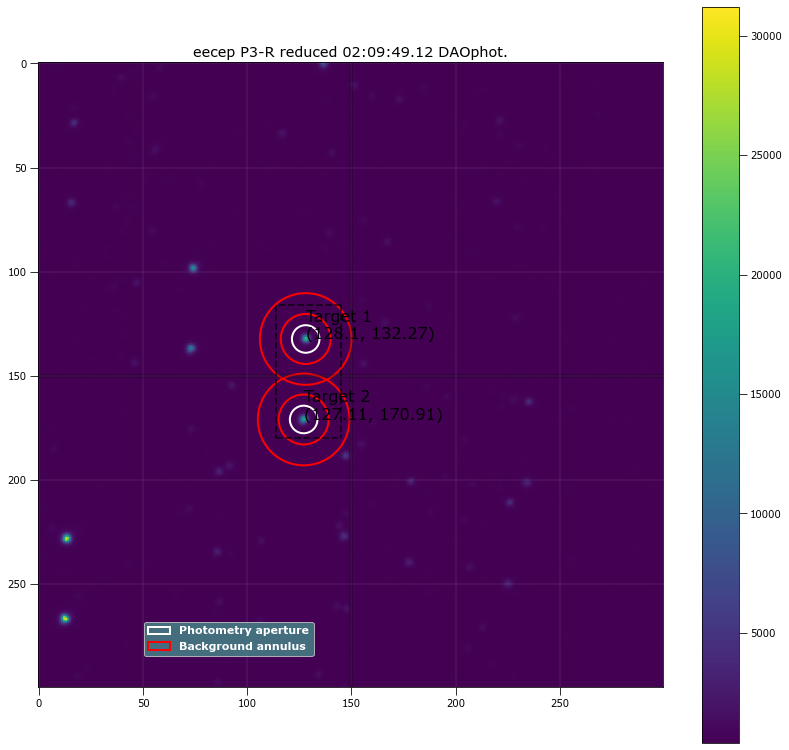

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09596 132.26669 ...          4987.3376      530118.58          1631.1433
  2 127.11175  170.9116 ...          4645.5231       527225.2          1622.8318

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09596 132.26669 ...                 4776.9617             218318.01
  2 127.11175  170.9116 ...                 4436.2191             214115.61

Write this out the excel
493 02:09:49.12 P3-R 20.0 6.622033898305084 128.09596247293044 132.26669355759165 218318.00959444477 4776.961707094084 

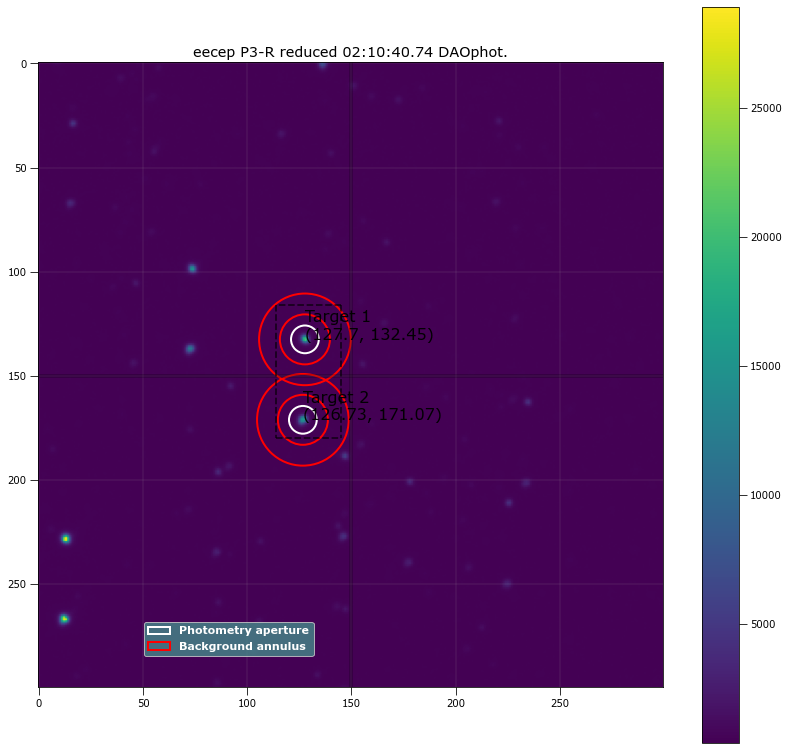

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.70279  132.4525 ...          4929.3198      528190.24          1624.7824
  2 126.73028 171.06915 ...          4389.4098       524869.9          1615.2233

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.70279  132.4525 ...                 4717.4247             218041.17
  2 126.73028 171.06915 ...                 4178.7613             212710.34

Write this out the excel
494 02:10:40.74 P3-R 20.0 6.658898305084746 127.70279396007398 132.45250190623653 218041.16768857275 4717.424674601635 

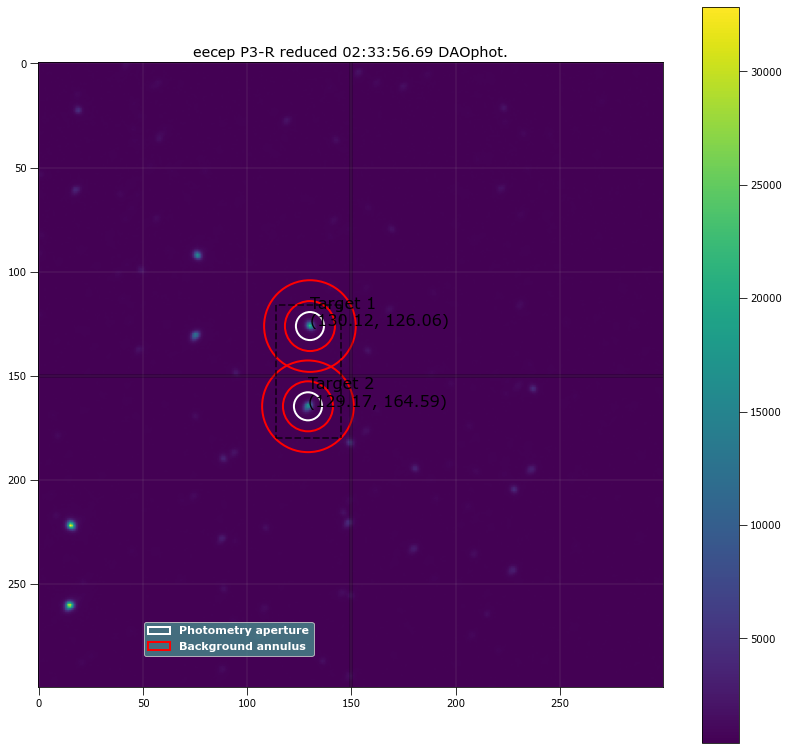

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.11778 126.06252 ...          4984.7198      543544.82          1672.6272
  2 129.16677 164.58714 ...           4488.386      539393.45          1659.4776

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.11778 126.06252 ...                 4761.7278             219901.64
  2 129.16677 164.58714 ...                  4267.147             213944.07

Write this out the excel
495 02:33:56.69 P3-R 20.0 6.732627118644068 130.11778423465506 126.06251982288745 219901.6426076468 4761.727776747677 12

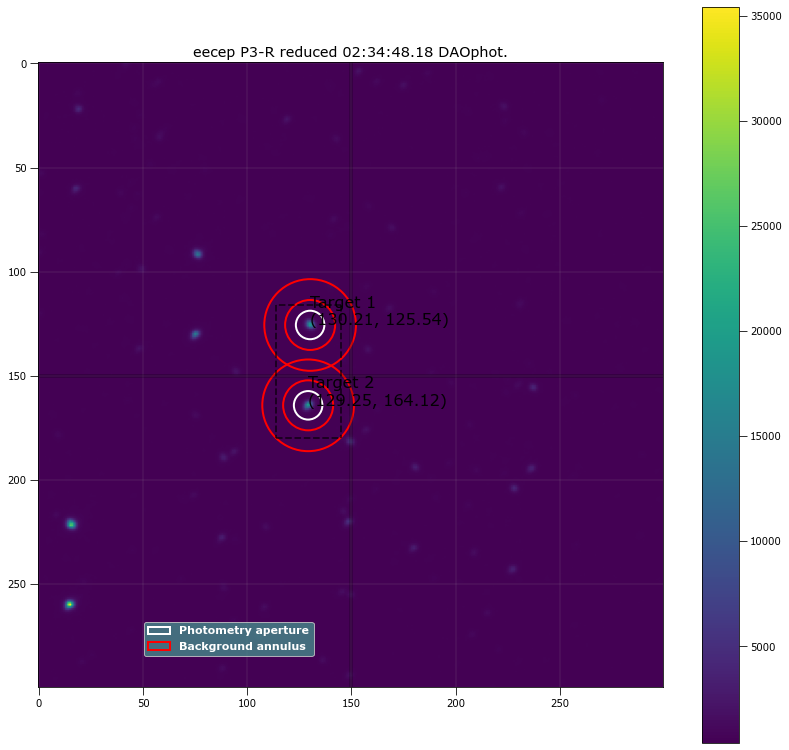

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.20853 125.54439 ...          4769.6745      551161.29          1695.9128
  2 129.25217 164.11592 ...          4679.0967      547349.19           1684.411

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.20853 125.54439 ...                 4536.0891             221337.94
  2 129.25217 164.11592 ...                 4447.0955             215375.88

Write this out the excel
496 02:34:48.18 P3-R 20.0 6.84322033898305 130.20852506632022 125.54439240448541 221337.93744831896 4536.0890953855405 1

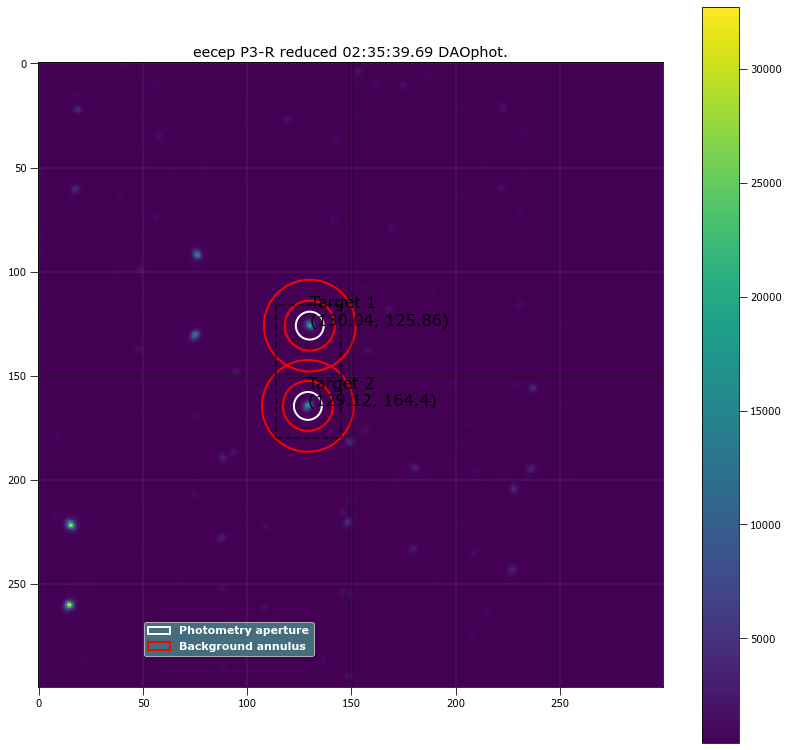

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.04202  125.8584 ...          4955.6802      558008.45          1717.2191
  2  129.1177 164.39968 ...           4588.514      553212.56           1702.051

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.04202  125.8584 ...                 4729.2435             219620.94
  2  129.1177 164.39968 ...                 4364.0774             214625.88

Write this out the excel
497 02:35:39.69 P3-R 20.0 6.695762711864406 130.0420225308195 125.85840223628078 219620.94114103942 4729.2434607508585 1

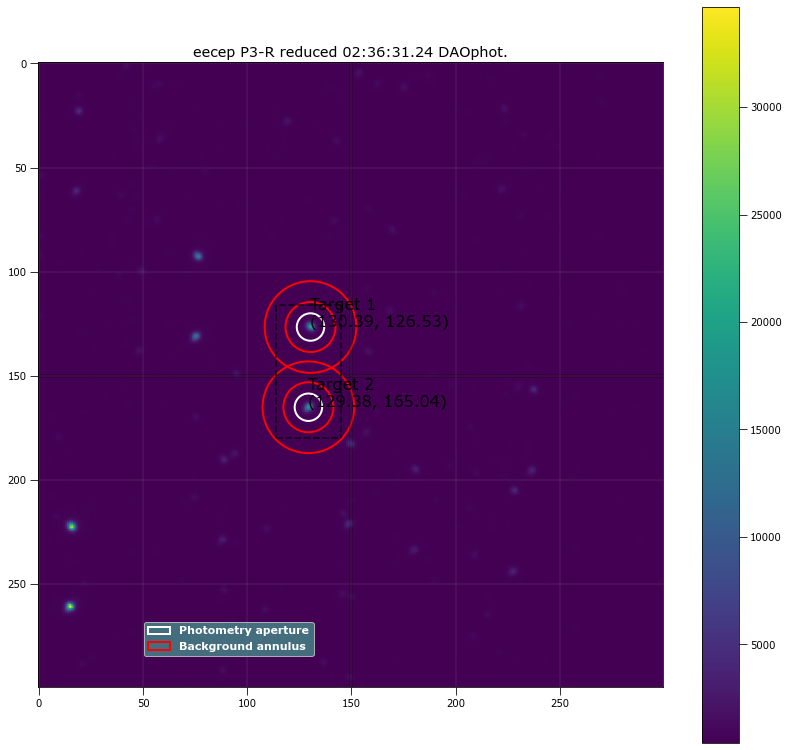

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.38772 126.52992 ...          5029.4817      563608.97          1734.4947
  2 129.37888  165.0353 ...          4719.2821      559724.71          1722.0827

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.38772 126.52992 ...                 4808.2599             221094.38
  2 129.37888  165.0353 ...                 4499.6433             215019.46

Write this out the excel
498 02:36:31.24 P3-R 20.0 6.5851694915254235 130.38772369262358 126.52991756227082 221094.3768287389 4808.259865382448 

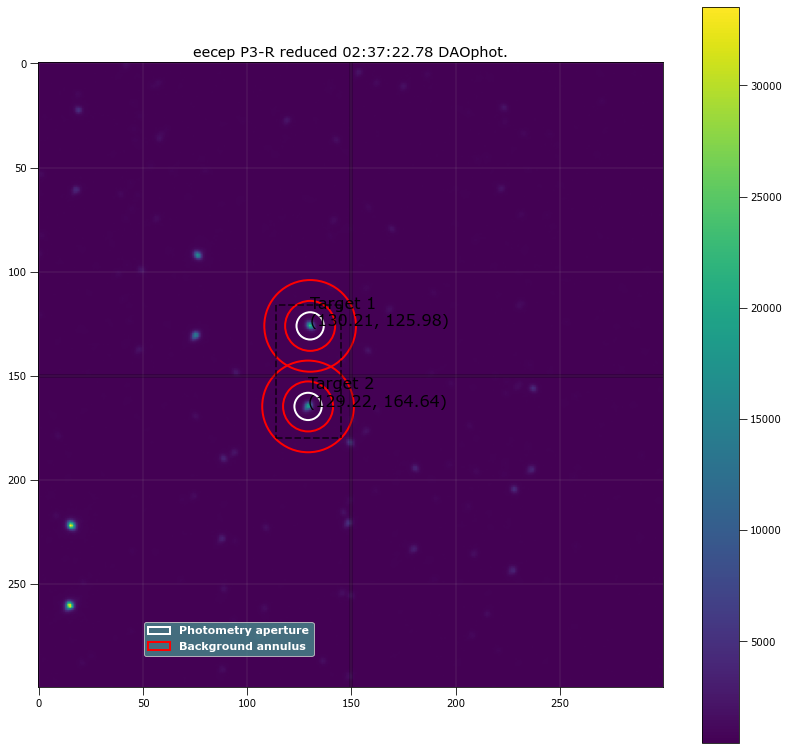

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.21371 125.97579 ...          5205.2386      573022.05          1763.5477
  2 129.21599 164.64295 ...          4847.8059      569615.53          1753.5131

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.21371 125.97579 ...                 4982.8225             221647.32
  2 129.21599 164.64295 ...                 4626.6554              215837.9

Write this out the excel
499 02:37:22.78 P3-R 20.0 6.5483050847457624 130.21371334849016 125.97579147244176 221647.31884741038 4982.822535623973

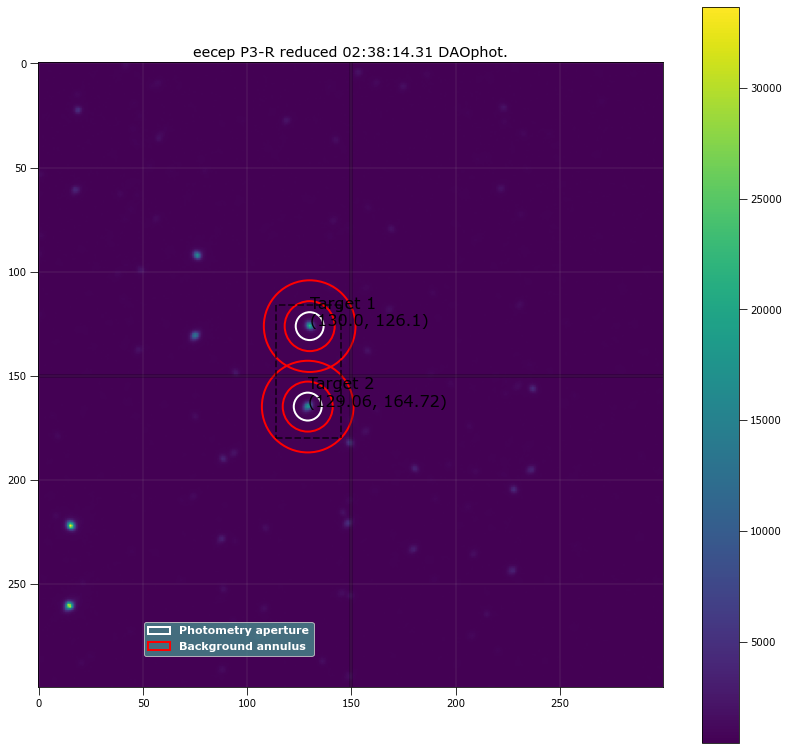

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.99519 126.10066 ...          5059.4176      580646.01           1786.017
  2 129.05718 164.72282 ...          4640.0058       578147.4          1778.2229

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.99519 126.10066 ...                  4823.909             220047.59
  2 129.05718 164.72282 ...                 4405.5249             214552.44

Write this out the excel
500 02:38:14.31 P3-R 20.0 6.695762711864406 129.99519251963173 126.10066360951203 220047.59324885975 4823.9089954423125 

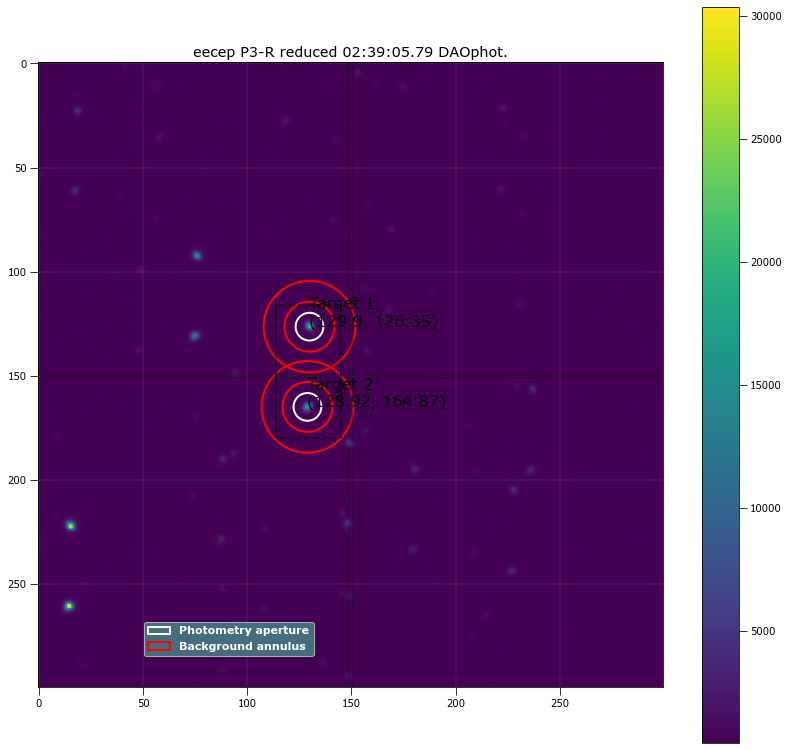

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.90166 126.34907 ...          5042.4802      592636.79          1822.5819
  2 128.91944 164.87148 ...          4623.6031      589822.16          1813.5333

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.90166 126.34907 ...                 4804.7891             221197.99
  2 128.91944 164.87148 ...                 4387.0921             215622.13

Write this out the excel
501 02:39:05.79 P3-R 20.0 6.658898305084746 129.90165740495502 126.34907350474491 221197.98526812508 4804.789081692388 

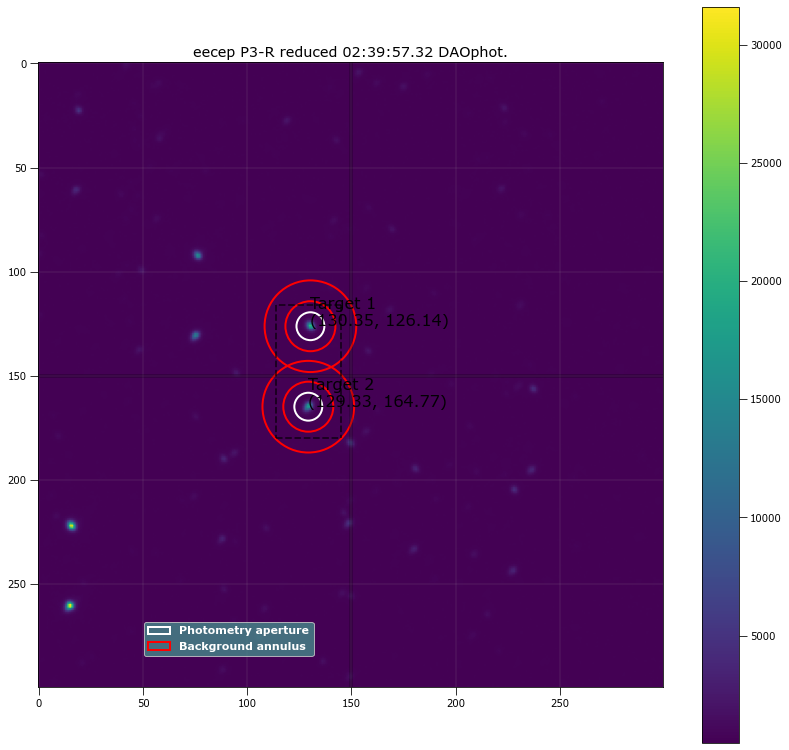

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.35125 126.14181 ...          5029.3799      604651.76          1859.5975
  2  129.3309 164.77074 ...          4646.7724      601999.92          1851.2519

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.35125 126.14181 ...                 4784.1688             222238.38
  2  129.3309 164.77074 ...                 4402.6618             216222.99

Write this out the excel
502 02:39:57.32 P3-R 20.0 6.695762711864406 130.35124543492742 126.14181253583412 222238.38096745615 4784.168808998589 1

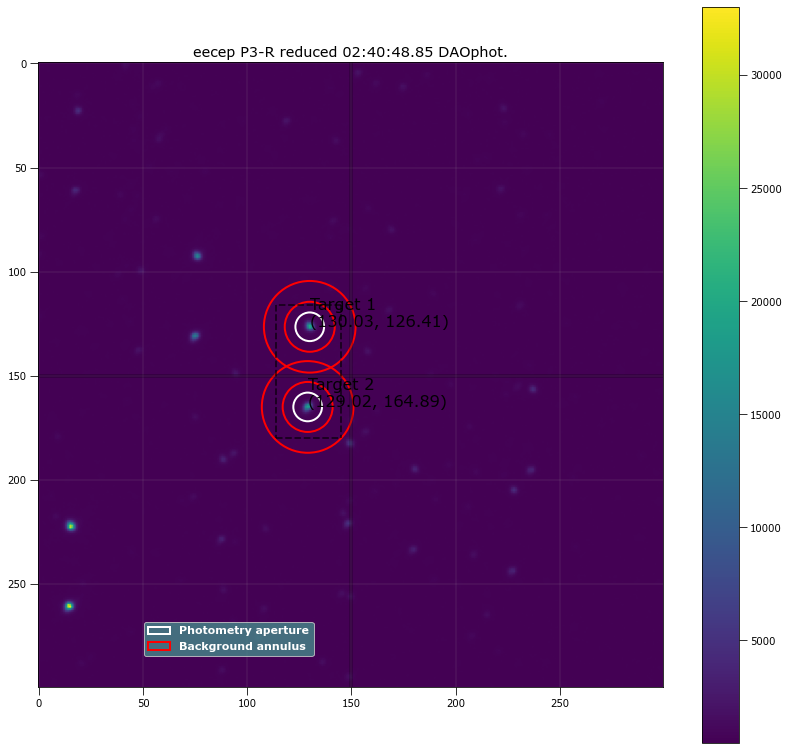

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.02585 126.41008 ...          5034.0542      619202.44          1903.7902
  2  129.0238  164.8909 ...           4786.993      615956.72          1893.5909

 Aperture are: 148.70906674116122 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.02585 126.41008 ...                 4769.0043             222677.92
  2  129.0238  164.8909 ...                  4523.363             217305.21

Write this out the excel
503 02:40:48.85 P3-R 20.0 6.880084745762712 130.02585302184823 126.41008066216078 222677.9150156772 4769.004253701556 1

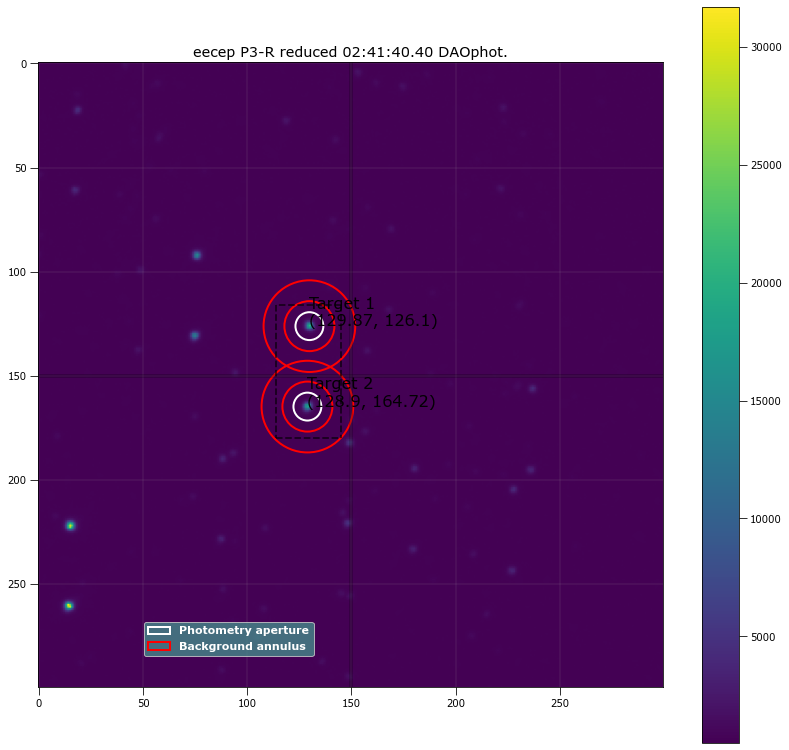

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.86561 126.10418 ...          4937.4031      635090.95          1951.8081
  2 128.90218 164.72372 ...          4703.2822       630235.8          1937.0247

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.86561 126.10418 ...                 4680.0329              221423.8
  2 128.90218 164.72372 ...                 4447.8613             215684.13

Write this out the excel
504 02:41:40.40 P3-R 20.0 6.695762711864407 129.86561473752775 126.10418335811336 221423.8039480063 4680.032885681228 1

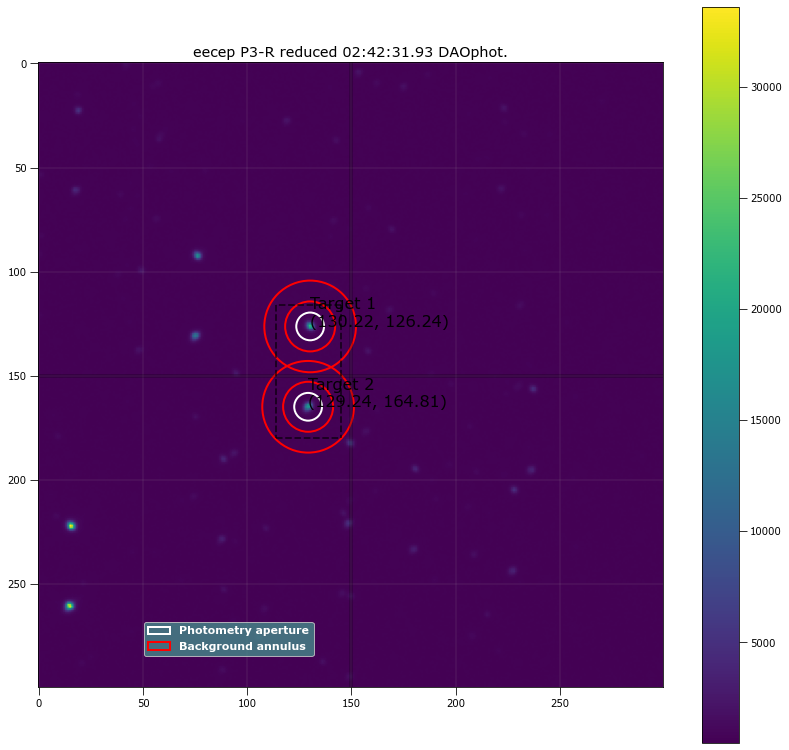

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.21865 126.23546 ...          5265.8263      651390.72          2002.3769
  2 129.23909 164.81046 ...          4789.7714      647867.61          1991.4293

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.21865 126.23546 ...                 5004.6873             222891.02
  2 129.23909 164.81046 ...                 4530.0601             216959.47

Write this out the excel
505 02:42:31.93 P3-R 20.0 6.658898305084746 130.21865073858137 126.2354552886272 222891.02360884298 5004.68732880333 12

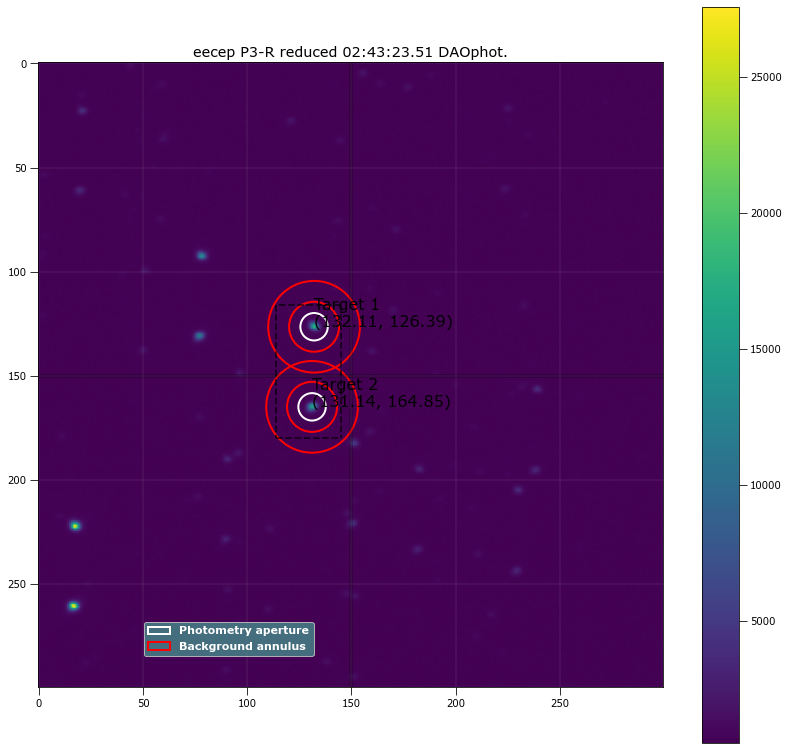

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.10626 126.39155 ...          4738.1873      672404.31          2065.1713
  2 131.13967  164.8452 ...           4421.746      668958.31          2054.3742

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.10626 126.39155 ...                 4474.7902             221684.92
  2 131.13967  164.8452 ...                 4159.7259             215170.04

Write this out the excel
506 02:43:23.51 P3-R 20.0 6.5851694915254235 132.10625709799803 126.3915547844488 221684.92060216007 4474.79018933007 1

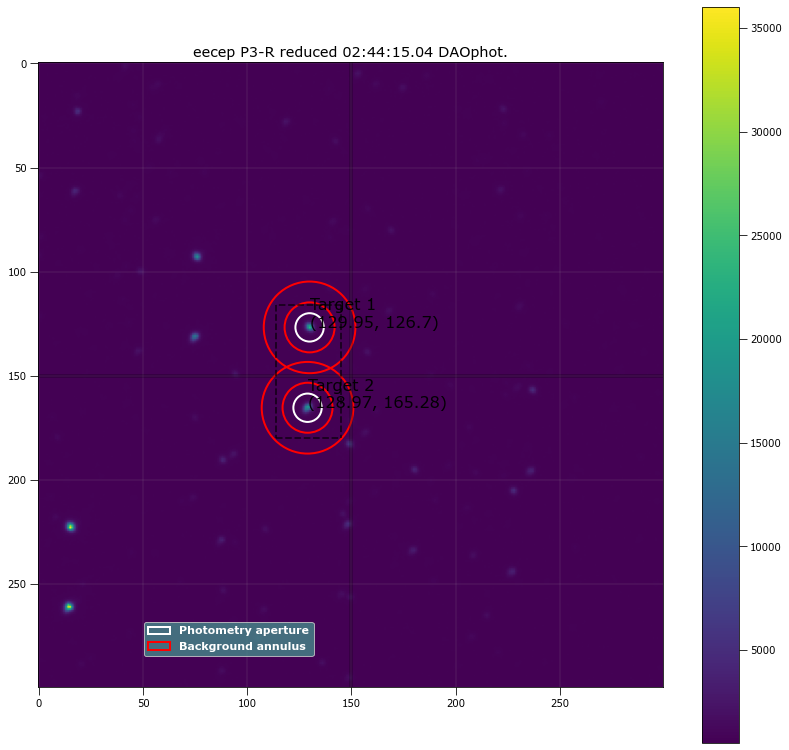

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.95317 126.69545 ...          5270.0418      697612.83           2143.702
  2 128.97055 165.27969 ...          4824.8747      692696.91          2127.9241

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.95317 126.69545 ...                  4977.953             222689.17
  2 128.97055 165.27969 ...                 4534.9358             216928.49

Write this out the excel
507 02:44:15.04 P3-R 20.0 6.80635593220339 129.95317488069907 126.69544862319844 222689.1695415721 4977.953026143124 128

In [59]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P3-R Filter")

res_apt_sum_list = []

start = 398
end = 508 #So this things sets a new filename for a new file...
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [34, 30, 36, -5]
#Fit variations
#3 to 7
#4.5 to 8
#5 to 8.5

for k in range(start, end ):
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[k]),
                                        [512, 512, 512, 512], 
                                        (m_biast, m_dark, p_3_m_flat), 
                                        False, True, False)

    trial_radii = np.linspace(5, 9.35, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:
        #Find the position
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search, 
                                                          2000, search_off, radii, 12 , 22, False, False)
        
        if (len(DAO_positions) != 2):
            x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj, 4,search_bracket, 4500 , False, False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]
    
    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions,good_radii, 12 , 22, True, False)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'], #Thats a bug bro
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]] #It writes by wrow
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close()

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])